In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
from torchvision import transforms
from PIL import Image
import os

# Считывание изображений

In [3]:
class DogImagesDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.image_paths = []
        self.labels = []
        self.breed_to_label = {}
        self.label_to_breed = {}
        self.num_classes = 0

        breeds = sorted(os.listdir(root_dir))
        for i, breed in enumerate(breeds):
            breed_path = os.path.join(root_dir, breed)
            if os.path.isdir(breed_path):
                self.breed_to_label[breed] = i
                self.label_to_breed[i] = breed
                for filename in os.listdir(breed_path):
                    if filename.endswith(('.jpg', '.jpeg', '.png')):
                        self.image_paths.append(os.path.join(breed_path, filename))
                        self.labels.append(i) # Используем числовой индекс породы

        self.num_classes = len(self.breed_to_label)
        self.transform = transform if transform is not None else transforms.ToTensor()

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert('RGB')
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

In [4]:
images_root_dir = 'Images'

# Определите преобразования изображений
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) # Нормализация в диапазон [-1, 1]
])

# Создайте экземпляр Dataset
dataset = DogImagesDataset(root_dir=images_root_dir, transform=transform)

# Создайте DataLoader
batch_size = 64
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Количество классов (пород)
num_classes = dataset.num_classes
print(f"Количество классов пород: {num_classes}")

# Пример получения батча данных
real_images, labels = next(iter(dataloader))
print(f"Размер батча изображений: {real_images.shape}")
print(f"Размер батча меток: {labels.shape}")
print(f"Пример метки: {dataset.label_to_breed[labels[0].item()]}")

Количество классов пород: 120
Размер батча изображений: torch.Size([64, 3, 64, 64])
Размер батча меток: torch.Size([64])
Пример метки: n02113023-Pembroke


In [5]:
class ConditionalDiscriminator(nn.Module):
    def __init__(self, image_channels, num_classes, embedding_dim):
        super(ConditionalDiscriminator, self).__init__()

        self.image_channels = image_channels
        self.num_classes = num_classes
        self.embedding_dim = embedding_dim

        # Эмбединг для меток классов
        self.label_embedding = nn.Embedding(num_classes, embedding_dim)

        self.model = nn.Sequential(
            # Вход: (image_channels + embedding_dim, H, W) после конкатенации
            nn.Conv2d(image_channels + embedding_dim, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            # Выход: (512, 4, 4) при размере изображения 64x64
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0),
            nn.Sigmoid() # Вероятность, что изображение реальное
        )

    def forward(self, image, labels):
        # Получаем эмбединг для меток
        label_embedding = self.label_embedding(labels)
        label_embedding = label_embedding.unsqueeze(2).unsqueeze(3)
        # Масштабируем эмбединг до размера изображения
        label_embedding = label_embedding.expand(-1, -1, image.size(2), image.size(3))

        # Конкатенируем изображение и эмбединг по каналу
        combined_input = torch.cat((image, label_embedding), dim=1)
        output = self.model(combined_input)
        return output.squeeze()

In [6]:
class ConditionalGenerator(nn.Module):
    def __init__(self, latent_dim, num_classes, embedding_dim, image_channels):
        super(ConditionalGenerator, self).__init__()

        self.latent_dim = latent_dim
        self.num_classes = num_classes
        self.embedding_dim = embedding_dim
        self.image_channels = image_channels

        # Эмбединг для меток классов
        self.label_embedding = nn.Embedding(num_classes, embedding_dim)

        self.model = nn.Sequential(
            # Вход: (latent_dim + embedding_dim, 1, 1) после конкатенации
            nn.ConvTranspose2d(latent_dim + embedding_dim, 512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            # Выход: (image_channels, 64, 64)
            nn.ConvTranspose2d(64, image_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh() # Выходные значения пикселей в диапазоне [-1, 1]
        )

    def forward(self, noise, labels):
        # Получаем эмбединг для меток
        label_embedding = self.label_embedding(labels)
        label_embedding = label_embedding.unsqueeze(2).unsqueeze(3)

        # Конкатенируем шум и эмбединг меток
        combined_input = torch.cat((noise, label_embedding), dim=1)

        # Пропускаем через генератор
        output = self.model(combined_input)
        return output

In [7]:
def train_cgan(generator, discriminator, dataloader, num_epochs, latent_dim, device, fixed_noise, fixed_labels, real_label=1., fake_label=0., generator_optimizer=None, discriminator_optimizer=None, log_interval=100):
    if generator_optimizer is None:
        generator_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    if discriminator_optimizer is None:
        discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

    criterion = nn.BCELoss()

    generator.train()
    discriminator.train()

    for epoch in range(num_epochs):
        for i, (real_images, labels) in enumerate(dataloader):
            batch_size = real_images.size(0)
            real_images = real_images.to(device)
            labels = labels.to(device)

            ############################
            # (1) Обновление дискриминатора: максимизация log(D(x|y)) + log(1 - D(G(z|y)))
            ############################
            discriminator_optimizer.zero_grad()

            # Обучение на реальных данных
            output_real = discriminator(real_images, labels)
            label_real = torch.full((batch_size,), 1., dtype=torch.float, device=device)
            loss_real = criterion(output_real, label_real)
            loss_real.backward()
            D_x = output_real.mean().item()

            # Обучение на фейковых данных
            noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
            fake_labels = torch.randint(0, generator.num_classes, (batch_size,), device=device)
            fake_images = generator(noise, fake_labels)
            label_fake = torch.full((batch_size,), 0., dtype=torch.float, device=device)
            output_fake_detached = discriminator(fake_images.detach(), fake_labels)
            loss_fake = criterion(output_fake_detached, label_fake)
            loss_fake.backward()
            D_G_z1 = output_fake_detached.mean().item()

            loss_discriminator = loss_real + loss_fake
            discriminator_optimizer.step()

            ############################
            # (2) Обновление генератора: минимизация log(1 - D(G(z|y)))
            ############################
            generator_optimizer.zero_grad()

            noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
            fake_images_generator = generator(noise, labels)
            output_fake_generator = discriminator(fake_images_generator, labels)
            loss_generator = criterion(output_fake_generator, label_real)
            loss_generator.backward()
            D_G_z2 = output_fake_generator.mean().item()

            generator_optimizer.step()

            if (i + 1) % log_interval == 0:
                print(f"Эпоха [{epoch+1}/{num_epochs}] Шаг [{i+1}/{len(dataloader)}] "
                      f"D Loss: {loss_discriminator.item():.4f}, G Loss: {loss_generator.item():.4f} "
                      f"D(x): {D_x:.4f}, D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}")

        generator.eval()
        with torch.no_grad():
            fake_samples = generator(fixed_noise, fixed_labels).detach().cpu()
            grid = make_grid(fake_samples, nrow=len(fixed_labels))
            plt.imshow(grid.permute(1, 2, 0))
            plt.title(f"Сгенерированные изображения после эпохи {epoch+1}")
            plt.axis('off')
            plt.show()
        generator.train()

    print("Обучение завершено!")

In [46]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Используемое устройство: {device}")

# --- Параметры обучения ---
latent_dim = 100
embedding_dim = 128
image_channels = 3  # Для RGB изображений
num_epochs = 400
learning_rate = 0.0002
beta1 = 0.5
beta2 = 0.999
log_interval = 100
batch_size = 64

Используемое устройство: cuda


In [48]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

dataset = DogImagesDataset(root_dir=images_root_dir, transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0) # Установите num_workers по необходимости
num_classes = dataset.num_classes
print(f"Количество классов пород: {num_classes}")

Количество классов пород: 120


In [50]:
generator = ConditionalGenerator(latent_dim, num_classes, embedding_dim, image_channels).to(device)
discriminator = ConditionalDiscriminator(image_channels, num_classes, embedding_dim).to(device)

# --- Инициализация оптимизаторов ---
generator_optimizer = optim.Adam(generator.parameters(), lr=learning_rate, betas=(beta1, beta2))
discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(beta1, beta2))

# --- Функция потерь ---
criterion = nn.BCELoss()

num_fixed_samples = 16
fixed_noise = torch.randn(num_fixed_samples, latent_dim, 1, 1, device=device)
fixed_labels = torch.randint(0, num_classes, (num_fixed_samples,), device=device)

In [44]:
device

device(type='cuda')

Эпоха [1/400] Шаг [100/322] D Loss: 1.5869, G Loss: 0.7959 D(x): 0.4631, D(G(z)): 0.5534 / 0.4525
Эпоха [1/400] Шаг [200/322] D Loss: 1.3965, G Loss: 0.6481 D(x): 0.4868, D(G(z)): 0.4897 / 0.5239
Эпоха [1/400] Шаг [300/322] D Loss: 1.4755, G Loss: 0.8328 D(x): 0.5081, D(G(z)): 0.5462 / 0.4373


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9995585..0.9997629].


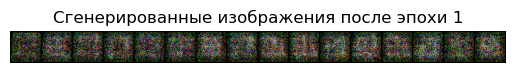

Эпоха [2/400] Шаг [100/322] D Loss: 1.3083, G Loss: 0.5274 D(x): 0.4735, D(G(z)): 0.4200 / 0.5931
Эпоха [2/400] Шаг [200/322] D Loss: 1.3460, G Loss: 0.6595 D(x): 0.4933, D(G(z)): 0.4710 / 0.5176
Эпоха [2/400] Шаг [300/322] D Loss: 1.2916, G Loss: 0.5768 D(x): 0.4982, D(G(z)): 0.4458 / 0.5633


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9998639..0.9999322].


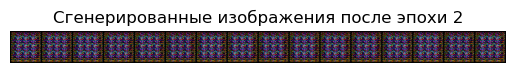

Эпоха [3/400] Шаг [100/322] D Loss: 1.6880, G Loss: 0.8275 D(x): 0.4659, D(G(z)): 0.6013 / 0.4386
Эпоха [3/400] Шаг [200/322] D Loss: 1.6863, G Loss: 0.7407 D(x): 0.4143, D(G(z)): 0.5508 / 0.4779
Эпоха [3/400] Шаг [300/322] D Loss: 1.9483, G Loss: 0.5661 D(x): 0.5860, D(G(z)): 0.7533 / 0.5702


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99998784..0.9999821].


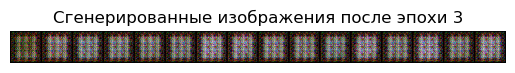

Эпоха [4/400] Шаг [100/322] D Loss: 1.0123, G Loss: 0.4339 D(x): 0.6383, D(G(z)): 0.4288 / 0.6490
Эпоха [4/400] Шаг [200/322] D Loss: 1.8525, G Loss: 0.9621 D(x): 0.2684, D(G(z)): 0.4094 / 0.3830
Эпоха [4/400] Шаг [300/322] D Loss: 2.3283, G Loss: 0.8262 D(x): 0.2856, D(G(z)): 0.6481 / 0.4395


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999978..0.99998397].


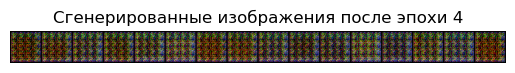

Эпоха [5/400] Шаг [100/322] D Loss: 1.7384, G Loss: 0.5518 D(x): 0.2302, D(G(z)): 0.2254 / 0.5787
Эпоха [5/400] Шаг [200/322] D Loss: 0.8180, G Loss: 0.3587 D(x): 0.7404, D(G(z)): 0.4025 / 0.6991
Эпоха [5/400] Шаг [300/322] D Loss: 2.5935, G Loss: 1.0474 D(x): 0.1474, D(G(z)): 0.4850 / 0.3529


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999604..0.9999996].


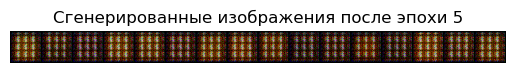

Эпоха [6/400] Шаг [100/322] D Loss: 1.0600, G Loss: 0.3759 D(x): 0.6596, D(G(z)): 0.4722 / 0.6872
Эпоха [6/400] Шаг [200/322] D Loss: 1.2243, G Loss: 0.5118 D(x): 0.4750, D(G(z)): 0.3758 / 0.6006
Эпоха [6/400] Шаг [300/322] D Loss: 1.3677, G Loss: 0.6369 D(x): 0.4649, D(G(z)): 0.4509 / 0.5294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999726..0.99999994].


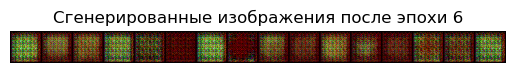

Эпоха [7/400] Шаг [100/322] D Loss: 1.3983, G Loss: 0.4951 D(x): 0.6098, D(G(z)): 0.5933 / 0.6104
Эпоха [7/400] Шаг [200/322] D Loss: 0.7441, G Loss: 0.3954 D(x): 0.6045, D(G(z)): 0.2116 / 0.6743
Эпоха [7/400] Шаг [300/322] D Loss: 1.2936, G Loss: 0.5878 D(x): 0.5328, D(G(z)): 0.4808 / 0.5562


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


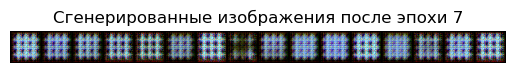

Эпоха [8/400] Шаг [100/322] D Loss: 1.4618, G Loss: 0.7381 D(x): 0.3019, D(G(z)): 0.2205 / 0.4813
Эпоха [8/400] Шаг [200/322] D Loss: 1.5150, G Loss: 0.7351 D(x): 0.5067, D(G(z)): 0.5620 / 0.4810
Эпоха [8/400] Шаг [300/322] D Loss: 0.9047, G Loss: 0.3396 D(x): 0.5188, D(G(z)): 0.2174 / 0.7127


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999999..0.99999815].


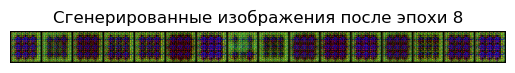

Эпоха [9/400] Шаг [100/322] D Loss: 0.6824, G Loss: 0.1077 D(x): 0.9197, D(G(z)): 0.4491 / 0.8981
Эпоха [9/400] Шаг [200/322] D Loss: 2.2381, G Loss: 1.2986 D(x): 0.1979, D(G(z)): 0.4397 / 0.2753
Эпоха [9/400] Шаг [300/322] D Loss: 1.4539, G Loss: 0.6933 D(x): 0.3949, D(G(z)): 0.4054 / 0.5012


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999505..0.99999994].


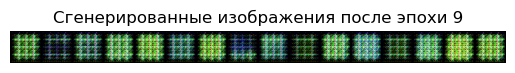

Эпоха [10/400] Шаг [100/322] D Loss: 0.8293, G Loss: 0.2870 D(x): 0.7792, D(G(z)): 0.4389 / 0.7513
Эпоха [10/400] Шаг [200/322] D Loss: 1.5975, G Loss: 0.6724 D(x): 0.5855, D(G(z)): 0.6526 / 0.5115
Эпоха [10/400] Шаг [300/322] D Loss: 1.1861, G Loss: 0.4867 D(x): 0.6290, D(G(z)): 0.5121 / 0.6153


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


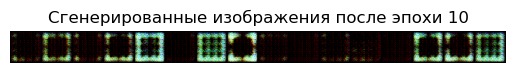

Эпоха [11/400] Шаг [100/322] D Loss: 1.9668, G Loss: 0.7484 D(x): 0.4666, D(G(z)): 0.6976 / 0.4742
Эпоха [11/400] Шаг [200/322] D Loss: 1.1009, G Loss: 0.4434 D(x): 0.6824, D(G(z)): 0.5122 / 0.6421
Эпоха [11/400] Шаг [300/322] D Loss: 1.7653, G Loss: 0.8825 D(x): 0.3183, D(G(z)): 0.4549 / 0.4189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999964].


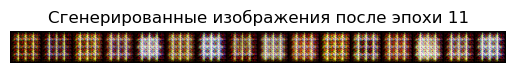

Эпоха [12/400] Шаг [100/322] D Loss: 1.8339, G Loss: 0.9277 D(x): 0.4018, D(G(z)): 0.6011 / 0.3961
Эпоха [12/400] Шаг [200/322] D Loss: 1.5937, G Loss: 0.5805 D(x): 0.5475, D(G(z)): 0.6269 / 0.5605
Эпоха [12/400] Шаг [300/322] D Loss: 1.5694, G Loss: 0.8735 D(x): 0.4435, D(G(z)): 0.5250 / 0.4186


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99972534..1.0].


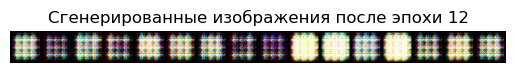

Эпоха [13/400] Шаг [100/322] D Loss: 1.6003, G Loss: 0.9153 D(x): 0.3257, D(G(z)): 0.3746 / 0.4023
Эпоха [13/400] Шаг [200/322] D Loss: 0.3139, G Loss: 0.1674 D(x): 0.8083, D(G(z)): 0.0950 / 0.8465
Эпоха [13/400] Шаг [300/322] D Loss: 0.8243, G Loss: 0.4400 D(x): 0.6425, D(G(z)): 0.3158 / 0.6453


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99998486].


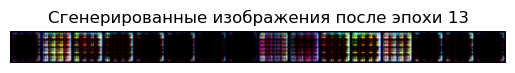

Эпоха [14/400] Шаг [100/322] D Loss: 1.0696, G Loss: 0.2947 D(x): 0.7325, D(G(z)): 0.5275 / 0.7452
Эпоха [14/400] Шаг [200/322] D Loss: 1.6199, G Loss: 0.9320 D(x): 0.3362, D(G(z)): 0.4056 / 0.3945
Эпоха [14/400] Шаг [300/322] D Loss: 0.8223, G Loss: 0.4610 D(x): 0.5872, D(G(z)): 0.2486 / 0.6319


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999999].


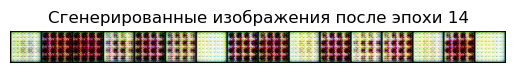

Эпоха [15/400] Шаг [100/322] D Loss: 2.3058, G Loss: 1.2806 D(x): 0.2495, D(G(z)): 0.5957 / 0.2801
Эпоха [15/400] Шаг [200/322] D Loss: 1.7960, G Loss: 1.0613 D(x): 0.2651, D(G(z)): 0.3685 / 0.3470
Эпоха [15/400] Шаг [300/322] D Loss: 1.4936, G Loss: 0.6691 D(x): 0.5538, D(G(z)): 0.5926 / 0.5132


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


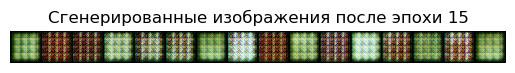

Эпоха [16/400] Шаг [100/322] D Loss: 1.2470, G Loss: 0.5016 D(x): 0.6324, D(G(z)): 0.5440 / 0.6063
Эпоха [16/400] Шаг [200/322] D Loss: 1.4712, G Loss: 0.5414 D(x): 0.6247, D(G(z)): 0.6308 / 0.5824
Эпоха [16/400] Шаг [300/322] D Loss: 1.2869, G Loss: 0.3113 D(x): 0.7900, D(G(z)): 0.6483 / 0.7328


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999985].


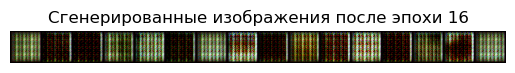

Эпоха [17/400] Шаг [100/322] D Loss: 0.4550, G Loss: 0.1162 D(x): 0.8943, D(G(z)): 0.2896 / 0.8904
Эпоха [17/400] Шаг [200/322] D Loss: 0.7560, G Loss: 0.3992 D(x): 0.5993, D(G(z)): 0.2147 / 0.6719
Эпоха [17/400] Шаг [300/322] D Loss: 1.0202, G Loss: 0.6544 D(x): 0.4688, D(G(z)): 0.2293 / 0.5210


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


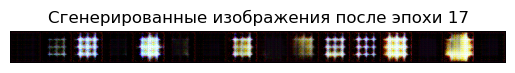

Эпоха [18/400] Шаг [100/322] D Loss: 1.2517, G Loss: 0.7988 D(x): 0.3917, D(G(z)): 0.2668 / 0.4504
Эпоха [18/400] Шаг [200/322] D Loss: 0.8503, G Loss: 0.2697 D(x): 0.7765, D(G(z)): 0.4480 / 0.7639
Эпоха [18/400] Шаг [300/322] D Loss: 1.3784, G Loss: 0.4540 D(x): 0.6805, D(G(z)): 0.6288 / 0.6360


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


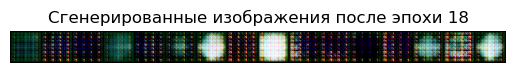

Эпоха [19/400] Шаг [100/322] D Loss: 1.3950, G Loss: 0.5558 D(x): 0.6448, D(G(z)): 0.6138 / 0.5746
Эпоха [19/400] Шаг [200/322] D Loss: 1.3016, G Loss: 0.9491 D(x): 0.3359, D(G(z)): 0.1828 / 0.3880
Эпоха [19/400] Шаг [300/322] D Loss: 1.1352, G Loss: 0.4279 D(x): 0.6116, D(G(z)): 0.4706 / 0.6541


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


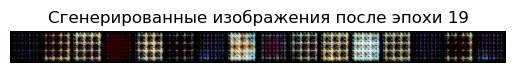

Эпоха [20/400] Шаг [100/322] D Loss: 0.6631, G Loss: 0.3546 D(x): 0.6568, D(G(z)): 0.2137 / 0.7025
Эпоха [20/400] Шаг [200/322] D Loss: 0.8127, G Loss: 0.2616 D(x): 0.7562, D(G(z)): 0.4105 / 0.7707
Эпоха [20/400] Шаг [300/322] D Loss: 2.2888, G Loss: 1.2945 D(x): 0.2051, D(G(z)): 0.4988 / 0.2757


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


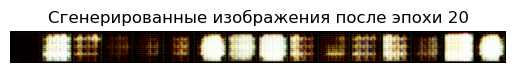

Эпоха [21/400] Шаг [100/322] D Loss: 1.3119, G Loss: 0.3401 D(x): 0.7913, D(G(z)): 0.6583 / 0.7127
Эпоха [21/400] Шаг [200/322] D Loss: 1.3014, G Loss: 0.5230 D(x): 0.5526, D(G(z)): 0.5029 / 0.5947
Эпоха [21/400] Шаг [300/322] D Loss: 0.7078, G Loss: 0.3637 D(x): 0.6718, D(G(z)): 0.2659 / 0.6954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


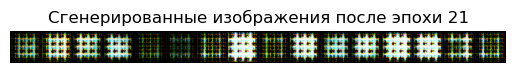

Эпоха [22/400] Шаг [100/322] D Loss: 1.6252, G Loss: 0.6916 D(x): 0.5180, D(G(z)): 0.6184 / 0.5018
Эпоха [22/400] Шаг [200/322] D Loss: 1.0156, G Loss: 0.3150 D(x): 0.7747, D(G(z)): 0.5314 / 0.7305
Эпоха [22/400] Шаг [300/322] D Loss: 0.6750, G Loss: 0.2494 D(x): 0.7677, D(G(z)): 0.3362 / 0.7796


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


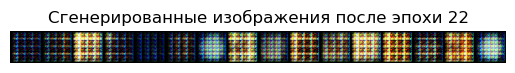

Эпоха [23/400] Шаг [100/322] D Loss: 1.3330, G Loss: 0.8974 D(x): 0.2995, D(G(z)): 0.1164 / 0.4092
Эпоха [23/400] Шаг [200/322] D Loss: 1.9880, G Loss: 1.0419 D(x): 0.3175, D(G(z)): 0.5628 / 0.3539
Эпоха [23/400] Шаг [300/322] D Loss: 1.7848, G Loss: 0.8506 D(x): 0.3761, D(G(z)): 0.5483 / 0.4287


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


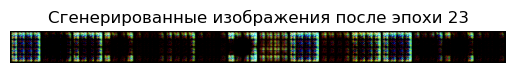

Эпоха [24/400] Шаг [100/322] D Loss: 0.8424, G Loss: 0.2850 D(x): 0.7544, D(G(z)): 0.4271 / 0.7524
Эпоха [24/400] Шаг [200/322] D Loss: 2.6821, G Loss: 0.1214 D(x): 0.9563, D(G(z)): 0.9265 / 0.8863
Эпоха [24/400] Шаг [300/322] D Loss: 2.0398, G Loss: 0.4827 D(x): 0.7310, D(G(z)): 0.8198 / 0.6189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


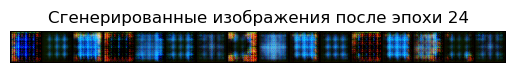

Эпоха [25/400] Шаг [100/322] D Loss: 2.1006, G Loss: 0.6541 D(x): 0.6119, D(G(z)): 0.7958 / 0.5233
Эпоха [25/400] Шаг [200/322] D Loss: 2.1350, G Loss: 0.6822 D(x): 0.5499, D(G(z)): 0.7828 / 0.5077
Эпоха [25/400] Шаг [300/322] D Loss: 0.7117, G Loss: 0.0891 D(x): 0.9236, D(G(z)): 0.4670 / 0.9149


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


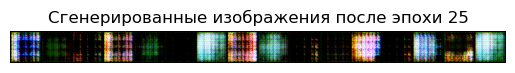

Эпоха [26/400] Шаг [100/322] D Loss: 1.5743, G Loss: 0.3858 D(x): 0.6942, D(G(z)): 0.6991 / 0.6834
Эпоха [26/400] Шаг [200/322] D Loss: 1.7299, G Loss: 0.2636 D(x): 0.8502, D(G(z)): 0.7903 / 0.7690
Эпоха [26/400] Шаг [300/322] D Loss: 1.1836, G Loss: 0.8448 D(x): 0.4269, D(G(z)): 0.2708 / 0.4307


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


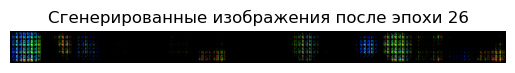

Эпоха [27/400] Шаг [100/322] D Loss: 2.6291, G Loss: 0.7377 D(x): 0.5027, D(G(z)): 0.8543 / 0.4802
Эпоха [27/400] Шаг [200/322] D Loss: 1.3356, G Loss: 0.5343 D(x): 0.6383, D(G(z)): 0.5852 / 0.5869
Эпоха [27/400] Шаг [300/322] D Loss: 0.9399, G Loss: 0.4600 D(x): 0.6637, D(G(z)): 0.4098 / 0.6320


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


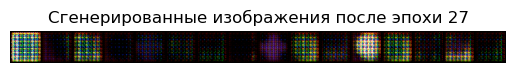

Эпоха [28/400] Шаг [100/322] D Loss: 1.4307, G Loss: 0.9105 D(x): 0.3278, D(G(z)): 0.2580 / 0.4050
Эпоха [28/400] Шаг [200/322] D Loss: 2.8744, G Loss: 2.0200 D(x): 0.0812, D(G(z)): 0.2938 / 0.1338
Эпоха [28/400] Шаг [300/322] D Loss: 0.6818, G Loss: 0.2572 D(x): 0.7186, D(G(z)): 0.2935 / 0.7735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


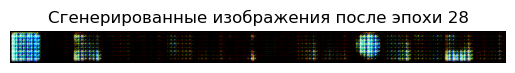

Эпоха [29/400] Шаг [100/322] D Loss: 0.9161, G Loss: 0.3251 D(x): 0.6969, D(G(z)): 0.4228 / 0.7229
Эпоха [29/400] Шаг [200/322] D Loss: 1.5650, G Loss: 0.9133 D(x): 0.3591, D(G(z)): 0.4144 / 0.4023
Эпоха [29/400] Шаг [300/322] D Loss: 1.4380, G Loss: 0.4972 D(x): 0.6491, D(G(z)): 0.6332 / 0.6088


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


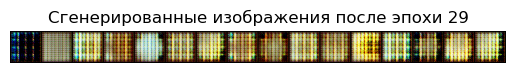

Эпоха [30/400] Шаг [100/322] D Loss: 1.6872, G Loss: 0.3770 D(x): 0.7201, D(G(z)): 0.7399 / 0.6868
Эпоха [30/400] Шаг [200/322] D Loss: 0.5204, G Loss: 0.1669 D(x): 0.8535, D(G(z)): 0.3030 / 0.8464
Эпоха [30/400] Шаг [300/322] D Loss: 1.1232, G Loss: 0.6021 D(x): 0.5892, D(G(z)): 0.4463 / 0.5482


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


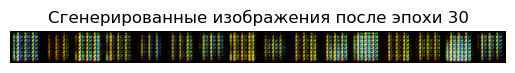

Эпоха [31/400] Шаг [100/322] D Loss: 0.4026, G Loss: 0.1460 D(x): 0.8584, D(G(z)): 0.2206 / 0.8643
Эпоха [31/400] Шаг [200/322] D Loss: 1.5025, G Loss: 0.6983 D(x): 0.4822, D(G(z)): 0.5340 / 0.4985
Эпоха [31/400] Шаг [300/322] D Loss: 0.7018, G Loss: 0.5248 D(x): 0.5915, D(G(z)): 0.1581 / 0.5922


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


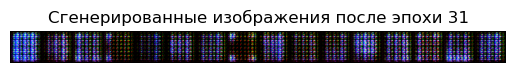

Эпоха [32/400] Шаг [100/322] D Loss: 1.8027, G Loss: 0.9345 D(x): 0.3822, D(G(z)): 0.5664 / 0.3931
Эпоха [32/400] Шаг [200/322] D Loss: 1.3952, G Loss: 0.4946 D(x): 0.6310, D(G(z)): 0.6058 / 0.6104
Эпоха [32/400] Шаг [300/322] D Loss: 0.7294, G Loss: 0.4276 D(x): 0.6115, D(G(z)): 0.2100 / 0.6526


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999998].


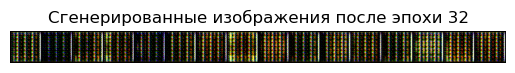

Эпоха [33/400] Шаг [100/322] D Loss: 1.1463, G Loss: 0.0902 D(x): 0.9327, D(G(z)): 0.6574 / 0.9140
Эпоха [33/400] Шаг [200/322] D Loss: 0.7003, G Loss: 0.3728 D(x): 0.6949, D(G(z)): 0.2844 / 0.6896
Эпоха [33/400] Шаг [300/322] D Loss: 1.7144, G Loss: 1.1208 D(x): 0.2944, D(G(z)): 0.3866 / 0.3271


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999997..1.0].


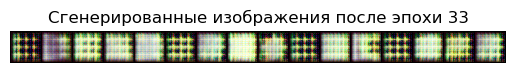

Эпоха [34/400] Шаг [100/322] D Loss: 2.1129, G Loss: 0.2011 D(x): 0.8973, D(G(z)): 0.8640 / 0.8183
Эпоха [34/400] Шаг [200/322] D Loss: 1.7117, G Loss: 1.2675 D(x): 0.2294, D(G(z)): 0.2075 / 0.2826
Эпоха [34/400] Шаг [300/322] D Loss: 1.1442, G Loss: 0.3670 D(x): 0.7341, D(G(z)): 0.5645 / 0.6936


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999974].


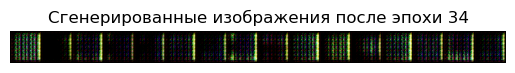

Эпоха [35/400] Шаг [100/322] D Loss: 0.6852, G Loss: 0.1955 D(x): 0.8543, D(G(z)): 0.4087 / 0.8227
Эпоха [35/400] Шаг [200/322] D Loss: 1.1708, G Loss: 0.7568 D(x): 0.3466, D(G(z)): 0.0989 / 0.4713
Эпоха [35/400] Шаг [300/322] D Loss: 0.2518, G Loss: 0.1080 D(x): 0.8923, D(G(z)): 0.1284 / 0.8977


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


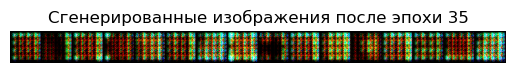

Эпоха [36/400] Шаг [100/322] D Loss: 2.5234, G Loss: 1.4567 D(x): 0.2066, D(G(z)): 0.6081 / 0.2339
Эпоха [36/400] Шаг [200/322] D Loss: 2.0111, G Loss: 1.2456 D(x): 0.2187, D(G(z)): 0.3808 / 0.2901
Эпоха [36/400] Шаг [300/322] D Loss: 0.2620, G Loss: 0.1219 D(x): 0.9005, D(G(z)): 0.1453 / 0.8854


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.999999].


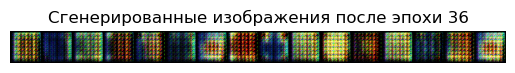

Эпоха [37/400] Шаг [100/322] D Loss: 1.1498, G Loss: 0.1986 D(x): 0.8479, D(G(z)): 0.6245 / 0.8208
Эпоха [37/400] Шаг [200/322] D Loss: 0.3636, G Loss: 0.1788 D(x): 0.8356, D(G(z)): 0.1674 / 0.8368
Эпоха [37/400] Шаг [300/322] D Loss: 3.7708, G Loss: 1.7150 D(x): 0.1872, D(G(z)): 0.8744 / 0.1824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999999].


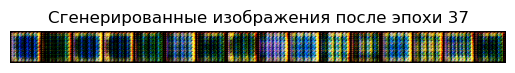

Эпоха [38/400] Шаг [100/322] D Loss: 0.6711, G Loss: 0.2981 D(x): 0.7641, D(G(z)): 0.3305 / 0.7424
Эпоха [38/400] Шаг [200/322] D Loss: 1.0219, G Loss: 0.6142 D(x): 0.5318, D(G(z)): 0.3204 / 0.5418
Эпоха [38/400] Шаг [300/322] D Loss: 1.1185, G Loss: 0.7118 D(x): 0.4911, D(G(z)): 0.3315 / 0.4919


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


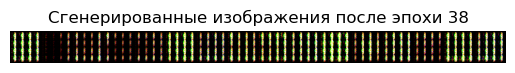

Эпоха [39/400] Шаг [100/322] D Loss: 1.2404, G Loss: 0.6988 D(x): 0.4936, D(G(z)): 0.4119 / 0.4979
Эпоха [39/400] Шаг [200/322] D Loss: 1.4234, G Loss: 0.9006 D(x): 0.3862, D(G(z)): 0.3748 / 0.4071
Эпоха [39/400] Шаг [300/322] D Loss: 1.3430, G Loss: 0.5098 D(x): 0.5946, D(G(z)): 0.5588 / 0.6014


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


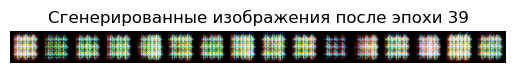

Эпоха [40/400] Шаг [100/322] D Loss: 1.3568, G Loss: 0.8319 D(x): 0.3801, D(G(z)): 0.3195 / 0.4359
Эпоха [40/400] Шаг [200/322] D Loss: 0.4491, G Loss: 0.1119 D(x): 0.9070, D(G(z)): 0.2957 / 0.8942
Эпоха [40/400] Шаг [300/322] D Loss: 1.5617, G Loss: 0.3811 D(x): 0.7492, D(G(z)): 0.7172 / 0.6848


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


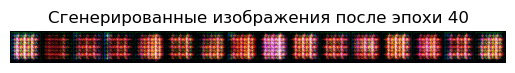

Эпоха [41/400] Шаг [100/322] D Loss: 1.4112, G Loss: 0.6879 D(x): 0.4885, D(G(z)): 0.4989 / 0.5031
Эпоха [41/400] Шаг [200/322] D Loss: 0.8696, G Loss: 0.5384 D(x): 0.5739, D(G(z)): 0.2673 / 0.5843
Эпоха [41/400] Шаг [300/322] D Loss: 0.9763, G Loss: 0.3824 D(x): 0.7218, D(G(z)): 0.4768 / 0.6830


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


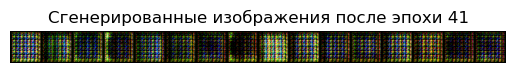

Эпоха [42/400] Шаг [100/322] D Loss: 0.6654, G Loss: 0.2650 D(x): 0.7554, D(G(z)): 0.3187 / 0.7679
Эпоха [42/400] Шаг [200/322] D Loss: 0.5179, G Loss: 0.3098 D(x): 0.7044, D(G(z)): 0.1536 / 0.7339
Эпоха [42/400] Шаг [300/322] D Loss: 0.4892, G Loss: 0.1042 D(x): 0.9031, D(G(z)): 0.3206 / 0.9013


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


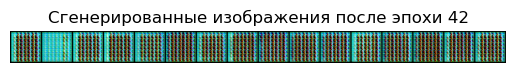

Эпоха [43/400] Шаг [100/322] D Loss: 0.7001, G Loss: 0.3698 D(x): 0.6723, D(G(z)): 0.2609 / 0.6910
Эпоха [43/400] Шаг [200/322] D Loss: 1.1261, G Loss: 0.2742 D(x): 0.7723, D(G(z)): 0.5771 / 0.7606
Эпоха [43/400] Шаг [300/322] D Loss: 0.4047, G Loss: 0.2803 D(x): 0.7262, D(G(z)): 0.0804 / 0.7559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


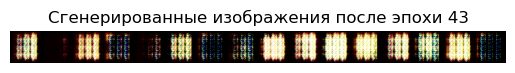

Эпоха [44/400] Шаг [100/322] D Loss: 1.3905, G Loss: 1.0035 D(x): 0.3186, D(G(z)): 0.2085 / 0.3696
Эпоха [44/400] Шаг [200/322] D Loss: 1.5624, G Loss: 0.1946 D(x): 0.9008, D(G(z)): 0.7659 / 0.8261
Эпоха [44/400] Шаг [300/322] D Loss: 0.9348, G Loss: 0.3511 D(x): 0.7013, D(G(z)): 0.4377 / 0.7046


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


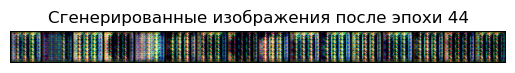

Эпоха [45/400] Шаг [100/322] D Loss: 0.6174, G Loss: 0.2083 D(x): 0.8219, D(G(z)): 0.3432 / 0.8122
Эпоха [45/400] Шаг [200/322] D Loss: 2.0200, G Loss: 1.1671 D(x): 0.2851, D(G(z)): 0.5329 / 0.3121
Эпоха [45/400] Шаг [300/322] D Loss: 1.5635, G Loss: 0.6449 D(x): 0.5047, D(G(z)): 0.5834 / 0.5252


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


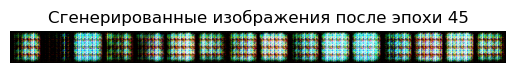

Эпоха [46/400] Шаг [100/322] D Loss: 1.1421, G Loss: 0.8806 D(x): 0.3572, D(G(z)): 0.1048 / 0.4165
Эпоха [46/400] Шаг [200/322] D Loss: 1.1498, G Loss: 0.4257 D(x): 0.6557, D(G(z)): 0.5162 / 0.6537
Эпоха [46/400] Шаг [300/322] D Loss: 0.6958, G Loss: 0.2672 D(x): 0.7885, D(G(z)): 0.3662 / 0.7657


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999999..1.0].


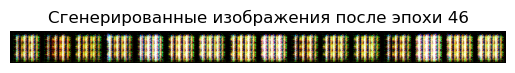

Эпоха [47/400] Шаг [100/322] D Loss: 1.4488, G Loss: 0.9313 D(x): 0.3143, D(G(z)): 0.2473 / 0.3952
Эпоха [47/400] Шаг [200/322] D Loss: 1.1322, G Loss: 0.3544 D(x): 0.7367, D(G(z)): 0.5617 / 0.7022
Эпоха [47/400] Шаг [300/322] D Loss: 1.1691, G Loss: 0.5180 D(x): 0.6069, D(G(z)): 0.4862 / 0.5966


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


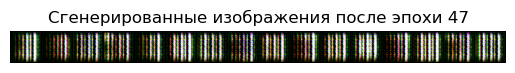

Эпоха [48/400] Шаг [100/322] D Loss: 1.5285, G Loss: 0.7106 D(x): 0.4921, D(G(z)): 0.5574 / 0.4920
Эпоха [48/400] Шаг [200/322] D Loss: 1.3251, G Loss: 0.9243 D(x): 0.3150, D(G(z)): 0.1520 / 0.3992
Эпоха [48/400] Шаг [300/322] D Loss: 0.5573, G Loss: 0.1417 D(x): 0.8696, D(G(z)): 0.3407 / 0.8681


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


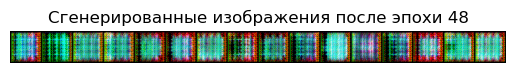

Эпоха [49/400] Шаг [100/322] D Loss: 1.6150, G Loss: 0.6103 D(x): 0.5692, D(G(z)): 0.6493 / 0.5445
Эпоха [49/400] Шаг [200/322] D Loss: 1.2674, G Loss: 0.5215 D(x): 0.6440, D(G(z)): 0.5586 / 0.5955
Эпоха [49/400] Шаг [300/322] D Loss: 0.4451, G Loss: 0.1871 D(x): 0.8202, D(G(z)): 0.2179 / 0.8296


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


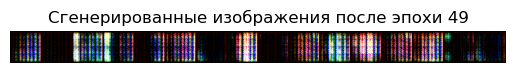

Эпоха [50/400] Шаг [100/322] D Loss: 0.8753, G Loss: 0.4185 D(x): 0.6550, D(G(z)): 0.3632 / 0.6583
Эпоха [50/400] Шаг [200/322] D Loss: 1.0535, G Loss: 0.7552 D(x): 0.3781, D(G(z)): 0.0752 / 0.4726
Эпоха [50/400] Шаг [300/322] D Loss: 1.4065, G Loss: 0.7232 D(x): 0.4605, D(G(z)): 0.4632 / 0.4858


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999998..1.0].


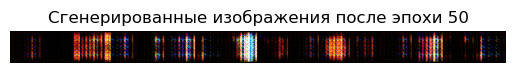

Эпоха [51/400] Шаг [100/322] D Loss: 0.6106, G Loss: 0.1734 D(x): 0.8304, D(G(z)): 0.3441 / 0.8411
Эпоха [51/400] Шаг [200/322] D Loss: 1.1677, G Loss: 0.6451 D(x): 0.4956, D(G(z)): 0.3707 / 0.5251
Эпоха [51/400] Шаг [300/322] D Loss: 0.4205, G Loss: 0.2872 D(x): 0.7469, D(G(z)): 0.1204 / 0.7506


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


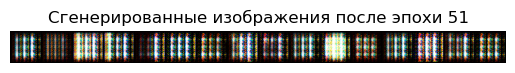

Эпоха [52/400] Шаг [100/322] D Loss: 1.1471, G Loss: 0.7492 D(x): 0.3906, D(G(z)): 0.1829 / 0.4745
Эпоха [52/400] Шаг [200/322] D Loss: 0.6717, G Loss: 0.4519 D(x): 0.6247, D(G(z)): 0.1815 / 0.6367
Эпоха [52/400] Шаг [300/322] D Loss: 1.3147, G Loss: 0.4442 D(x): 0.6482, D(G(z)): 0.5846 / 0.6415


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


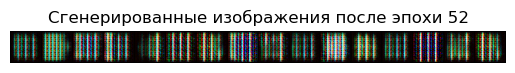

Эпоха [53/400] Шаг [100/322] D Loss: 1.0663, G Loss: 0.3705 D(x): 0.6976, D(G(z)): 0.5057 / 0.6907
Эпоха [53/400] Шаг [200/322] D Loss: 1.3732, G Loss: 0.4924 D(x): 0.6449, D(G(z)): 0.6060 / 0.6114
Эпоха [53/400] Шаг [300/322] D Loss: 0.3769, G Loss: 0.2181 D(x): 0.8099, D(G(z)): 0.1523 / 0.8043


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


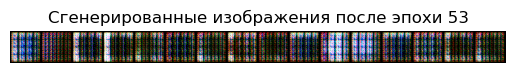

Эпоха [54/400] Шаг [100/322] D Loss: 2.1045, G Loss: 1.3839 D(x): 0.2091, D(G(z)): 0.4141 / 0.2518
Эпоха [54/400] Шаг [200/322] D Loss: 1.1683, G Loss: 0.2730 D(x): 0.7708, D(G(z)): 0.5915 / 0.7613
Эпоха [54/400] Шаг [300/322] D Loss: 2.0137, G Loss: 1.0362 D(x): 0.3383, D(G(z)): 0.6029 / 0.3555


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


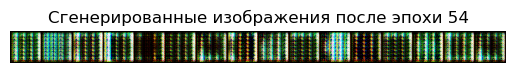

Эпоха [55/400] Шаг [100/322] D Loss: 0.8944, G Loss: 0.1523 D(x): 0.8748, D(G(z)): 0.5318 / 0.8590
Эпоха [55/400] Шаг [200/322] D Loss: 1.0992, G Loss: 0.6101 D(x): 0.5366, D(G(z)): 0.3771 / 0.5436
Эпоха [55/400] Шаг [300/322] D Loss: 2.0283, G Loss: 1.4043 D(x): 0.2043, D(G(z)): 0.3544 / 0.2466


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..1.0].


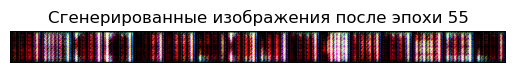

Эпоха [56/400] Шаг [100/322] D Loss: 1.7984, G Loss: 1.2166 D(x): 0.2564, D(G(z)): 0.3505 / 0.2970
Эпоха [56/400] Шаг [200/322] D Loss: 0.6277, G Loss: 0.4947 D(x): 0.6305, D(G(z)): 0.1483 / 0.6108
Эпоха [56/400] Шаг [300/322] D Loss: 1.1651, G Loss: 0.3669 D(x): 0.6816, D(G(z)): 0.5414 / 0.6933


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


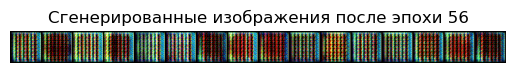

Эпоха [57/400] Шаг [100/322] D Loss: 1.8669, G Loss: 0.7586 D(x): 0.4955, D(G(z)): 0.6848 / 0.4691
Эпоха [57/400] Шаг [200/322] D Loss: 0.6919, G Loss: 0.3329 D(x): 0.7039, D(G(z)): 0.2877 / 0.7172
Эпоха [57/400] Шаг [300/322] D Loss: 1.6371, G Loss: 0.9868 D(x): 0.2932, D(G(z)): 0.3345 / 0.3734


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


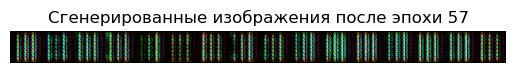

Эпоха [58/400] Шаг [100/322] D Loss: 2.7713, G Loss: 1.3033 D(x): 0.2528, D(G(z)): 0.7413 / 0.2730
Эпоха [58/400] Шаг [200/322] D Loss: 1.1572, G Loss: 0.7829 D(x): 0.4005, D(G(z)): 0.2120 / 0.4591
Эпоха [58/400] Шаг [300/322] D Loss: 1.2465, G Loss: 0.7775 D(x): 0.4659, D(G(z)): 0.3812 / 0.4602


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


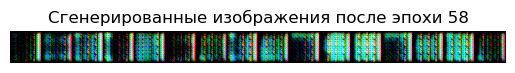

Эпоха [59/400] Шаг [100/322] D Loss: 1.1087, G Loss: 0.4573 D(x): 0.6577, D(G(z)): 0.4976 / 0.6333
Эпоха [59/400] Шаг [200/322] D Loss: 0.8205, G Loss: 0.5760 D(x): 0.5127, D(G(z)): 0.1397 / 0.5628
Эпоха [59/400] Шаг [300/322] D Loss: 0.2830, G Loss: 0.1551 D(x): 0.8449, D(G(z)): 0.1076 / 0.8568


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


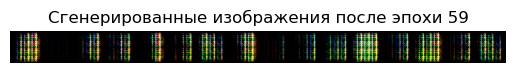

Эпоха [60/400] Шаг [100/322] D Loss: 1.1712, G Loss: 0.5638 D(x): 0.5849, D(G(z)): 0.4688 / 0.5708
Эпоха [60/400] Шаг [200/322] D Loss: 0.9788, G Loss: 0.3128 D(x): 0.7590, D(G(z)): 0.5040 / 0.7316
Эпоха [60/400] Шаг [300/322] D Loss: 0.6848, G Loss: 0.3493 D(x): 0.7038, D(G(z)): 0.2826 / 0.7054


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


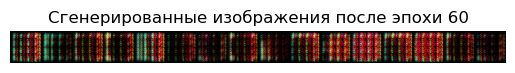

Эпоха [61/400] Шаг [100/322] D Loss: 1.4666, G Loss: 0.8585 D(x): 0.4303, D(G(z)): 0.4616 / 0.4244
Эпоха [61/400] Шаг [200/322] D Loss: 0.7858, G Loss: 0.3089 D(x): 0.7073, D(G(z)): 0.3529 / 0.7348
Эпоха [61/400] Шаг [300/322] D Loss: 2.2930, G Loss: 1.4138 D(x): 0.1987, D(G(z)): 0.4883 / 0.2443


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


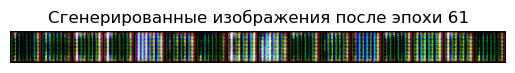

Эпоха [62/400] Шаг [100/322] D Loss: 0.8459, G Loss: 0.2516 D(x): 0.7941, D(G(z)): 0.4589 / 0.7777
Эпоха [62/400] Шаг [200/322] D Loss: 0.3982, G Loss: 0.2677 D(x): 0.7493, D(G(z)): 0.1023 / 0.7661
Эпоха [62/400] Шаг [300/322] D Loss: 0.8991, G Loss: 0.6487 D(x): 0.4775, D(G(z)): 0.1459 / 0.5233


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


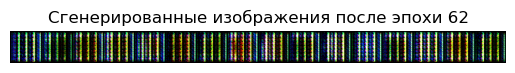

Эпоха [63/400] Шаг [100/322] D Loss: 0.8660, G Loss: 0.2126 D(x): 0.8214, D(G(z)): 0.4871 / 0.8090
Эпоха [63/400] Шаг [200/322] D Loss: 3.2263, G Loss: 1.8489 D(x): 0.1498, D(G(z)): 0.7327 / 0.1593
Эпоха [63/400] Шаг [300/322] D Loss: 1.0295, G Loss: 0.4750 D(x): 0.6246, D(G(z)): 0.4273 / 0.6222


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999999].


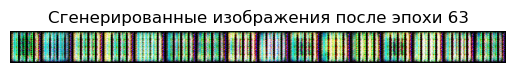

Эпоха [64/400] Шаг [100/322] D Loss: 1.5423, G Loss: 0.7379 D(x): 0.4675, D(G(z)): 0.5385 / 0.4787
Эпоха [64/400] Шаг [200/322] D Loss: 0.9124, G Loss: 0.6356 D(x): 0.4604, D(G(z)): 0.1262 / 0.5322
Эпоха [64/400] Шаг [300/322] D Loss: 0.9201, G Loss: 0.2962 D(x): 0.7579, D(G(z)): 0.4738 / 0.7441


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


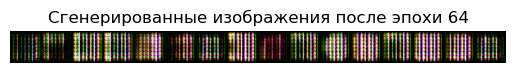

Эпоха [65/400] Шаг [100/322] D Loss: 1.4074, G Loss: 0.7321 D(x): 0.4460, D(G(z)): 0.4437 / 0.4818
Эпоха [65/400] Шаг [200/322] D Loss: 1.2097, G Loss: 0.3531 D(x): 0.7295, D(G(z)): 0.5899 / 0.7034
Эпоха [65/400] Шаг [300/322] D Loss: 1.8031, G Loss: 0.7693 D(x): 0.4654, D(G(z)): 0.6442 / 0.4641


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


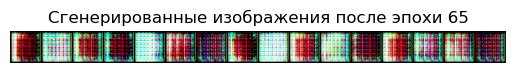

Эпоха [66/400] Шаг [100/322] D Loss: 1.8135, G Loss: 0.7839 D(x): 0.4689, D(G(z)): 0.6498 / 0.4574
Эпоха [66/400] Шаг [200/322] D Loss: 1.5555, G Loss: 0.2292 D(x): 0.8349, D(G(z)): 0.7468 / 0.7955
Эпоха [66/400] Шаг [300/322] D Loss: 0.9787, G Loss: 0.3104 D(x): 0.7580, D(G(z)): 0.5032 / 0.7334


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


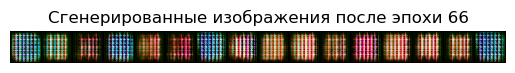

Эпоха [67/400] Шаг [100/322] D Loss: 2.0747, G Loss: 0.2651 D(x): 0.8187, D(G(z)): 0.8453 / 0.7673
Эпоха [67/400] Шаг [200/322] D Loss: 1.0485, G Loss: 0.7333 D(x): 0.4327, D(G(z)): 0.1872 / 0.4812
Эпоха [67/400] Шаг [300/322] D Loss: 1.8627, G Loss: 0.9213 D(x): 0.3806, D(G(z)): 0.5897 / 0.3989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


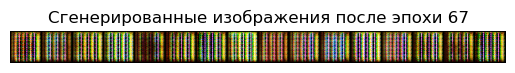

Эпоха [68/400] Шаг [100/322] D Loss: 0.9835, G Loss: 0.6170 D(x): 0.5026, D(G(z)): 0.2548 / 0.5403
Эпоха [68/400] Шаг [200/322] D Loss: 1.4331, G Loss: 0.3856 D(x): 0.7043, D(G(z)): 0.6601 / 0.6806
Эпоха [68/400] Шаг [300/322] D Loss: 1.0687, G Loss: 0.7464 D(x): 0.3880, D(G(z)): 0.1101 / 0.4768


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


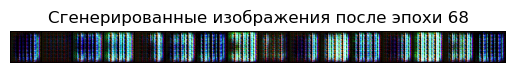

Эпоха [69/400] Шаг [100/322] D Loss: 0.2438, G Loss: 0.1511 D(x): 0.8528, D(G(z)): 0.0808 / 0.8600
Эпоха [69/400] Шаг [200/322] D Loss: 0.8934, G Loss: 0.3848 D(x): 0.6564, D(G(z)): 0.3757 / 0.6816
Эпоха [69/400] Шаг [300/322] D Loss: 1.6672, G Loss: 1.0655 D(x): 0.3268, D(G(z)): 0.4210 / 0.3459


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


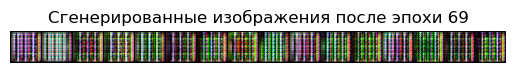

Эпоха [70/400] Шаг [100/322] D Loss: 0.7316, G Loss: 0.0728 D(x): 0.9356, D(G(z)): 0.4850 / 0.9299
Эпоха [70/400] Шаг [200/322] D Loss: 2.2630, G Loss: 1.3983 D(x): 0.2432, D(G(z)): 0.5672 / 0.2479
Эпоха [70/400] Шаг [300/322] D Loss: 1.0282, G Loss: 0.5886 D(x): 0.5319, D(G(z)): 0.3263 / 0.5554


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


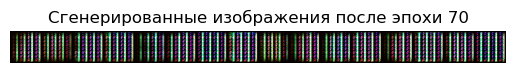

Эпоха [71/400] Шаг [100/322] D Loss: 1.4088, G Loss: 0.4385 D(x): 0.6822, D(G(z)): 0.6394 / 0.6459
Эпоха [71/400] Шаг [200/322] D Loss: 0.9368, G Loss: 0.5627 D(x): 0.5650, D(G(z)): 0.3034 / 0.5705
Эпоха [71/400] Шаг [300/322] D Loss: 1.5231, G Loss: 1.1750 D(x): 0.2621, D(G(z)): 0.1653 / 0.3094


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999998..1.0].


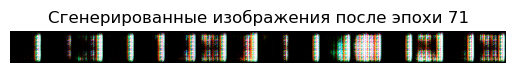

Эпоха [72/400] Шаг [100/322] D Loss: 1.5700, G Loss: 0.7613 D(x): 0.4445, D(G(z)): 0.5305 / 0.4674
Эпоха [72/400] Шаг [200/322] D Loss: 2.3850, G Loss: 0.9423 D(x): 0.4535, D(G(z)): 0.7924 / 0.3929
Эпоха [72/400] Шаг [300/322] D Loss: 0.9275, G Loss: 0.1340 D(x): 0.8896, D(G(z)): 0.5551 / 0.8747


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


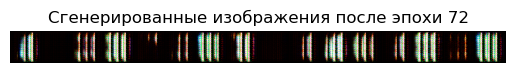

Эпоха [73/400] Шаг [100/322] D Loss: 1.2667, G Loss: 0.8892 D(x): 0.3387, D(G(z)): 0.1649 / 0.4136
Эпоха [73/400] Шаг [200/322] D Loss: 2.1132, G Loss: 0.5464 D(x): 0.6169, D(G(z)): 0.8027 / 0.5804
Эпоха [73/400] Шаг [300/322] D Loss: 2.3128, G Loss: 1.3000 D(x): 0.2660, D(G(z)): 0.6268 / 0.2731


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


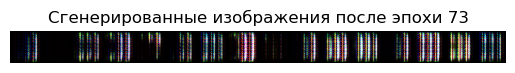

Эпоха [74/400] Шаг [100/322] D Loss: 1.3704, G Loss: 0.6893 D(x): 0.4868, D(G(z)): 0.4771 / 0.5022
Эпоха [74/400] Шаг [200/322] D Loss: 0.8784, G Loss: 0.3417 D(x): 0.7152, D(G(z)): 0.4169 / 0.7111
Эпоха [74/400] Шаг [300/322] D Loss: 1.8080, G Loss: 0.5982 D(x): 0.5759, D(G(z)): 0.7142 / 0.5502


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


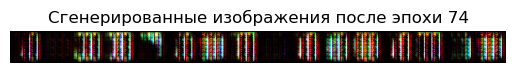

Эпоха [75/400] Шаг [100/322] D Loss: 0.8669, G Loss: 0.1832 D(x): 0.8401, D(G(z)): 0.4990 / 0.8328
Эпоха [75/400] Шаг [200/322] D Loss: 1.3136, G Loss: 0.3553 D(x): 0.7263, D(G(z)): 0.6288 / 0.7012
Эпоха [75/400] Шаг [300/322] D Loss: 0.9383, G Loss: 0.1075 D(x): 0.9167, D(G(z)): 0.5716 / 0.8985


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


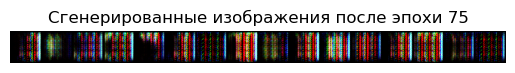

Эпоха [76/400] Шаг [100/322] D Loss: 1.1520, G Loss: 0.4832 D(x): 0.5962, D(G(z)): 0.4672 / 0.6172
Эпоха [76/400] Шаг [200/322] D Loss: 1.3768, G Loss: 0.7825 D(x): 0.4107, D(G(z)): 0.3836 / 0.4582
Эпоха [76/400] Шаг [300/322] D Loss: 0.9640, G Loss: 0.5947 D(x): 0.5540, D(G(z)): 0.3101 / 0.5525


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


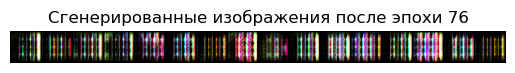

Эпоха [77/400] Шаг [100/322] D Loss: 1.3464, G Loss: 0.4973 D(x): 0.5865, D(G(z)): 0.5555 / 0.6085
Эпоха [77/400] Шаг [200/322] D Loss: 1.2982, G Loss: 0.8855 D(x): 0.3682, D(G(z)): 0.2504 / 0.4133
Эпоха [77/400] Шаг [300/322] D Loss: 1.6822, G Loss: 0.4455 D(x): 0.6595, D(G(z)): 0.7164 / 0.6414


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


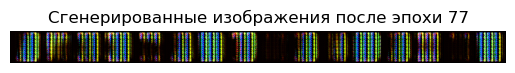

Эпоха [78/400] Шаг [100/322] D Loss: 1.0340, G Loss: 0.7006 D(x): 0.4463, D(G(z)): 0.1978 / 0.4972
Эпоха [78/400] Шаг [200/322] D Loss: 1.3683, G Loss: 0.4243 D(x): 0.6716, D(G(z)): 0.6203 / 0.6545
Эпоха [78/400] Шаг [300/322] D Loss: 0.4945, G Loss: 0.3430 D(x): 0.7112, D(G(z)): 0.1420 / 0.7097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


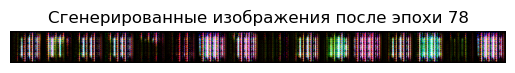

Эпоха [79/400] Шаг [100/322] D Loss: 1.5867, G Loss: 0.7534 D(x): 0.4290, D(G(z)): 0.5210 / 0.4716
Эпоха [79/400] Шаг [200/322] D Loss: 0.8270, G Loss: 0.4782 D(x): 0.5634, D(G(z)): 0.2220 / 0.6204
Эпоха [79/400] Шаг [300/322] D Loss: 0.2713, G Loss: 0.0925 D(x): 0.9142, D(G(z)): 0.1656 / 0.9117


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


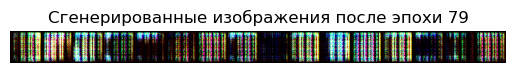

Эпоха [80/400] Шаг [100/322] D Loss: 1.0003, G Loss: 0.2912 D(x): 0.7754, D(G(z)): 0.5250 / 0.7476
Эпоха [80/400] Шаг [200/322] D Loss: 0.9729, G Loss: 0.4994 D(x): 0.5752, D(G(z)): 0.3411 / 0.6072
Эпоха [80/400] Шаг [300/322] D Loss: 0.5653, G Loss: 0.1358 D(x): 0.8788, D(G(z)): 0.3525 / 0.8735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


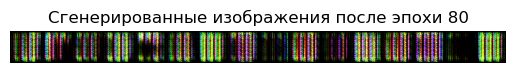

Эпоха [81/400] Шаг [100/322] D Loss: 1.8119, G Loss: 1.2443 D(x): 0.2579, D(G(z)): 0.3649 / 0.2888
Эпоха [81/400] Шаг [200/322] D Loss: 0.6986, G Loss: 0.5247 D(x): 0.5404, D(G(z)): 0.0783 / 0.5924
Эпоха [81/400] Шаг [300/322] D Loss: 0.2943, G Loss: 0.2524 D(x): 0.7642, D(G(z)): 0.0238 / 0.7774


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


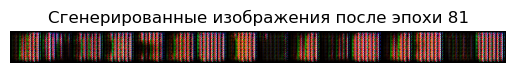

Эпоха [82/400] Шаг [100/322] D Loss: 1.0474, G Loss: 0.2762 D(x): 0.7914, D(G(z)): 0.5556 / 0.7594
Эпоха [82/400] Шаг [200/322] D Loss: 0.5899, G Loss: 0.4108 D(x): 0.6234, D(G(z)): 0.1101 / 0.6637
Эпоха [82/400] Шаг [300/322] D Loss: 1.0821, G Loss: 0.6337 D(x): 0.4819, D(G(z)): 0.2948 / 0.5312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


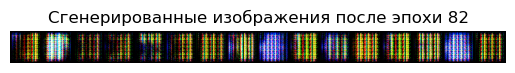

Эпоха [83/400] Шаг [100/322] D Loss: 0.6755, G Loss: 0.5233 D(x): 0.5645, D(G(z)): 0.0975 / 0.5935
Эпоха [83/400] Шаг [200/322] D Loss: 0.5514, G Loss: 0.2578 D(x): 0.7715, D(G(z)): 0.2530 / 0.7730
Эпоха [83/400] Шаг [300/322] D Loss: 1.0255, G Loss: 0.3968 D(x): 0.6824, D(G(z)): 0.4735 / 0.6726


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


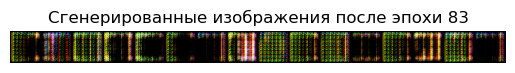

Эпоха [84/400] Шаг [100/322] D Loss: 1.1780, G Loss: 0.6274 D(x): 0.5096, D(G(z)): 0.3927 / 0.5350
Эпоха [84/400] Шаг [200/322] D Loss: 0.9755, G Loss: 0.2957 D(x): 0.7508, D(G(z)): 0.4951 / 0.7444
Эпоха [84/400] Шаг [300/322] D Loss: 0.6975, G Loss: 0.5400 D(x): 0.5501, D(G(z)): 0.0934 / 0.5843


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


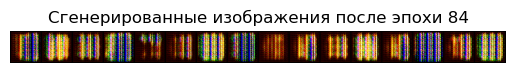

Эпоха [85/400] Шаг [100/322] D Loss: 1.2180, G Loss: 0.9362 D(x): 0.3718, D(G(z)): 0.1982 / 0.3937
Эпоха [85/400] Шаг [200/322] D Loss: 0.8043, G Loss: 0.4227 D(x): 0.6560, D(G(z)): 0.3167 / 0.6557
Эпоха [85/400] Шаг [300/322] D Loss: 1.5090, G Loss: 0.5868 D(x): 0.5499, D(G(z)): 0.5969 / 0.5565


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


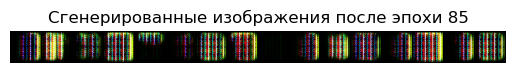

Эпоха [86/400] Шаг [100/322] D Loss: 0.2709, G Loss: 0.1884 D(x): 0.8337, D(G(z)): 0.0845 / 0.8288
Эпоха [86/400] Шаг [200/322] D Loss: 1.2643, G Loss: 0.2878 D(x): 0.7574, D(G(z)): 0.6262 / 0.7503
Эпоха [86/400] Шаг [300/322] D Loss: 1.1968, G Loss: 0.9637 D(x): 0.3480, D(G(z)): 0.1297 / 0.3819


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


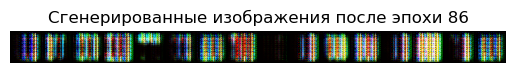

Эпоха [87/400] Шаг [100/322] D Loss: 0.5494, G Loss: 0.2920 D(x): 0.7345, D(G(z)): 0.2137 / 0.7470
Эпоха [87/400] Шаг [200/322] D Loss: 0.7263, G Loss: 0.2467 D(x): 0.7879, D(G(z)): 0.3845 / 0.7817
Эпоха [87/400] Шаг [300/322] D Loss: 1.1999, G Loss: 0.2362 D(x): 0.8092, D(G(z)): 0.6271 / 0.7901


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


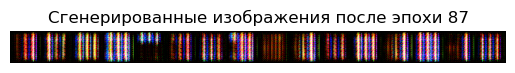

Эпоха [88/400] Шаг [100/322] D Loss: 1.9086, G Loss: 1.3247 D(x): 0.2433, D(G(z)): 0.3817 / 0.2670
Эпоха [88/400] Шаг [200/322] D Loss: 1.3911, G Loss: 0.6401 D(x): 0.5111, D(G(z)): 0.5117 / 0.5279
Эпоха [88/400] Шаг [300/322] D Loss: 1.5771, G Loss: 0.7972 D(x): 0.4385, D(G(z)): 0.5265 / 0.4512


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


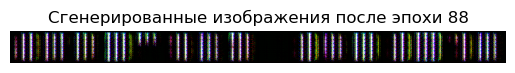

Эпоха [89/400] Шаг [100/322] D Loss: 1.1770, G Loss: 0.2101 D(x): 0.8378, D(G(z)): 0.6313 / 0.8112
Эпоха [89/400] Шаг [200/322] D Loss: 1.1363, G Loss: 0.8637 D(x): 0.3725, D(G(z)): 0.1367 / 0.4238
Эпоха [89/400] Шаг [300/322] D Loss: 1.7349, G Loss: 1.3528 D(x): 0.1925, D(G(z)): 0.0778 / 0.2611


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


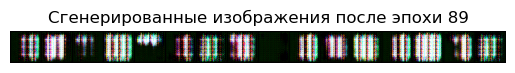

Эпоха [90/400] Шаг [100/322] D Loss: 0.5631, G Loss: 0.0983 D(x): 0.9126, D(G(z)): 0.3756 / 0.9065
Эпоха [90/400] Шаг [200/322] D Loss: 1.4707, G Loss: 1.0105 D(x): 0.2868, D(G(z)): 0.1937 / 0.3658
Эпоха [90/400] Шаг [300/322] D Loss: 0.7378, G Loss: 0.0931 D(x): 0.9202, D(G(z)): 0.4792 / 0.9112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


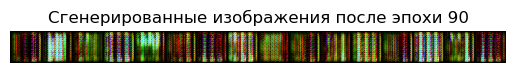

Эпоха [91/400] Шаг [100/322] D Loss: 1.3434, G Loss: 0.7083 D(x): 0.4777, D(G(z)): 0.4526 / 0.4928
Эпоха [91/400] Шаг [200/322] D Loss: 1.1100, G Loss: 0.4836 D(x): 0.6246, D(G(z)): 0.4718 / 0.6168
Эпоха [91/400] Шаг [300/322] D Loss: 1.2334, G Loss: 0.5231 D(x): 0.5810, D(G(z)): 0.4973 / 0.5930


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


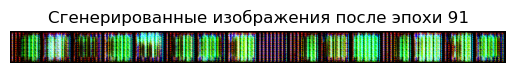

Эпоха [92/400] Шаг [100/322] D Loss: 1.0548, G Loss: 0.7257 D(x): 0.4494, D(G(z)): 0.2234 / 0.4850
Эпоха [92/400] Шаг [200/322] D Loss: 0.9390, G Loss: 0.6884 D(x): 0.4645, D(G(z)): 0.1571 / 0.5032
Эпоха [92/400] Шаг [300/322] D Loss: 1.2488, G Loss: 0.4085 D(x): 0.6575, D(G(z)): 0.5614 / 0.6649


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


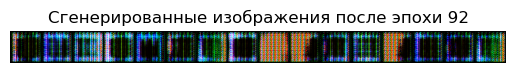

Эпоха [93/400] Шаг [100/322] D Loss: 0.6595, G Loss: 0.3331 D(x): 0.7266, D(G(z)): 0.2878 / 0.7169
Эпоха [93/400] Шаг [200/322] D Loss: 1.4170, G Loss: 0.6876 D(x): 0.5238, D(G(z)): 0.5355 / 0.5034
Эпоха [93/400] Шаг [300/322] D Loss: 0.5895, G Loss: 0.3417 D(x): 0.6983, D(G(z)): 0.2049 / 0.7107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


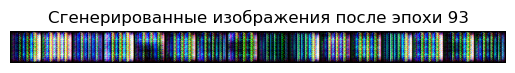

Эпоха [94/400] Шаг [100/322] D Loss: 2.1294, G Loss: 1.7414 D(x): 0.1552, D(G(z)): 0.2183 / 0.1761
Эпоха [94/400] Шаг [200/322] D Loss: 1.5139, G Loss: 0.6939 D(x): 0.5109, D(G(z)): 0.5664 / 0.5004
Эпоха [94/400] Шаг [300/322] D Loss: 1.0669, G Loss: 0.4626 D(x): 0.6323, D(G(z)): 0.4535 / 0.6302


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


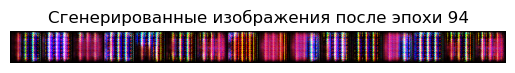

Эпоха [95/400] Шаг [100/322] D Loss: 0.9459, G Loss: 0.2925 D(x): 0.7502, D(G(z)): 0.4801 / 0.7469
Эпоха [95/400] Шаг [200/322] D Loss: 0.4728, G Loss: 0.0499 D(x): 0.9552, D(G(z)): 0.3454 / 0.9514
Эпоха [95/400] Шаг [300/322] D Loss: 0.9957, G Loss: 0.1985 D(x): 0.8393, D(G(z)): 0.5588 / 0.8204


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


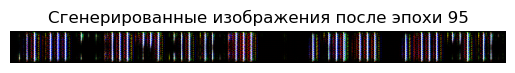

Эпоха [96/400] Шаг [100/322] D Loss: 2.5156, G Loss: 2.0742 D(x): 0.0948, D(G(z)): 0.1385 / 0.1307
Эпоха [96/400] Шаг [200/322] D Loss: 1.0282, G Loss: 0.6954 D(x): 0.4732, D(G(z)): 0.2395 / 0.4995
Эпоха [96/400] Шаг [300/322] D Loss: 0.7392, G Loss: 0.4731 D(x): 0.5994, D(G(z)): 0.2024 / 0.6238


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


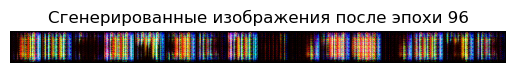

Эпоха [97/400] Шаг [100/322] D Loss: 1.5458, G Loss: 1.0825 D(x): 0.3341, D(G(z)): 0.3556 / 0.3410
Эпоха [97/400] Шаг [200/322] D Loss: 1.2503, G Loss: 0.3395 D(x): 0.7309, D(G(z)): 0.6074 / 0.7126
Эпоха [97/400] Шаг [300/322] D Loss: 0.6521, G Loss: 0.1411 D(x): 0.8870, D(G(z)): 0.4113 / 0.8686


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


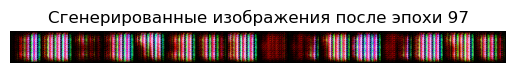

Эпоха [98/400] Шаг [100/322] D Loss: 1.0314, G Loss: 0.6799 D(x): 0.4647, D(G(z)): 0.2307 / 0.5075
Эпоха [98/400] Шаг [200/322] D Loss: 0.6188, G Loss: 0.5108 D(x): 0.5703, D(G(z)): 0.0553 / 0.6005
Эпоха [98/400] Шаг [300/322] D Loss: 0.4465, G Loss: 0.2276 D(x): 0.7974, D(G(z)): 0.1972 / 0.7966


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


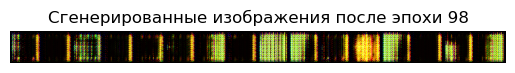

Эпоха [99/400] Шаг [100/322] D Loss: 1.4177, G Loss: 0.3103 D(x): 0.7693, D(G(z)): 0.6843 / 0.7335
Эпоха [99/400] Шаг [200/322] D Loss: 0.4153, G Loss: 0.2325 D(x): 0.7938, D(G(z)): 0.1677 / 0.7927
Эпоха [99/400] Шаг [300/322] D Loss: 2.1044, G Loss: 1.1563 D(x): 0.3174, D(G(z)): 0.6143 / 0.3160


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


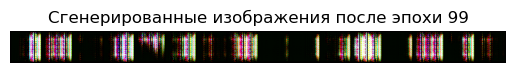

Эпоха [100/400] Шаг [100/322] D Loss: 0.5249, G Loss: 0.2401 D(x): 0.7851, D(G(z)): 0.2460 / 0.7867
Эпоха [100/400] Шаг [200/322] D Loss: 0.6267, G Loss: 0.2661 D(x): 0.7792, D(G(z)): 0.3135 / 0.7666
Эпоха [100/400] Шаг [300/322] D Loss: 1.4366, G Loss: 1.0835 D(x): 0.2882, D(G(z)): 0.1726 / 0.3403


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


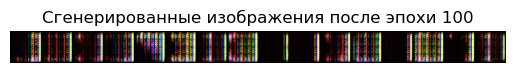

Эпоха [101/400] Шаг [100/322] D Loss: 0.8998, G Loss: 0.7090 D(x): 0.4625, D(G(z)): 0.1201 / 0.4927
Эпоха [101/400] Шаг [200/322] D Loss: 0.3350, G Loss: 0.1797 D(x): 0.8259, D(G(z)): 0.1334 / 0.8357
Эпоха [101/400] Шаг [300/322] D Loss: 1.6582, G Loss: 0.8392 D(x): 0.4497, D(G(z)): 0.5722 / 0.4336


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


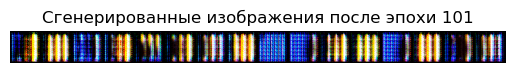

Эпоха [102/400] Шаг [100/322] D Loss: 1.2060, G Loss: 0.3566 D(x): 0.7131, D(G(z)): 0.5791 / 0.7005
Эпоха [102/400] Шаг [200/322] D Loss: 1.7225, G Loss: 0.4412 D(x): 0.6665, D(G(z)): 0.7316 / 0.6435
Эпоха [102/400] Шаг [300/322] D Loss: 1.2464, G Loss: 0.6276 D(x): 0.5268, D(G(z)): 0.4525 / 0.5345


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


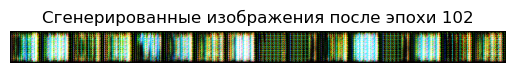

Эпоха [103/400] Шаг [100/322] D Loss: 0.6627, G Loss: 0.3598 D(x): 0.6794, D(G(z)): 0.2398 / 0.6981
Эпоха [103/400] Шаг [200/322] D Loss: 0.7561, G Loss: 0.5200 D(x): 0.5788, D(G(z)): 0.1880 / 0.5951
Эпоха [103/400] Шаг [300/322] D Loss: 1.2216, G Loss: 0.5423 D(x): 0.6103, D(G(z)): 0.5158 / 0.5824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


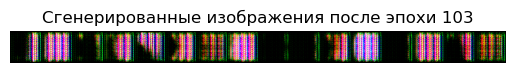

Эпоха [104/400] Шаг [100/322] D Loss: 1.3795, G Loss: 0.7800 D(x): 0.4338, D(G(z)): 0.4188 / 0.4587
Эпоха [104/400] Шаг [200/322] D Loss: 0.9596, G Loss: 0.4659 D(x): 0.6354, D(G(z)): 0.3964 / 0.6281
Эпоха [104/400] Шаг [300/322] D Loss: 2.1694, G Loss: 1.3119 D(x): 0.2422, D(G(z)): 0.5260 / 0.2708


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


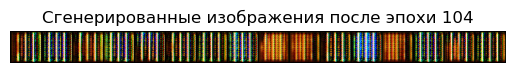

Эпоха [105/400] Шаг [100/322] D Loss: 1.5025, G Loss: 0.3762 D(x): 0.6995, D(G(z)): 0.6807 / 0.6866
Эпоха [105/400] Шаг [200/322] D Loss: 1.3600, G Loss: 0.3796 D(x): 0.6963, D(G(z)): 0.6303 / 0.6843
Эпоха [105/400] Шаг [300/322] D Loss: 1.1134, G Loss: 0.5657 D(x): 0.5456, D(G(z)): 0.3955 / 0.5691


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


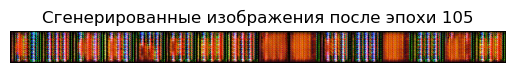

Эпоха [106/400] Шаг [100/322] D Loss: 0.7219, G Loss: 0.4942 D(x): 0.5700, D(G(z)): 0.1453 / 0.6113
Эпоха [106/400] Шаг [200/322] D Loss: 0.6409, G Loss: 0.2769 D(x): 0.7506, D(G(z)): 0.2967 / 0.7587
Эпоха [106/400] Шаг [300/322] D Loss: 0.7715, G Loss: 0.4800 D(x): 0.6106, D(G(z)): 0.2418 / 0.6191


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


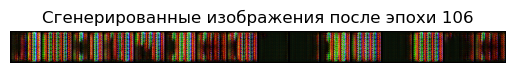

Эпоха [107/400] Шаг [100/322] D Loss: 0.8995, G Loss: 0.6508 D(x): 0.4816, D(G(z)): 0.1537 / 0.5229
Эпоха [107/400] Шаг [200/322] D Loss: 0.7083, G Loss: 0.1245 D(x): 0.8880, D(G(z)): 0.4440 / 0.8831
Эпоха [107/400] Шаг [300/322] D Loss: 1.0870, G Loss: 0.8348 D(x): 0.4169, D(G(z)): 0.1869 / 0.4355


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


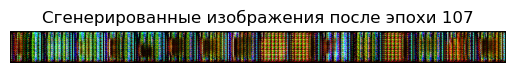

Эпоха [108/400] Шаг [100/322] D Loss: 1.5701, G Loss: 1.3615 D(x): 0.2349, D(G(z)): 0.1125 / 0.2579
Эпоха [108/400] Шаг [200/322] D Loss: 0.8603, G Loss: 0.4080 D(x): 0.6566, D(G(z)): 0.3550 / 0.6655
Эпоха [108/400] Шаг [300/322] D Loss: 1.6188, G Loss: 0.4268 D(x): 0.6794, D(G(z)): 0.7074 / 0.6530


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


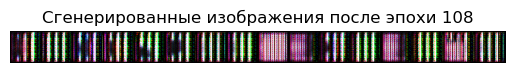

Эпоха [109/400] Шаг [100/322] D Loss: 1.4807, G Loss: 0.7787 D(x): 0.4305, D(G(z)): 0.4697 / 0.4594
Эпоха [109/400] Шаг [200/322] D Loss: 2.6490, G Loss: 0.7133 D(x): 0.5195, D(G(z)): 0.8631 / 0.4916
Эпоха [109/400] Шаг [300/322] D Loss: 0.8229, G Loss: 0.4193 D(x): 0.6433, D(G(z)): 0.3168 / 0.6579


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


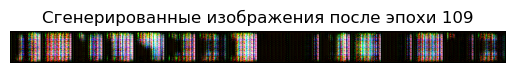

Эпоха [110/400] Шаг [100/322] D Loss: 2.5068, G Loss: 0.1202 D(x): 0.9130, D(G(z)): 0.9100 / 0.8868
Эпоха [110/400] Шаг [200/322] D Loss: 1.0931, G Loss: 0.8992 D(x): 0.3835, D(G(z)): 0.1236 / 0.4077
Эпоха [110/400] Шаг [300/322] D Loss: 2.9035, G Loss: 1.0054 D(x): 0.3732, D(G(z)): 0.8521 / 0.3687


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


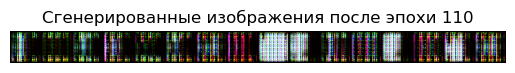

Эпоха [111/400] Шаг [100/322] D Loss: 0.8385, G Loss: 0.3812 D(x): 0.6759, D(G(z)): 0.3595 / 0.6832
Эпоха [111/400] Шаг [200/322] D Loss: 0.6683, G Loss: 0.3150 D(x): 0.7308, D(G(z)): 0.2980 / 0.7301
Эпоха [111/400] Шаг [300/322] D Loss: 2.1977, G Loss: 1.6061 D(x): 0.1849, D(G(z)): 0.3969 / 0.2011


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


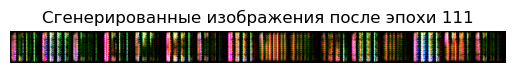

Эпоха [112/400] Шаг [100/322] D Loss: 1.0038, G Loss: 0.2454 D(x): 0.7913, D(G(z)): 0.5355 / 0.7825
Эпоха [112/400] Шаг [200/322] D Loss: 0.6285, G Loss: 0.3567 D(x): 0.6979, D(G(z)): 0.2347 / 0.7002
Эпоха [112/400] Шаг [300/322] D Loss: 1.0174, G Loss: 0.5505 D(x): 0.5654, D(G(z)): 0.3597 / 0.5772


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


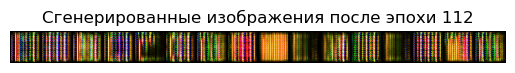

Эпоха [113/400] Шаг [100/322] D Loss: 2.1967, G Loss: 1.8497 D(x): 0.1245, D(G(z)): 0.1043 / 0.1598
Эпоха [113/400] Шаг [200/322] D Loss: 1.0765, G Loss: 0.4872 D(x): 0.5987, D(G(z)): 0.4277 / 0.6148
Эпоха [113/400] Шаг [300/322] D Loss: 0.9439, G Loss: 0.4640 D(x): 0.6169, D(G(z)): 0.3678 / 0.6296


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


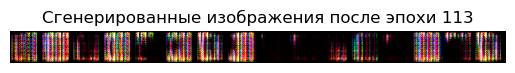

Эпоха [114/400] Шаг [100/322] D Loss: 0.7322, G Loss: 0.3410 D(x): 0.6961, D(G(z)): 0.3085 / 0.7113
Эпоха [114/400] Шаг [200/322] D Loss: 1.5552, G Loss: 1.2263 D(x): 0.2660, D(G(z)): 0.2044 / 0.2946
Эпоха [114/400] Шаг [300/322] D Loss: 1.1485, G Loss: 0.9203 D(x): 0.3446, D(G(z)): 0.0777 / 0.3990


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


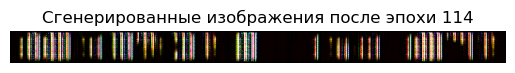

Эпоха [115/400] Шаг [100/322] D Loss: 0.7277, G Loss: 0.3142 D(x): 0.7385, D(G(z)): 0.3455 / 0.7306
Эпоха [115/400] Шаг [200/322] D Loss: 1.1036, G Loss: 0.5232 D(x): 0.5812, D(G(z)): 0.4283 / 0.5931
Эпоха [115/400] Шаг [300/322] D Loss: 0.7171, G Loss: 0.3161 D(x): 0.7218, D(G(z)): 0.3230 / 0.7295


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


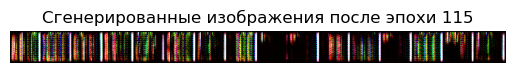

Эпоха [116/400] Шаг [100/322] D Loss: 0.5249, G Loss: 0.0737 D(x): 0.9290, D(G(z)): 0.3630 / 0.9290
Эпоха [116/400] Шаг [200/322] D Loss: 0.6193, G Loss: 0.2326 D(x): 0.7805, D(G(z)): 0.3094 / 0.7930
Эпоха [116/400] Шаг [300/322] D Loss: 0.6455, G Loss: 0.4710 D(x): 0.5959, D(G(z)): 0.1175 / 0.6249


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


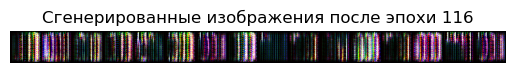

Эпоха [117/400] Шаг [100/322] D Loss: 0.9860, G Loss: 0.6278 D(x): 0.5123, D(G(z)): 0.2704 / 0.5341
Эпоха [117/400] Шаг [200/322] D Loss: 1.1382, G Loss: 0.7346 D(x): 0.4496, D(G(z)): 0.2844 / 0.4807
Эпоха [117/400] Шаг [300/322] D Loss: 1.8671, G Loss: 1.1187 D(x): 0.3134, D(G(z)): 0.5035 / 0.3274


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


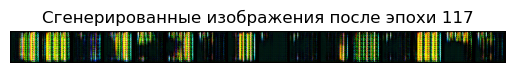

Эпоха [118/400] Шаг [100/322] D Loss: 0.4875, G Loss: 0.3143 D(x): 0.7196, D(G(z)): 0.1462 / 0.7306
Эпоха [118/400] Шаг [200/322] D Loss: 2.0404, G Loss: 0.8788 D(x): 0.4154, D(G(z)): 0.6828 / 0.4159
Эпоха [118/400] Шаг [300/322] D Loss: 0.7218, G Loss: 0.3716 D(x): 0.6767, D(G(z)): 0.2815 / 0.6907


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


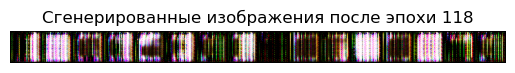

Эпоха [119/400] Шаг [100/322] D Loss: 1.0554, G Loss: 0.4643 D(x): 0.6563, D(G(z)): 0.4657 / 0.6300
Эпоха [119/400] Шаг [200/322] D Loss: 1.1553, G Loss: 0.7963 D(x): 0.4249, D(G(z)): 0.2564 / 0.4520
Эпоха [119/400] Шаг [300/322] D Loss: 1.2346, G Loss: 0.9584 D(x): 0.3531, D(G(z)): 0.1748 / 0.3846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


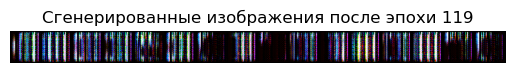

Эпоха [120/400] Шаг [100/322] D Loss: 2.1248, G Loss: 1.8628 D(x): 0.1281, D(G(z)): 0.0613 / 0.1559
Эпоха [120/400] Шаг [200/322] D Loss: 0.8752, G Loss: 0.4651 D(x): 0.6209, D(G(z)): 0.3276 / 0.6283
Эпоха [120/400] Шаг [300/322] D Loss: 1.2893, G Loss: 0.8833 D(x): 0.3954, D(G(z)): 0.2996 / 0.4137


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


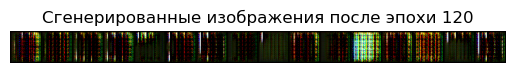

Эпоха [121/400] Шаг [100/322] D Loss: 1.0456, G Loss: 0.1814 D(x): 0.8382, D(G(z)): 0.5776 / 0.8343
Эпоха [121/400] Шаг [200/322] D Loss: 0.5138, G Loss: 0.1708 D(x): 0.8442, D(G(z)): 0.2912 / 0.8430
Эпоха [121/400] Шаг [300/322] D Loss: 1.2692, G Loss: 0.5772 D(x): 0.5789, D(G(z)): 0.5124 / 0.5623


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


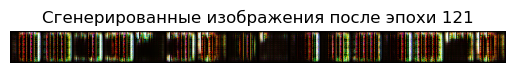

Эпоха [122/400] Шаг [100/322] D Loss: 0.8442, G Loss: 0.6070 D(x): 0.5173, D(G(z)): 0.1669 / 0.5465
Эпоха [122/400] Шаг [200/322] D Loss: 0.4289, G Loss: 0.0922 D(x): 0.9090, D(G(z)): 0.2832 / 0.9121
Эпоха [122/400] Шаг [300/322] D Loss: 0.6138, G Loss: 0.3325 D(x): 0.6940, D(G(z)): 0.2196 / 0.7173


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


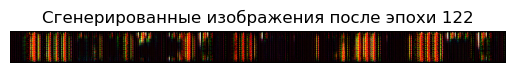

Эпоха [123/400] Шаг [100/322] D Loss: 1.4333, G Loss: 1.0761 D(x): 0.2829, D(G(z)): 0.1520 / 0.3453
Эпоха [123/400] Шаг [200/322] D Loss: 1.6856, G Loss: 0.4645 D(x): 0.6609, D(G(z)): 0.7186 / 0.6289
Эпоха [123/400] Шаг [300/322] D Loss: 0.9608, G Loss: 0.5380 D(x): 0.5719, D(G(z)): 0.3284 / 0.5842


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


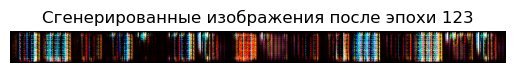

Эпоха [124/400] Шаг [100/322] D Loss: 0.6153, G Loss: 0.1990 D(x): 0.8363, D(G(z)): 0.3523 / 0.8199
Эпоха [124/400] Шаг [200/322] D Loss: 1.7822, G Loss: 0.7415 D(x): 0.4788, D(G(z)): 0.6477 / 0.4769
Эпоха [124/400] Шаг [300/322] D Loss: 1.4563, G Loss: 0.7870 D(x): 0.4548, D(G(z)): 0.4867 / 0.4554


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


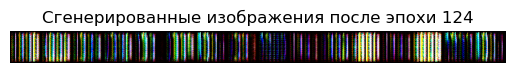

Эпоха [125/400] Шаг [100/322] D Loss: 0.8056, G Loss: 0.1994 D(x): 0.8354, D(G(z)): 0.4634 / 0.8196
Эпоха [125/400] Шаг [200/322] D Loss: 1.5837, G Loss: 0.3189 D(x): 0.7553, D(G(z)): 0.7273 / 0.7272
Эпоха [125/400] Шаг [300/322] D Loss: 2.9192, G Loss: 2.0255 D(x): 0.1175, D(G(z)): 0.5354 / 0.1326


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


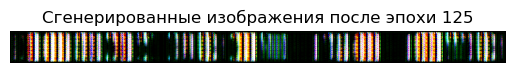

Эпоха [126/400] Шаг [100/322] D Loss: 0.7575, G Loss: 0.2858 D(x): 0.7501, D(G(z)): 0.3743 / 0.7516
Эпоха [126/400] Шаг [200/322] D Loss: 0.5423, G Loss: 0.1851 D(x): 0.8347, D(G(z)): 0.3032 / 0.8312
Эпоха [126/400] Шаг [300/322] D Loss: 0.2584, G Loss: 0.1605 D(x): 0.8386, D(G(z)): 0.0788 / 0.8519


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


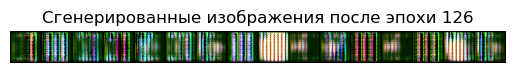

Эпоха [127/400] Шаг [100/322] D Loss: 0.6119, G Loss: 0.2313 D(x): 0.8007, D(G(z)): 0.3214 / 0.7938
Эпоха [127/400] Шаг [200/322] D Loss: 0.7956, G Loss: 0.0715 D(x): 0.9367, D(G(z)): 0.5179 / 0.9310
Эпоха [127/400] Шаг [300/322] D Loss: 0.7226, G Loss: 0.5028 D(x): 0.5762, D(G(z)): 0.1551 / 0.6051


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


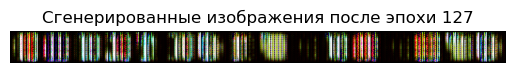

Эпоха [128/400] Шаг [100/322] D Loss: 1.4052, G Loss: 0.8115 D(x): 0.4289, D(G(z)): 0.4273 / 0.4445
Эпоха [128/400] Шаг [200/322] D Loss: 0.8255, G Loss: 0.1923 D(x): 0.8336, D(G(z)): 0.4736 / 0.8252
Эпоха [128/400] Шаг [300/322] D Loss: 1.4953, G Loss: 0.1710 D(x): 0.8667, D(G(z)): 0.7408 / 0.8433


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


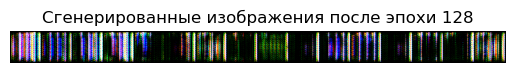

Эпоха [129/400] Шаг [100/322] D Loss: 2.1266, G Loss: 0.6050 D(x): 0.5189, D(G(z)): 0.7680 / 0.5467
Эпоха [129/400] Шаг [200/322] D Loss: 1.6716, G Loss: 1.1591 D(x): 0.3174, D(G(z)): 0.3952 / 0.3168
Эпоха [129/400] Шаг [300/322] D Loss: 1.4036, G Loss: 0.9118 D(x): 0.3885, D(G(z)): 0.3661 / 0.4022


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


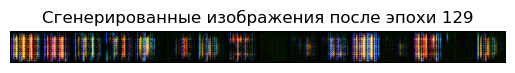

Эпоха [130/400] Шаг [100/322] D Loss: 0.7325, G Loss: 0.3431 D(x): 0.7064, D(G(z)): 0.3188 / 0.7098
Эпоха [130/400] Шаг [200/322] D Loss: 1.8220, G Loss: 1.4246 D(x): 0.2039, D(G(z)): 0.2040 / 0.2414
Эпоха [130/400] Шаг [300/322] D Loss: 1.5076, G Loss: 1.0474 D(x): 0.3444, D(G(z)): 0.3514 / 0.3517


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


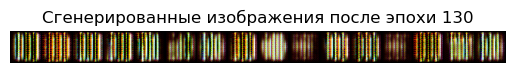

Эпоха [131/400] Шаг [100/322] D Loss: 0.7841, G Loss: 0.1201 D(x): 0.8982, D(G(z)): 0.4913 / 0.8871
Эпоха [131/400] Шаг [200/322] D Loss: 2.9278, G Loss: 1.7381 D(x): 0.1690, D(G(z)): 0.6785 / 0.1777
Эпоха [131/400] Шаг [300/322] D Loss: 1.0102, G Loss: 0.7376 D(x): 0.4694, D(G(z)): 0.2232 / 0.4786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


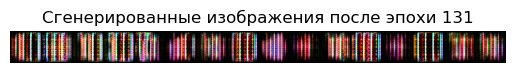

Эпоха [132/400] Шаг [100/322] D Loss: 0.7481, G Loss: 0.3385 D(x): 0.7129, D(G(z)): 0.3350 / 0.7133
Эпоха [132/400] Шаг [200/322] D Loss: 1.5351, G Loss: 0.9473 D(x): 0.3575, D(G(z)): 0.3921 / 0.3892
Эпоха [132/400] Шаг [300/322] D Loss: 1.5054, G Loss: 0.5314 D(x): 0.6074, D(G(z)): 0.6329 / 0.5882


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


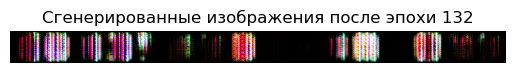

Эпоха [133/400] Шаг [100/322] D Loss: 0.7042, G Loss: 0.1280 D(x): 0.8887, D(G(z)): 0.4421 / 0.8801
Эпоха [133/400] Шаг [200/322] D Loss: 0.9277, G Loss: 0.4081 D(x): 0.6599, D(G(z)): 0.3987 / 0.6653
Эпоха [133/400] Шаг [300/322] D Loss: 1.1389, G Loss: 0.6045 D(x): 0.5458, D(G(z)): 0.4129 / 0.5468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


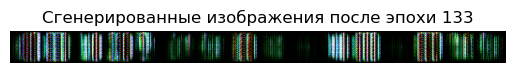

Эпоха [134/400] Шаг [100/322] D Loss: 1.2780, G Loss: 0.9654 D(x): 0.3531, D(G(z)): 0.2061 / 0.3815
Эпоха [134/400] Шаг [200/322] D Loss: 0.2410, G Loss: 0.0775 D(x): 0.9242, D(G(z)): 0.1496 / 0.9255
Эпоха [134/400] Шаг [300/322] D Loss: 0.4388, G Loss: 0.2601 D(x): 0.7676, D(G(z)): 0.1597 / 0.7711


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


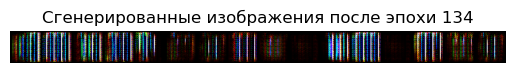

Эпоха [135/400] Шаг [100/322] D Loss: 1.3778, G Loss: 0.4203 D(x): 0.6794, D(G(z)): 0.6209 / 0.6573
Эпоха [135/400] Шаг [200/322] D Loss: 0.8114, G Loss: 0.5222 D(x): 0.5629, D(G(z)): 0.2094 / 0.5939
Эпоха [135/400] Шаг [300/322] D Loss: 1.9866, G Loss: 1.6485 D(x): 0.1597, D(G(z)): 0.1314 / 0.1981


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


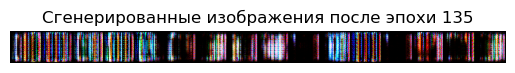

Эпоха [136/400] Шаг [100/322] D Loss: 0.4508, G Loss: 0.1734 D(x): 0.8378, D(G(z)): 0.2388 / 0.8411
Эпоха [136/400] Шаг [200/322] D Loss: 0.5059, G Loss: 0.0633 D(x): 0.9415, D(G(z)): 0.3594 / 0.9387
Эпоха [136/400] Шаг [300/322] D Loss: 0.9030, G Loss: 0.1547 D(x): 0.8654, D(G(z)): 0.5308 / 0.8568


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


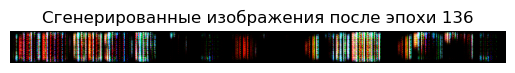

Эпоха [137/400] Шаг [100/322] D Loss: 1.6788, G Loss: 0.6420 D(x): 0.5240, D(G(z)): 0.6424 / 0.5266
Эпоха [137/400] Шаг [200/322] D Loss: 0.3992, G Loss: 0.2088 D(x): 0.8070, D(G(z)): 0.1684 / 0.8117
Эпоха [137/400] Шаг [300/322] D Loss: 1.3133, G Loss: 0.2290 D(x): 0.8007, D(G(z)): 0.6598 / 0.7955


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


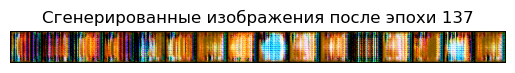

Эпоха [138/400] Шаг [100/322] D Loss: 1.1476, G Loss: 0.6363 D(x): 0.5274, D(G(z)): 0.3954 / 0.5299
Эпоха [138/400] Шаг [200/322] D Loss: 0.4978, G Loss: 0.2676 D(x): 0.7468, D(G(z)): 0.1855 / 0.7655
Эпоха [138/400] Шаг [300/322] D Loss: 0.7654, G Loss: 0.5544 D(x): 0.5585, D(G(z)): 0.1668 / 0.5748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


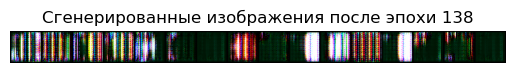

Эпоха [139/400] Шаг [100/322] D Loss: 1.2565, G Loss: 0.7528 D(x): 0.4453, D(G(z)): 0.3586 / 0.4722
Эпоха [139/400] Шаг [200/322] D Loss: 0.8316, G Loss: 0.4670 D(x): 0.6261, D(G(z)): 0.3040 / 0.6272
Эпоха [139/400] Шаг [300/322] D Loss: 1.0947, G Loss: 0.4681 D(x): 0.6156, D(G(z)): 0.4558 / 0.6265


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


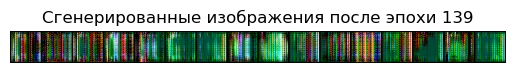

Эпоха [140/400] Шаг [100/322] D Loss: 1.9127, G Loss: 0.8039 D(x): 0.4502, D(G(z)): 0.6704 / 0.4492
Эпоха [140/400] Шаг [200/322] D Loss: 1.1632, G Loss: 0.7049 D(x): 0.4845, D(G(z)): 0.3534 / 0.4948
Эпоха [140/400] Шаг [300/322] D Loss: 1.2204, G Loss: 0.5081 D(x): 0.6086, D(G(z)): 0.5142 / 0.6022


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


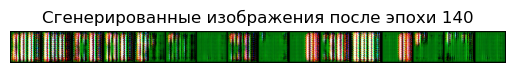

Эпоха [141/400] Шаг [100/322] D Loss: 0.5793, G Loss: 0.3193 D(x): 0.7154, D(G(z)): 0.2164 / 0.7268
Эпоха [141/400] Шаг [200/322] D Loss: 0.9541, G Loss: 0.4164 D(x): 0.6559, D(G(z)): 0.4123 / 0.6597
Эпоха [141/400] Шаг [300/322] D Loss: 1.3954, G Loss: 0.4027 D(x): 0.6714, D(G(z)): 0.6286 / 0.6689


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


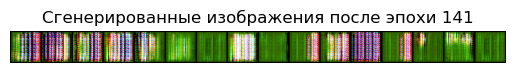

Эпоха [142/400] Шаг [100/322] D Loss: 0.4910, G Loss: 0.1550 D(x): 0.8622, D(G(z)): 0.2892 / 0.8568
Эпоха [142/400] Шаг [200/322] D Loss: 2.6031, G Loss: 1.7708 D(x): 0.1563, D(G(z)): 0.5229 / 0.1710
Эпоха [142/400] Шаг [300/322] D Loss: 0.8863, G Loss: 0.6113 D(x): 0.5156, D(G(z)): 0.1986 / 0.5438


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


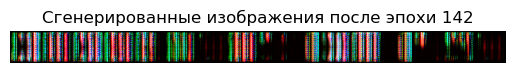

Эпоха [143/400] Шаг [100/322] D Loss: 0.9457, G Loss: 0.5851 D(x): 0.5470, D(G(z)): 0.2884 / 0.5574
Эпоха [143/400] Шаг [200/322] D Loss: 0.8922, G Loss: 0.6228 D(x): 0.5010, D(G(z)): 0.1811 / 0.5369
Эпоха [143/400] Шаг [300/322] D Loss: 0.8791, G Loss: 0.5985 D(x): 0.5246, D(G(z)): 0.2075 / 0.5506


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


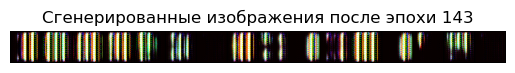

Эпоха [144/400] Шаг [100/322] D Loss: 1.6673, G Loss: 0.3736 D(x): 0.7187, D(G(z)): 0.7363 / 0.6886
Эпоха [144/400] Шаг [200/322] D Loss: 0.3883, G Loss: 0.1475 D(x): 0.8607, D(G(z)): 0.2118 / 0.8630
Эпоха [144/400] Шаг [300/322] D Loss: 0.7452, G Loss: 0.4962 D(x): 0.5905, D(G(z)): 0.1943 / 0.6102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


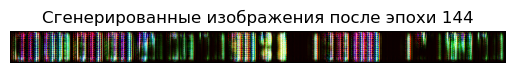

Эпоха [145/400] Шаг [100/322] D Loss: 2.4021, G Loss: 0.3387 D(x): 0.7343, D(G(z)): 0.8761 / 0.7128
Эпоха [145/400] Шаг [200/322] D Loss: 1.2409, G Loss: 0.5881 D(x): 0.5443, D(G(z)): 0.4668 / 0.5562
Эпоха [145/400] Шаг [300/322] D Loss: 1.8872, G Loss: 0.8294 D(x): 0.4329, D(G(z)): 0.6490 / 0.4367


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


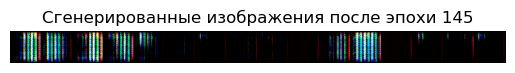

Эпоха [146/400] Шаг [100/322] D Loss: 0.5968, G Loss: 0.3063 D(x): 0.7256, D(G(z)): 0.2409 / 0.7364
Эпоха [146/400] Шаг [200/322] D Loss: 1.0017, G Loss: 0.5611 D(x): 0.5626, D(G(z)): 0.3460 / 0.5714
Эпоха [146/400] Шаг [300/322] D Loss: 1.1406, G Loss: 0.8222 D(x): 0.4054, D(G(z)): 0.2105 / 0.4398


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


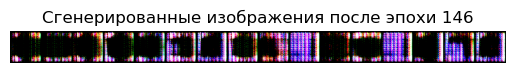

Эпоха [147/400] Шаг [100/322] D Loss: 1.4527, G Loss: 0.6719 D(x): 0.5114, D(G(z)): 0.5387 / 0.5112
Эпоха [147/400] Шаг [200/322] D Loss: 1.3772, G Loss: 0.4184 D(x): 0.6544, D(G(z)): 0.6132 / 0.6586
Эпоха [147/400] Шаг [300/322] D Loss: 2.4817, G Loss: 0.6856 D(x): 0.5121, D(G(z)): 0.8354 / 0.5051


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


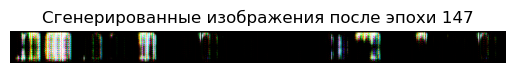

Эпоха [148/400] Шаг [100/322] D Loss: 1.2857, G Loss: 0.9952 D(x): 0.3514, D(G(z)): 0.2088 / 0.3707
Эпоха [148/400] Шаг [200/322] D Loss: 1.0945, G Loss: 0.8442 D(x): 0.3919, D(G(z)): 0.1429 / 0.4313
Эпоха [148/400] Шаг [300/322] D Loss: 0.7953, G Loss: 0.2913 D(x): 0.7453, D(G(z)): 0.3938 / 0.7475


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


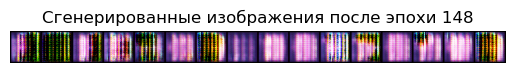

Эпоха [149/400] Шаг [100/322] D Loss: 0.7105, G Loss: 0.5014 D(x): 0.5599, D(G(z)): 0.1215 / 0.6061
Эпоха [149/400] Шаг [200/322] D Loss: 0.7606, G Loss: 0.5729 D(x): 0.5407, D(G(z)): 0.1343 / 0.5643
Эпоха [149/400] Шаг [300/322] D Loss: 0.9661, G Loss: 0.4739 D(x): 0.6163, D(G(z)): 0.3816 / 0.6228


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


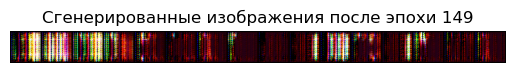

Эпоха [150/400] Шаг [100/322] D Loss: 0.9825, G Loss: 0.3708 D(x): 0.7172, D(G(z)): 0.4767 / 0.6913
Эпоха [150/400] Шаг [200/322] D Loss: 1.0724, G Loss: 0.4065 D(x): 0.6672, D(G(z)): 0.4860 / 0.6663
Эпоха [150/400] Шаг [300/322] D Loss: 1.7163, G Loss: 0.9561 D(x): 0.3666, D(G(z)): 0.5067 / 0.3860


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


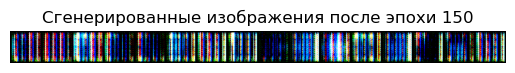

Эпоха [151/400] Шаг [100/322] D Loss: 2.6912, G Loss: 1.8500 D(x): 0.1390, D(G(z)): 0.5101 / 0.1578
Эпоха [151/400] Шаг [200/322] D Loss: 1.4425, G Loss: 1.0697 D(x): 0.3100, D(G(z)): 0.2365 / 0.3438
Эпоха [151/400] Шаг [300/322] D Loss: 1.5576, G Loss: 0.8032 D(x): 0.4283, D(G(z)): 0.5009 / 0.4490


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


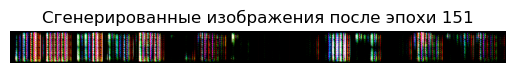

Эпоха [152/400] Шаг [100/322] D Loss: 1.3115, G Loss: 0.8571 D(x): 0.3973, D(G(z)): 0.3180 / 0.4256
Эпоха [152/400] Шаг [200/322] D Loss: 0.9502, G Loss: 0.5152 D(x): 0.5694, D(G(z)): 0.3183 / 0.5979
Эпоха [152/400] Шаг [300/322] D Loss: 0.8033, G Loss: 0.6282 D(x): 0.5034, D(G(z)): 0.1097 / 0.5338


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


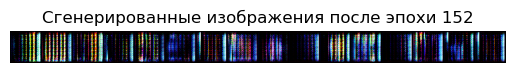

Эпоха [153/400] Шаг [100/322] D Loss: 1.5209, G Loss: 1.2899 D(x): 0.2550, D(G(z)): 0.1401 / 0.2762
Эпоха [153/400] Шаг [200/322] D Loss: 0.4303, G Loss: 0.3118 D(x): 0.7193, D(G(z)): 0.0957 / 0.7325
Эпоха [153/400] Шаг [300/322] D Loss: 0.9035, G Loss: 0.5060 D(x): 0.5953, D(G(z)): 0.3173 / 0.6037


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


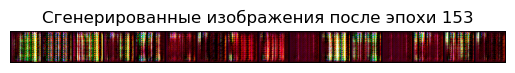

Эпоха [154/400] Шаг [100/322] D Loss: 1.1283, G Loss: 0.5956 D(x): 0.5356, D(G(z)): 0.3938 / 0.5520
Эпоха [154/400] Шаг [200/322] D Loss: 1.2227, G Loss: 0.4756 D(x): 0.6265, D(G(z)): 0.5284 / 0.6217
Эпоха [154/400] Шаг [300/322] D Loss: 1.1737, G Loss: 0.3250 D(x): 0.7260, D(G(z)): 0.5737 / 0.7228


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


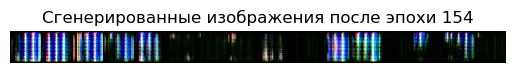

Эпоха [155/400] Шаг [100/322] D Loss: 1.9931, G Loss: 0.7689 D(x): 0.4656, D(G(z)): 0.7057 / 0.4639
Эпоха [155/400] Шаг [200/322] D Loss: 1.1066, G Loss: 0.3645 D(x): 0.6952, D(G(z)): 0.5233 / 0.6948
Эпоха [155/400] Шаг [300/322] D Loss: 1.1662, G Loss: 0.7157 D(x): 0.4755, D(G(z)): 0.3439 / 0.4892


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


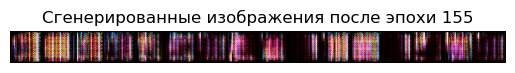

Эпоха [156/400] Шаг [100/322] D Loss: 1.1382, G Loss: 0.3407 D(x): 0.7201, D(G(z)): 0.5543 / 0.7115
Эпоха [156/400] Шаг [200/322] D Loss: 1.7246, G Loss: 0.2725 D(x): 0.7755, D(G(z)): 0.7697 / 0.7616
Эпоха [156/400] Шаг [300/322] D Loss: 0.4664, G Loss: 0.2595 D(x): 0.7687, D(G(z)): 0.1838 / 0.7715


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


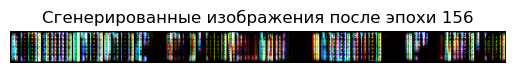

Эпоха [157/400] Шаг [100/322] D Loss: 0.4031, G Loss: 0.1884 D(x): 0.8230, D(G(z)): 0.1879 / 0.8283
Эпоха [157/400] Шаг [200/322] D Loss: 1.4717, G Loss: 1.1254 D(x): 0.2945, D(G(z)): 0.2196 / 0.3262
Эпоха [157/400] Шаг [300/322] D Loss: 1.0953, G Loss: 0.7372 D(x): 0.4581, D(G(z)): 0.2694 / 0.4791


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


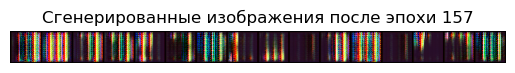

Эпоха [158/400] Шаг [100/322] D Loss: 0.6595, G Loss: 0.2280 D(x): 0.7944, D(G(z)): 0.3487 / 0.7962
Эпоха [158/400] Шаг [200/322] D Loss: 0.6013, G Loss: 0.1020 D(x): 0.9016, D(G(z)): 0.3907 / 0.9031
Эпоха [158/400] Шаг [300/322] D Loss: 0.9355, G Loss: 0.0965 D(x): 0.9226, D(G(z)): 0.5743 / 0.9082


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


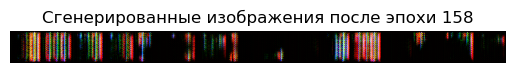

Эпоха [159/400] Шаг [100/322] D Loss: 1.3647, G Loss: 0.9164 D(x): 0.3753, D(G(z)): 0.3186 / 0.4010
Эпоха [159/400] Шаг [200/322] D Loss: 2.2812, G Loss: 1.3762 D(x): 0.2339, D(G(z)): 0.5601 / 0.2538
Эпоха [159/400] Шаг [300/322] D Loss: 1.3036, G Loss: 1.0597 D(x): 0.3273, D(G(z)): 0.1668 / 0.3476


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


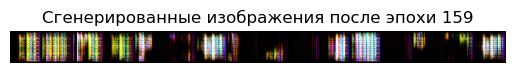

Эпоха [160/400] Шаг [100/322] D Loss: 0.4121, G Loss: 0.3416 D(x): 0.7055, D(G(z)): 0.0608 / 0.7112
Эпоха [160/400] Шаг [200/322] D Loss: 1.0352, G Loss: 0.5641 D(x): 0.5610, D(G(z)): 0.3646 / 0.5692
Эпоха [160/400] Шаг [300/322] D Loss: 1.6352, G Loss: 0.8073 D(x): 0.4559, D(G(z)): 0.5700 / 0.4471


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


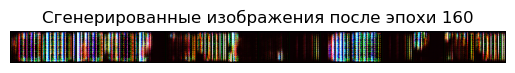

Эпоха [161/400] Шаг [100/322] D Loss: 2.1468, G Loss: 1.4679 D(x): 0.2234, D(G(z)): 0.4732 / 0.2309
Эпоха [161/400] Шаг [200/322] D Loss: 1.4418, G Loss: 0.7867 D(x): 0.4483, D(G(z)): 0.4711 / 0.4556
Эпоха [161/400] Шаг [300/322] D Loss: 2.1984, G Loss: 0.7929 D(x): 0.4555, D(G(z)): 0.7549 / 0.4529


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


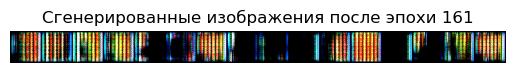

Эпоха [162/400] Шаг [100/322] D Loss: 2.5570, G Loss: 0.5882 D(x): 0.5843, D(G(z)): 0.8661 / 0.5563
Эпоха [162/400] Шаг [200/322] D Loss: 1.9817, G Loss: 1.4195 D(x): 0.2097, D(G(z)): 0.3387 / 0.2426
Эпоха [162/400] Шаг [300/322] D Loss: 0.6000, G Loss: 0.3658 D(x): 0.6860, D(G(z)): 0.1995 / 0.6939


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


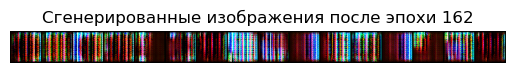

Эпоха [163/400] Шаг [100/322] D Loss: 1.1691, G Loss: 0.9332 D(x): 0.3405, D(G(z)): 0.0854 / 0.3947
Эпоха [163/400] Шаг [200/322] D Loss: 1.0450, G Loss: 0.5253 D(x): 0.5874, D(G(z)): 0.4005 / 0.5917
Эпоха [163/400] Шаг [300/322] D Loss: 0.5951, G Loss: 0.1464 D(x): 0.8662, D(G(z)): 0.3627 / 0.8639


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


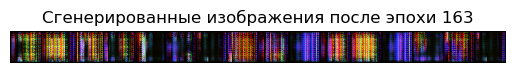

Эпоха [164/400] Шаг [100/322] D Loss: 1.0706, G Loss: 0.6167 D(x): 0.5245, D(G(z)): 0.3446 / 0.5403
Эпоха [164/400] Шаг [200/322] D Loss: 0.6160, G Loss: 0.4502 D(x): 0.6189, D(G(z)): 0.1265 / 0.6382
Эпоха [164/400] Шаг [300/322] D Loss: 1.6630, G Loss: 0.1668 D(x): 0.8680, D(G(z)): 0.7803 / 0.8468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


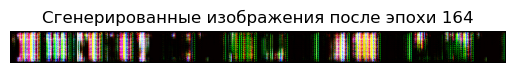

Эпоха [165/400] Шаг [100/322] D Loss: 2.0056, G Loss: 1.5537 D(x): 0.1944, D(G(z)): 0.3033 / 0.2136
Эпоха [165/400] Шаг [200/322] D Loss: 0.4622, G Loss: 0.1421 D(x): 0.8689, D(G(z)): 0.2748 / 0.8677
Эпоха [165/400] Шаг [300/322] D Loss: 1.2410, G Loss: 0.8841 D(x): 0.3764, D(G(z)): 0.2300 / 0.4142


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


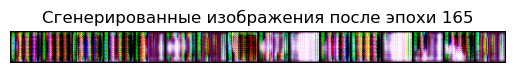

Эпоха [166/400] Шаг [100/322] D Loss: 0.9329, G Loss: 0.7090 D(x): 0.4799, D(G(z)): 0.1796 / 0.4927
Эпоха [166/400] Шаг [200/322] D Loss: 0.8791, G Loss: 0.3273 D(x): 0.7197, D(G(z)): 0.4216 / 0.7211
Эпоха [166/400] Шаг [300/322] D Loss: 1.3354, G Loss: 0.5124 D(x): 0.6008, D(G(z)): 0.5608 / 0.5994


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


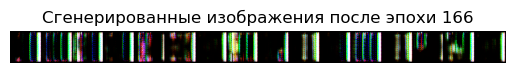

Эпоха [167/400] Шаг [100/322] D Loss: 1.8335, G Loss: 0.0880 D(x): 0.9327, D(G(z)): 0.8260 / 0.9164
Эпоха [167/400] Шаг [200/322] D Loss: 1.4467, G Loss: 0.5984 D(x): 0.5533, D(G(z)): 0.5740 / 0.5500
Эпоха [167/400] Шаг [300/322] D Loss: 1.5649, G Loss: 0.8806 D(x): 0.4137, D(G(z)): 0.4941 / 0.4148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


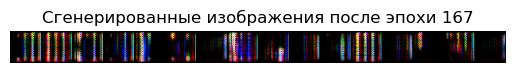

Эпоха [168/400] Шаг [100/322] D Loss: 1.1599, G Loss: 0.3928 D(x): 0.6947, D(G(z)): 0.5480 / 0.6755
Эпоха [168/400] Шаг [200/322] D Loss: 1.1439, G Loss: 0.6385 D(x): 0.5111, D(G(z)): 0.3747 / 0.5293
Эпоха [168/400] Шаг [300/322] D Loss: 1.1892, G Loss: 0.8321 D(x): 0.4126, D(G(z)): 0.2615 / 0.4356


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


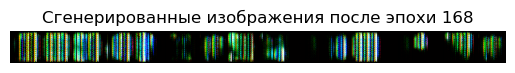

Эпоха [169/400] Шаг [100/322] D Loss: 1.9438, G Loss: 1.3464 D(x): 0.2514, D(G(z)): 0.4282 / 0.2605
Эпоха [169/400] Шаг [200/322] D Loss: 1.5178, G Loss: 0.1651 D(x): 0.8726, D(G(z)): 0.7464 / 0.8481
Эпоха [169/400] Шаг [300/322] D Loss: 1.2876, G Loss: 0.6594 D(x): 0.5174, D(G(z)): 0.4656 / 0.5175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


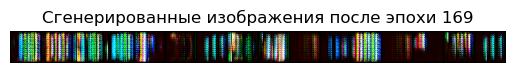

Эпоха [170/400] Шаг [100/322] D Loss: 0.7444, G Loss: 0.6550 D(x): 0.4996, D(G(z)): 0.0479 / 0.5196
Эпоха [170/400] Шаг [200/322] D Loss: 1.9076, G Loss: 0.1976 D(x): 0.8497, D(G(z)): 0.8243 / 0.8209
Эпоха [170/400] Шаг [300/322] D Loss: 1.2356, G Loss: 0.4131 D(x): 0.6634, D(G(z)): 0.5600 / 0.6619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


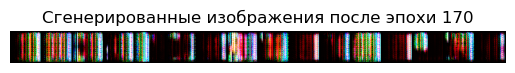

Эпоха [171/400] Шаг [100/322] D Loss: 1.5588, G Loss: 1.2983 D(x): 0.2599, D(G(z)): 0.1895 / 0.2740
Эпоха [171/400] Шаг [200/322] D Loss: 1.5988, G Loss: 0.7489 D(x): 0.4933, D(G(z)): 0.5861 / 0.4744
Эпоха [171/400] Шаг [300/322] D Loss: 1.5344, G Loss: 0.8755 D(x): 0.4089, D(G(z)): 0.4707 / 0.4170


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


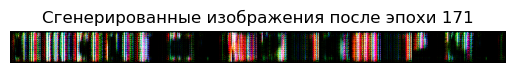

Эпоха [172/400] Шаг [100/322] D Loss: 0.6401, G Loss: 0.3462 D(x): 0.7018, D(G(z)): 0.2484 / 0.7076
Эпоха [172/400] Шаг [200/322] D Loss: 0.7765, G Loss: 0.5988 D(x): 0.5438, D(G(z)): 0.1529 / 0.5497
Эпоха [172/400] Шаг [300/322] D Loss: 0.7642, G Loss: 0.6196 D(x): 0.5337, D(G(z)): 0.1248 / 0.5389


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


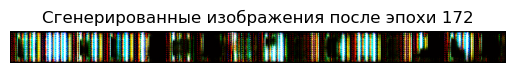

Эпоха [173/400] Шаг [100/322] D Loss: 0.3114, G Loss: 0.1135 D(x): 0.8872, D(G(z)): 0.1741 / 0.8928
Эпоха [173/400] Шаг [200/322] D Loss: 0.7318, G Loss: 0.4214 D(x): 0.6401, D(G(z)): 0.2477 / 0.6563
Эпоха [173/400] Шаг [300/322] D Loss: 1.9119, G Loss: 0.2129 D(x): 0.8267, D(G(z)): 0.8204 / 0.8083


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


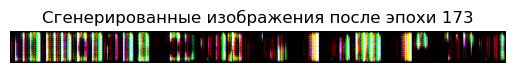

Эпоха [174/400] Шаг [100/322] D Loss: 0.7752, G Loss: 0.2920 D(x): 0.7504, D(G(z)): 0.3841 / 0.7469
Эпоха [174/400] Шаг [200/322] D Loss: 0.5666, G Loss: 0.1446 D(x): 0.8605, D(G(z)): 0.3386 / 0.8654
Эпоха [174/400] Шаг [300/322] D Loss: 1.2112, G Loss: 0.7021 D(x): 0.4945, D(G(z)): 0.3965 / 0.4959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


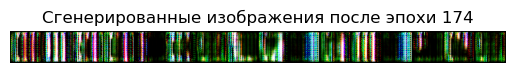

Эпоха [175/400] Шаг [100/322] D Loss: 0.5323, G Loss: 0.2144 D(x): 0.8135, D(G(z)): 0.2777 / 0.8072
Эпоха [175/400] Шаг [200/322] D Loss: 1.1403, G Loss: 0.4336 D(x): 0.6569, D(G(z)): 0.5116 / 0.6486
Эпоха [175/400] Шаг [300/322] D Loss: 0.8196, G Loss: 0.3371 D(x): 0.7147, D(G(z)): 0.3830 / 0.7139


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


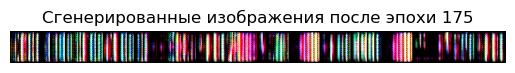

Эпоха [176/400] Шаг [100/322] D Loss: 0.9797, G Loss: 0.0615 D(x): 0.9432, D(G(z)): 0.6010 / 0.9404
Эпоха [176/400] Шаг [200/322] D Loss: 1.7833, G Loss: 0.4988 D(x): 0.6298, D(G(z)): 0.7302 / 0.6084
Эпоха [176/400] Шаг [300/322] D Loss: 0.5883, G Loss: 0.0863 D(x): 0.9186, D(G(z)): 0.3938 / 0.9174


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


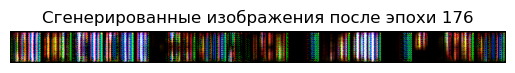

Эпоха [177/400] Шаг [100/322] D Loss: 0.8012, G Loss: 0.1496 D(x): 0.8609, D(G(z)): 0.4765 / 0.8612
Эпоха [177/400] Шаг [200/322] D Loss: 0.7763, G Loss: 0.3407 D(x): 0.7078, D(G(z)): 0.3489 / 0.7114
Эпоха [177/400] Шаг [300/322] D Loss: 1.0581, G Loss: 0.4656 D(x): 0.6207, D(G(z)): 0.4401 / 0.6280


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


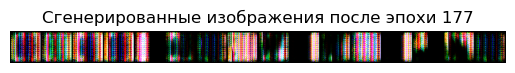

Эпоха [178/400] Шаг [100/322] D Loss: 1.1987, G Loss: 0.9225 D(x): 0.3769, D(G(z)): 0.1985 / 0.3980
Эпоха [178/400] Шаг [200/322] D Loss: 1.6508, G Loss: 0.7022 D(x): 0.4861, D(G(z)): 0.6026 / 0.4963
Эпоха [178/400] Шаг [300/322] D Loss: 0.7396, G Loss: 0.3012 D(x): 0.7325, D(G(z)): 0.3478 / 0.7401


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


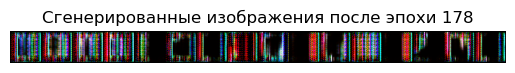

Эпоха [179/400] Шаг [100/322] D Loss: 0.8562, G Loss: 0.6862 D(x): 0.4705, D(G(z)): 0.0957 / 0.5044
Эпоха [179/400] Шаг [200/322] D Loss: 1.0043, G Loss: 0.3459 D(x): 0.7108, D(G(z)): 0.4837 / 0.7081
Эпоха [179/400] Шаг [300/322] D Loss: 1.5965, G Loss: 0.5215 D(x): 0.5971, D(G(z)): 0.6590 / 0.5941


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


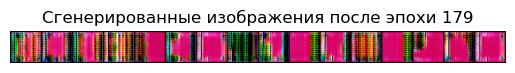

Эпоха [180/400] Шаг [100/322] D Loss: 1.4649, G Loss: 0.3740 D(x): 0.6941, D(G(z)): 0.6662 / 0.6882
Эпоха [180/400] Шаг [200/322] D Loss: 1.3053, G Loss: 0.4804 D(x): 0.6158, D(G(z)): 0.5577 / 0.6191
Эпоха [180/400] Шаг [300/322] D Loss: 1.2261, G Loss: 0.7301 D(x): 0.4696, D(G(z)): 0.3742 / 0.4828


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


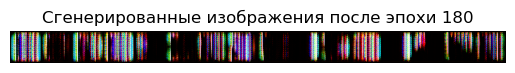

Эпоха [181/400] Шаг [100/322] D Loss: 0.7691, G Loss: 0.4415 D(x): 0.6272, D(G(z)): 0.2604 / 0.6437
Эпоха [181/400] Шаг [200/322] D Loss: 1.5307, G Loss: 1.2447 D(x): 0.2552, D(G(z)): 0.1473 / 0.2901
Эпоха [181/400] Шаг [300/322] D Loss: 0.8711, G Loss: 0.3472 D(x): 0.7093, D(G(z)): 0.4097 / 0.7069


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


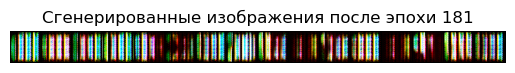

Эпоха [182/400] Шаг [100/322] D Loss: 1.1013, G Loss: 0.0671 D(x): 0.9419, D(G(z)): 0.6464 / 0.9351
Эпоха [182/400] Шаг [200/322] D Loss: 0.9184, G Loss: 0.6529 D(x): 0.4886, D(G(z)): 0.1814 / 0.5217
Эпоха [182/400] Шаг [300/322] D Loss: 0.9888, G Loss: 0.7425 D(x): 0.4522, D(G(z)): 0.1748 / 0.4763


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


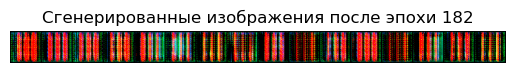

Эпоха [183/400] Шаг [100/322] D Loss: 0.7244, G Loss: 0.3690 D(x): 0.6897, D(G(z)): 0.2967 / 0.6916
Эпоха [183/400] Шаг [200/322] D Loss: 0.3595, G Loss: 0.1820 D(x): 0.8304, D(G(z)): 0.1588 / 0.8338
Эпоха [183/400] Шаг [300/322] D Loss: 1.4466, G Loss: 0.2271 D(x): 0.8009, D(G(z)): 0.6999 / 0.7969


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


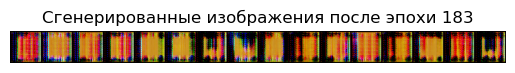

Эпоха [184/400] Шаг [100/322] D Loss: 1.6938, G Loss: 0.7552 D(x): 0.4736, D(G(z)): 0.6104 / 0.4703
Эпоха [184/400] Шаг [200/322] D Loss: 0.9840, G Loss: 0.7932 D(x): 0.4470, D(G(z)): 0.1619 / 0.4528
Эпоха [184/400] Шаг [300/322] D Loss: 0.5449, G Loss: 0.1970 D(x): 0.8160, D(G(z)): 0.2886 / 0.8213


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


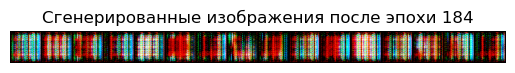

Эпоха [185/400] Шаг [100/322] D Loss: 1.7676, G Loss: 1.4776 D(x): 0.1989, D(G(z)): 0.1326 / 0.2309
Эпоха [185/400] Шаг [200/322] D Loss: 2.1619, G Loss: 1.0685 D(x): 0.3376, D(G(z)): 0.6581 / 0.3440
Эпоха [185/400] Шаг [300/322] D Loss: 1.5171, G Loss: 0.1164 D(x): 0.9002, D(G(z)): 0.7551 / 0.8902


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


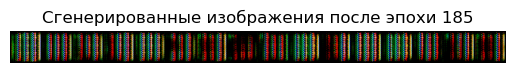

Эпоха [186/400] Шаг [100/322] D Loss: 0.4793, G Loss: 0.3925 D(x): 0.6606, D(G(z)): 0.0622 / 0.6756
Эпоха [186/400] Шаг [200/322] D Loss: 0.9377, G Loss: 0.1604 D(x): 0.8564, D(G(z)): 0.5422 / 0.8520
Эпоха [186/400] Шаг [300/322] D Loss: 2.2246, G Loss: 0.6499 D(x): 0.5284, D(G(z)): 0.7946 / 0.5225


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


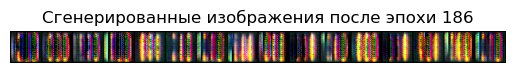

Эпоха [187/400] Шаг [100/322] D Loss: 1.5168, G Loss: 1.0946 D(x): 0.3255, D(G(z)): 0.3245 / 0.3358
Эпоха [187/400] Шаг [200/322] D Loss: 0.9042, G Loss: 0.4070 D(x): 0.6556, D(G(z)): 0.3762 / 0.6660
Эпоха [187/400] Шаг [300/322] D Loss: 0.4394, G Loss: 0.1191 D(x): 0.8874, D(G(z)): 0.2735 / 0.8877


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


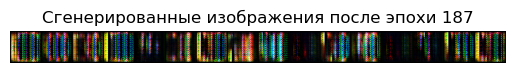

Эпоха [188/400] Шаг [100/322] D Loss: 0.6150, G Loss: 0.3916 D(x): 0.6625, D(G(z)): 0.1827 / 0.6766
Эпоха [188/400] Шаг [200/322] D Loss: 1.2276, G Loss: 0.3134 D(x): 0.7338, D(G(z)): 0.5968 / 0.7315
Эпоха [188/400] Шаг [300/322] D Loss: 1.0328, G Loss: 0.3987 D(x): 0.6693, D(G(z)): 0.4672 / 0.6716


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


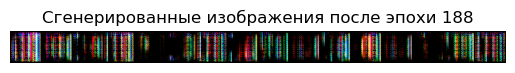

Эпоха [189/400] Шаг [100/322] D Loss: 1.7003, G Loss: 0.3418 D(x): 0.7152, D(G(z)): 0.7421 / 0.7110
Эпоха [189/400] Шаг [200/322] D Loss: 1.6548, G Loss: 1.1643 D(x): 0.2793, D(G(z)): 0.3141 / 0.3129
Эпоха [189/400] Шаг [300/322] D Loss: 1.5082, G Loss: 0.5681 D(x): 0.5681, D(G(z)): 0.6094 / 0.5674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


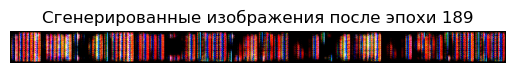

Эпоха [190/400] Шаг [100/322] D Loss: 0.9023, G Loss: 0.5594 D(x): 0.5528, D(G(z)): 0.2634 / 0.5723
Эпоха [190/400] Шаг [200/322] D Loss: 1.0982, G Loss: 0.3536 D(x): 0.7144, D(G(z)): 0.5329 / 0.7025
Эпоха [190/400] Шаг [300/322] D Loss: 0.9221, G Loss: 0.1418 D(x): 0.8754, D(G(z)): 0.5449 / 0.8680


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


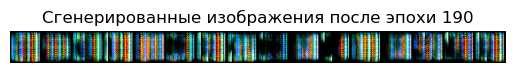

Эпоха [191/400] Шаг [100/322] D Loss: 1.4833, G Loss: 1.1304 D(x): 0.3104, D(G(z)): 0.2668 / 0.3244
Эпоха [191/400] Шаг [200/322] D Loss: 0.2685, G Loss: 0.0887 D(x): 0.9144, D(G(z)): 0.1634 / 0.9152
Эпоха [191/400] Шаг [300/322] D Loss: 0.2948, G Loss: 0.1316 D(x): 0.8716, D(G(z)): 0.1455 / 0.8768


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


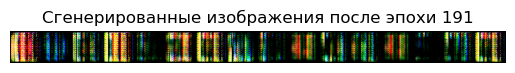

Эпоха [192/400] Шаг [100/322] D Loss: 1.7835, G Loss: 0.4751 D(x): 0.6323, D(G(z)): 0.7331 / 0.6220
Эпоха [192/400] Шаг [200/322] D Loss: 0.7769, G Loss: 0.4491 D(x): 0.6250, D(G(z)): 0.2635 / 0.6386
Эпоха [192/400] Шаг [300/322] D Loss: 1.3395, G Loss: 0.7506 D(x): 0.4651, D(G(z)): 0.4358 / 0.4723


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


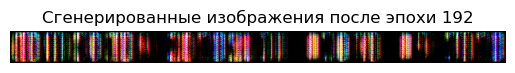

Эпоха [193/400] Шаг [100/322] D Loss: 1.1667, G Loss: 0.7337 D(x): 0.4817, D(G(z)): 0.3496 / 0.4822
Эпоха [193/400] Шаг [200/322] D Loss: 0.5059, G Loss: 0.2248 D(x): 0.7973, D(G(z)): 0.2430 / 0.7994
Эпоха [193/400] Шаг [300/322] D Loss: 0.9597, G Loss: 0.3848 D(x): 0.6852, D(G(z)): 0.4403 / 0.6807


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


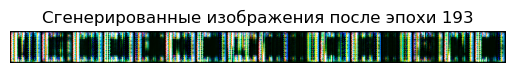

Эпоха [194/400] Шаг [100/322] D Loss: 1.4216, G Loss: 1.1350 D(x): 0.3035, D(G(z)): 0.2026 / 0.3219
Эпоха [194/400] Шаг [200/322] D Loss: 0.7403, G Loss: 0.3973 D(x): 0.6592, D(G(z)): 0.2749 / 0.6726
Эпоха [194/400] Шаг [300/322] D Loss: 1.6639, G Loss: 0.5971 D(x): 0.5569, D(G(z)): 0.6596 / 0.5510


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


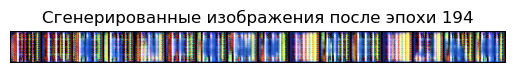

Эпоха [195/400] Шаг [100/322] D Loss: 1.5263, G Loss: 0.2848 D(x): 0.7669, D(G(z)): 0.7160 / 0.7523
Эпоха [195/400] Шаг [200/322] D Loss: 1.0379, G Loss: 0.8293 D(x): 0.4339, D(G(z)): 0.1827 / 0.4369
Эпоха [195/400] Шаг [300/322] D Loss: 1.1269, G Loss: 0.4568 D(x): 0.6337, D(G(z)): 0.4879 / 0.6337


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


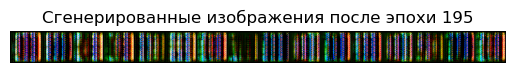

Эпоха [196/400] Шаг [100/322] D Loss: 1.3536, G Loss: 0.8289 D(x): 0.4214, D(G(z)): 0.3858 / 0.4380
Эпоха [196/400] Шаг [200/322] D Loss: 1.1056, G Loss: 0.8523 D(x): 0.4095, D(G(z)): 0.1909 / 0.4267
Эпоха [196/400] Шаг [300/322] D Loss: 2.7472, G Loss: 1.6215 D(x): 0.1882, D(G(z)): 0.6569 / 0.1998


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


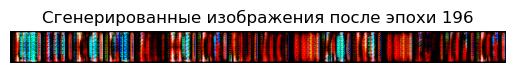

Эпоха [197/400] Шаг [100/322] D Loss: 1.2474, G Loss: 0.6852 D(x): 0.4950, D(G(z)): 0.4183 / 0.5042
Эпоха [197/400] Шаг [200/322] D Loss: 1.5385, G Loss: 1.0722 D(x): 0.2857, D(G(z)): 0.2443 / 0.3441
Эпоха [197/400] Шаг [300/322] D Loss: 1.5422, G Loss: 0.7996 D(x): 0.4414, D(G(z)): 0.5148 / 0.4498


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


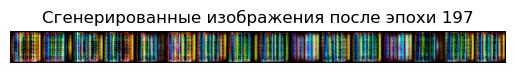

Эпоха [198/400] Шаг [100/322] D Loss: 1.7910, G Loss: 0.7852 D(x): 0.4573, D(G(z)): 0.6348 / 0.4563
Эпоха [198/400] Шаг [200/322] D Loss: 1.2438, G Loss: 0.6408 D(x): 0.5067, D(G(z)): 0.4288 / 0.5273
Эпоха [198/400] Шаг [300/322] D Loss: 0.3025, G Loss: 0.1498 D(x): 0.8530, D(G(z)): 0.1334 / 0.8610


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


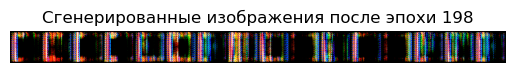

Эпоха [199/400] Шаг [100/322] D Loss: 0.7988, G Loss: 0.7121 D(x): 0.4663, D(G(z)): 0.0342 / 0.4924
Эпоха [199/400] Шаг [200/322] D Loss: 0.8021, G Loss: 0.6177 D(x): 0.5299, D(G(z)): 0.1530 / 0.5398
Эпоха [199/400] Шаг [300/322] D Loss: 2.2330, G Loss: 0.7900 D(x): 0.4775, D(G(z)): 0.7742 / 0.4549


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


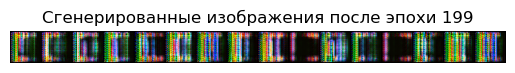

Эпоха [200/400] Шаг [100/322] D Loss: 0.5149, G Loss: 0.1465 D(x): 0.8663, D(G(z)): 0.3099 / 0.8638
Эпоха [200/400] Шаг [200/322] D Loss: 2.5140, G Loss: 1.7860 D(x): 0.1520, D(G(z)): 0.4600 / 0.1682
Эпоха [200/400] Шаг [300/322] D Loss: 0.3684, G Loss: 0.0751 D(x): 0.9268, D(G(z)): 0.2534 / 0.9277


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


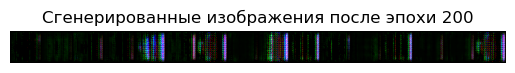

Эпоха [201/400] Шаг [100/322] D Loss: 0.5518, G Loss: 0.3758 D(x): 0.6788, D(G(z)): 0.1501 / 0.6876
Эпоха [201/400] Шаг [200/322] D Loss: 0.9829, G Loss: 0.6356 D(x): 0.5198, D(G(z)): 0.2783 / 0.5301
Эпоха [201/400] Шаг [300/322] D Loss: 1.8999, G Loss: 1.3717 D(x): 0.2363, D(G(z)): 0.3654 / 0.2552


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


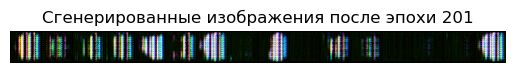

Эпоха [202/400] Шаг [100/322] D Loss: 0.5714, G Loss: 0.2448 D(x): 0.7740, D(G(z)): 0.2684 / 0.7832
Эпоха [202/400] Шаг [200/322] D Loss: 1.3746, G Loss: 0.2110 D(x): 0.8222, D(G(z)): 0.6918 / 0.8099
Эпоха [202/400] Шаг [300/322] D Loss: 2.0007, G Loss: 1.1532 D(x): 0.3024, D(G(z)): 0.5517 / 0.3163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


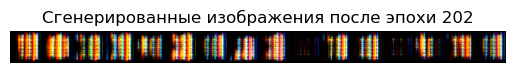

Эпоха [203/400] Шаг [100/322] D Loss: 1.8352, G Loss: 1.2006 D(x): 0.2793, D(G(z)): 0.4265 / 0.3022
Эпоха [203/400] Шаг [200/322] D Loss: 1.7505, G Loss: 1.4007 D(x): 0.2306, D(G(z)): 0.2454 / 0.2470
Эпоха [203/400] Шаг [300/322] D Loss: 0.7851, G Loss: 0.2233 D(x): 0.8025, D(G(z)): 0.4314 / 0.8000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


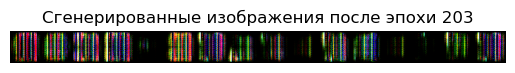

Эпоха [204/400] Шаг [100/322] D Loss: 0.2048, G Loss: 0.0956 D(x): 0.9133, D(G(z)): 0.1078 / 0.9089
Эпоха [204/400] Шаг [200/322] D Loss: 1.0562, G Loss: 0.6030 D(x): 0.5452, D(G(z)): 0.3615 / 0.5473
Эпоха [204/400] Шаг [300/322] D Loss: 0.8019, G Loss: 0.3980 D(x): 0.6579, D(G(z)): 0.3171 / 0.6719


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


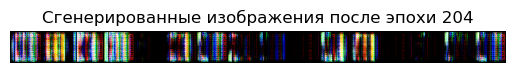

Эпоха [205/400] Шаг [100/322] D Loss: 0.2884, G Loss: 0.1847 D(x): 0.8335, D(G(z)): 0.1006 / 0.8315
Эпоха [205/400] Шаг [200/322] D Loss: 0.8276, G Loss: 0.1363 D(x): 0.8770, D(G(z)): 0.5008 / 0.8728
Эпоха [205/400] Шаг [300/322] D Loss: 0.8105, G Loss: 0.2174 D(x): 0.8160, D(G(z)): 0.4543 / 0.8049


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


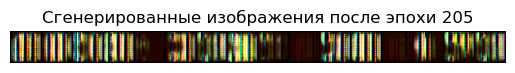

Эпоха [206/400] Шаг [100/322] D Loss: 0.8810, G Loss: 0.2380 D(x): 0.7996, D(G(z)): 0.4806 / 0.7891
Эпоха [206/400] Шаг [200/322] D Loss: 1.0087, G Loss: 0.1548 D(x): 0.8650, D(G(z)): 0.5779 / 0.8573
Эпоха [206/400] Шаг [300/322] D Loss: 3.0525, G Loss: 1.5945 D(x): 0.2028, D(G(z)): 0.7602 / 0.2042


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


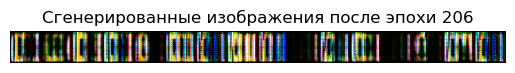

Эпоха [207/400] Шаг [100/322] D Loss: 0.8799, G Loss: 0.2930 D(x): 0.7408, D(G(z)): 0.4393 / 0.7463
Эпоха [207/400] Шаг [200/322] D Loss: 1.0834, G Loss: 0.5328 D(x): 0.5775, D(G(z)): 0.4099 / 0.5874
Эпоха [207/400] Шаг [300/322] D Loss: 1.6145, G Loss: 1.2644 D(x): 0.2527, D(G(z)): 0.2103 / 0.2840


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


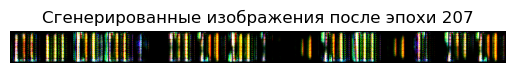

Эпоха [208/400] Шаг [100/322] D Loss: 1.3004, G Loss: 0.9627 D(x): 0.3638, D(G(z)): 0.2502 / 0.3828
Эпоха [208/400] Шаг [200/322] D Loss: 1.0365, G Loss: 0.3420 D(x): 0.7260, D(G(z)): 0.5082 / 0.7112
Эпоха [208/400] Шаг [300/322] D Loss: 0.8585, G Loss: 0.4985 D(x): 0.5980, D(G(z)): 0.2895 / 0.6077


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


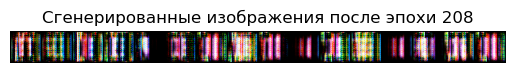

Эпоха [209/400] Шаг [100/322] D Loss: 0.8813, G Loss: 0.2434 D(x): 0.7832, D(G(z)): 0.4699 / 0.7841
Эпоха [209/400] Шаг [200/322] D Loss: 0.4561, G Loss: 0.2962 D(x): 0.7281, D(G(z)): 0.1270 / 0.7442
Эпоха [209/400] Шаг [300/322] D Loss: 1.3187, G Loss: 0.7691 D(x): 0.4450, D(G(z)): 0.3973 / 0.4642


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


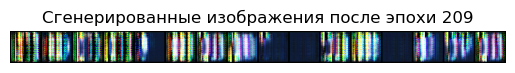

Эпоха [210/400] Шаг [100/322] D Loss: 1.1447, G Loss: 0.7127 D(x): 0.4816, D(G(z)): 0.3374 / 0.4909
Эпоха [210/400] Шаг [200/322] D Loss: 0.2973, G Loss: 0.1108 D(x): 0.8949, D(G(z)): 0.1695 / 0.8952
Эпоха [210/400] Шаг [300/322] D Loss: 1.4545, G Loss: 1.2155 D(x): 0.2643, D(G(z)): 0.1146 / 0.2982


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


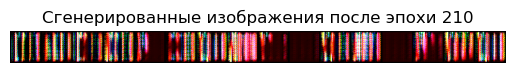

Эпоха [211/400] Шаг [100/322] D Loss: 1.0585, G Loss: 0.8679 D(x): 0.3951, D(G(z)): 0.1208 / 0.4207
Эпоха [211/400] Шаг [200/322] D Loss: 0.7752, G Loss: 0.4427 D(x): 0.6359, D(G(z)): 0.2736 / 0.6433
Эпоха [211/400] Шаг [300/322] D Loss: 0.7716, G Loss: 0.4182 D(x): 0.6465, D(G(z)): 0.2838 / 0.6588


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


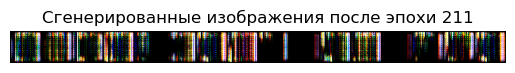

Эпоха [212/400] Шаг [100/322] D Loss: 0.8399, G Loss: 0.6651 D(x): 0.4980, D(G(z)): 0.1327 / 0.5146
Эпоха [212/400] Шаг [200/322] D Loss: 0.6932, G Loss: 0.5366 D(x): 0.5726, D(G(z)): 0.1259 / 0.5851
Эпоха [212/400] Шаг [300/322] D Loss: 2.0139, G Loss: 0.8478 D(x): 0.4315, D(G(z)): 0.6899 / 0.4287


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


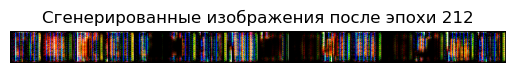

Эпоха [213/400] Шаг [100/322] D Loss: 0.6920, G Loss: 0.4972 D(x): 0.5924, D(G(z)): 0.1545 / 0.6085
Эпоха [213/400] Шаг [200/322] D Loss: 1.0496, G Loss: 0.3062 D(x): 0.7455, D(G(z)): 0.5300 / 0.7364
Эпоха [213/400] Шаг [300/322] D Loss: 0.5721, G Loss: 0.4325 D(x): 0.6333, D(G(z)): 0.1064 / 0.6497


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


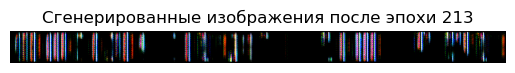

Эпоха [214/400] Шаг [100/322] D Loss: 0.8519, G Loss: 0.5497 D(x): 0.5599, D(G(z)): 0.2374 / 0.5777
Эпоха [214/400] Шаг [200/322] D Loss: 0.9683, G Loss: 0.5224 D(x): 0.5800, D(G(z)): 0.3448 / 0.5933
Эпоха [214/400] Шаг [300/322] D Loss: 0.5020, G Loss: 0.2341 D(x): 0.7916, D(G(z)): 0.2349 / 0.7914


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


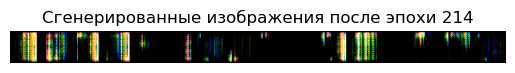

Эпоха [215/400] Шаг [100/322] D Loss: 2.1362, G Loss: 1.7236 D(x): 0.1586, D(G(z)): 0.2511 / 0.1791
Эпоха [215/400] Шаг [200/322] D Loss: 0.3468, G Loss: 0.1900 D(x): 0.8242, D(G(z)): 0.1420 / 0.8270
Эпоха [215/400] Шаг [300/322] D Loss: 0.8915, G Loss: 0.4123 D(x): 0.6523, D(G(z)): 0.3709 / 0.6623


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


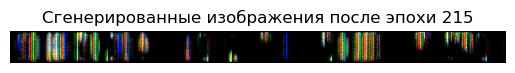

Эпоха [216/400] Шаг [100/322] D Loss: 0.3804, G Loss: 0.0758 D(x): 0.9291, D(G(z)): 0.2636 / 0.9271
Эпоха [216/400] Шаг [200/322] D Loss: 1.5450, G Loss: 1.2843 D(x): 0.2506, D(G(z)): 0.1469 / 0.2782
Эпоха [216/400] Шаг [300/322] D Loss: 0.4760, G Loss: 0.1894 D(x): 0.8252, D(G(z)): 0.2471 / 0.8275


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


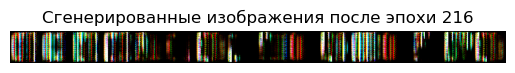

Эпоха [217/400] Шаг [100/322] D Loss: 1.4085, G Loss: 0.7512 D(x): 0.4627, D(G(z)): 0.4710 / 0.4720
Эпоха [217/400] Шаг [200/322] D Loss: 0.3741, G Loss: 0.1363 D(x): 0.8753, D(G(z)): 0.2137 / 0.8727
Эпоха [217/400] Шаг [300/322] D Loss: 0.8152, G Loss: 0.4144 D(x): 0.6663, D(G(z)): 0.3341 / 0.6612


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


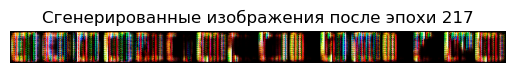

Эпоха [218/400] Шаг [100/322] D Loss: 1.2489, G Loss: 0.5620 D(x): 0.5716, D(G(z)): 0.4955 / 0.5706
Эпоха [218/400] Шаг [200/322] D Loss: 0.9551, G Loss: 0.1729 D(x): 0.8465, D(G(z)): 0.5443 / 0.8414
Эпоха [218/400] Шаг [300/322] D Loss: 1.1341, G Loss: 0.8733 D(x): 0.3977, D(G(z)): 0.1897 / 0.4184


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


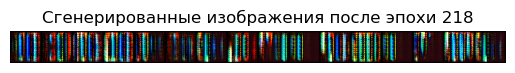

Эпоха [219/400] Шаг [100/322] D Loss: 1.2359, G Loss: 0.2780 D(x): 0.7631, D(G(z)): 0.6189 / 0.7577
Эпоха [219/400] Шаг [200/322] D Loss: 1.2330, G Loss: 0.3328 D(x): 0.7266, D(G(z)): 0.5984 / 0.7174
Эпоха [219/400] Шаг [300/322] D Loss: 0.3435, G Loss: 0.1395 D(x): 0.8658, D(G(z)): 0.1803 / 0.8699


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


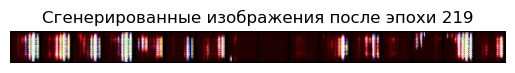

Эпоха [220/400] Шаг [100/322] D Loss: 0.2378, G Loss: 0.0568 D(x): 0.9453, D(G(z)): 0.1659 / 0.9449
Эпоха [220/400] Шаг [200/322] D Loss: 1.2823, G Loss: 0.8700 D(x): 0.4006, D(G(z)): 0.3061 / 0.4192
Эпоха [220/400] Шаг [300/322] D Loss: 1.5865, G Loss: 0.1508 D(x): 0.8775, D(G(z)): 0.7651 / 0.8601


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


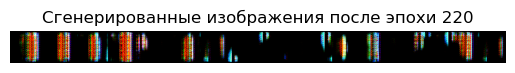

Эпоха [221/400] Шаг [100/322] D Loss: 0.4004, G Loss: 0.1028 D(x): 0.9060, D(G(z)): 0.2601 / 0.9024
Эпоха [221/400] Шаг [200/322] D Loss: 1.8891, G Loss: 1.2371 D(x): 0.2871, D(G(z)): 0.4709 / 0.2919
Эпоха [221/400] Шаг [300/322] D Loss: 2.4655, G Loss: 1.2479 D(x): 0.2774, D(G(z)): 0.6901 / 0.2887


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


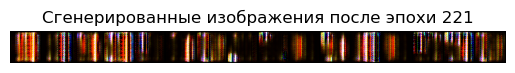

Эпоха [222/400] Шаг [100/322] D Loss: 0.6693, G Loss: 0.4394 D(x): 0.6317, D(G(z)): 0.1885 / 0.6447
Эпоха [222/400] Шаг [200/322] D Loss: 2.0200, G Loss: 1.3598 D(x): 0.2393, D(G(z)): 0.4444 / 0.2578
Эпоха [222/400] Шаг [300/322] D Loss: 0.6932, G Loss: 0.4364 D(x): 0.6364, D(G(z)): 0.2139 / 0.6469


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


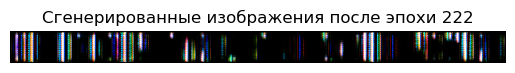

Эпоха [223/400] Шаг [100/322] D Loss: 1.7359, G Loss: 0.2734 D(x): 0.7866, D(G(z)): 0.7752 / 0.7613
Эпоха [223/400] Шаг [200/322] D Loss: 2.5429, G Loss: 2.1837 D(x): 0.1001, D(G(z)): 0.2077 / 0.1131
Эпоха [223/400] Шаг [300/322] D Loss: 2.0490, G Loss: 1.1525 D(x): 0.3078, D(G(z)): 0.5802 / 0.3171


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


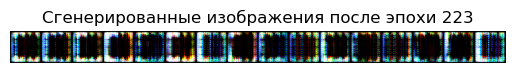

Эпоха [224/400] Шаг [100/322] D Loss: 0.5970, G Loss: 0.4498 D(x): 0.6250, D(G(z)): 0.1186 / 0.6379
Эпоха [224/400] Шаг [200/322] D Loss: 1.2649, G Loss: 0.1818 D(x): 0.8507, D(G(z)): 0.6648 / 0.8344
Эпоха [224/400] Шаг [300/322] D Loss: 0.7343, G Loss: 0.3509 D(x): 0.6913, D(G(z)): 0.3051 / 0.7044


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


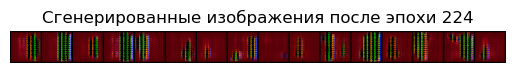

Эпоха [225/400] Шаг [100/322] D Loss: 1.9902, G Loss: 1.4462 D(x): 0.2242, D(G(z)): 0.3862 / 0.2362
Эпоха [225/400] Шаг [200/322] D Loss: 0.9935, G Loss: 0.5637 D(x): 0.5674, D(G(z)): 0.3461 / 0.5693
Эпоха [225/400] Шаг [300/322] D Loss: 1.4887, G Loss: 1.0371 D(x): 0.3461, D(G(z)): 0.3475 / 0.3554


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


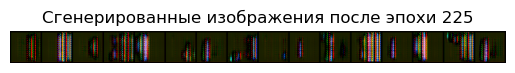

Эпоха [226/400] Шаг [100/322] D Loss: 0.5057, G Loss: 0.3609 D(x): 0.6807, D(G(z)): 0.1137 / 0.6973
Эпоха [226/400] Шаг [200/322] D Loss: 0.9110, G Loss: 0.7350 D(x): 0.4572, D(G(z)): 0.1194 / 0.4805
Эпоха [226/400] Шаг [300/322] D Loss: 0.8980, G Loss: 0.7228 D(x): 0.4704, D(G(z)): 0.1288 / 0.4857


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


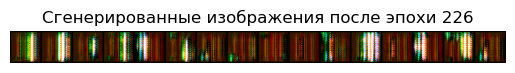

Эпоха [227/400] Шаг [100/322] D Loss: 1.2817, G Loss: 1.0525 D(x): 0.3210, D(G(z)): 0.1321 / 0.3518
Эпоха [227/400] Шаг [200/322] D Loss: 1.3471, G Loss: 0.9721 D(x): 0.3614, D(G(z)): 0.2775 / 0.3785
Эпоха [227/400] Шаг [300/322] D Loss: 0.6017, G Loss: 0.4349 D(x): 0.6414, D(G(z)): 0.1446 / 0.6478


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


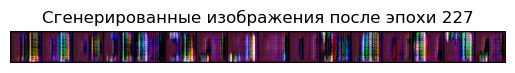

Эпоха [228/400] Шаг [100/322] D Loss: 0.6573, G Loss: 0.2161 D(x): 0.7991, D(G(z)): 0.3485 / 0.8059
Эпоха [228/400] Шаг [200/322] D Loss: 0.8242, G Loss: 0.3494 D(x): 0.6982, D(G(z)): 0.3704 / 0.7054
Эпоха [228/400] Шаг [300/322] D Loss: 1.8185, G Loss: 0.4616 D(x): 0.6477, D(G(z)): 0.7490 / 0.6312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


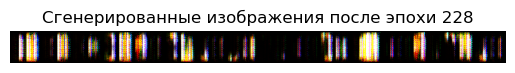

Эпоха [229/400] Шаг [100/322] D Loss: 1.5348, G Loss: 0.7606 D(x): 0.4599, D(G(z)): 0.5308 / 0.4681
Эпоха [229/400] Шаг [200/322] D Loss: 1.1374, G Loss: 0.6567 D(x): 0.5029, D(G(z)): 0.3600 / 0.5199
Эпоха [229/400] Шаг [300/322] D Loss: 0.3154, G Loss: 0.1288 D(x): 0.8789, D(G(z)): 0.1697 / 0.8792


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


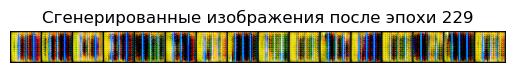

Эпоха [230/400] Шаг [100/322] D Loss: 1.5649, G Loss: 0.5182 D(x): 0.6065, D(G(z)): 0.6544 / 0.5958
Эпоха [230/400] Шаг [200/322] D Loss: 0.8185, G Loss: 0.3459 D(x): 0.7030, D(G(z)): 0.3716 / 0.7078
Эпоха [230/400] Шаг [300/322] D Loss: 0.3697, G Loss: 0.1060 D(x): 0.8990, D(G(z)): 0.2311 / 0.8996


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


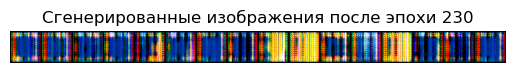

Эпоха [231/400] Шаг [100/322] D Loss: 1.8979, G Loss: 1.3615 D(x): 0.2420, D(G(z)): 0.3767 / 0.2577
Эпоха [231/400] Шаг [200/322] D Loss: 0.9689, G Loss: 0.6030 D(x): 0.5487, D(G(z)): 0.3040 / 0.5475
Эпоха [231/400] Шаг [300/322] D Loss: 0.7814, G Loss: 0.2406 D(x): 0.7595, D(G(z)): 0.3947 / 0.7889


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


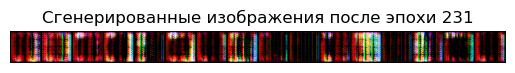

Эпоха [232/400] Шаг [100/322] D Loss: 1.6834, G Loss: 0.6799 D(x): 0.5175, D(G(z)): 0.6398 / 0.5071
Эпоха [232/400] Шаг [200/322] D Loss: 0.9903, G Loss: 0.3249 D(x): 0.7219, D(G(z)): 0.4842 / 0.7229
Эпоха [232/400] Шаг [300/322] D Loss: 0.9197, G Loss: 0.7071 D(x): 0.4690, D(G(z)): 0.1470 / 0.4946


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


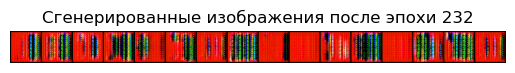

Эпоха [233/400] Шаг [100/322] D Loss: 0.9844, G Loss: 0.4871 D(x): 0.6100, D(G(z)): 0.3864 / 0.6146
Эпоха [233/400] Шаг [200/322] D Loss: 1.3426, G Loss: 0.6899 D(x): 0.4864, D(G(z)): 0.4622 / 0.5022
Эпоха [233/400] Шаг [300/322] D Loss: 1.0798, G Loss: 0.4355 D(x): 0.6536, D(G(z)): 0.4798 / 0.6471


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


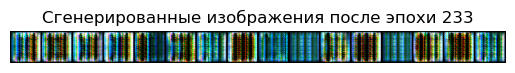

Эпоха [234/400] Шаг [100/322] D Loss: 0.8769, G Loss: 0.2515 D(x): 0.7821, D(G(z)): 0.4675 / 0.7783
Эпоха [234/400] Шаг [200/322] D Loss: 0.6807, G Loss: 0.4357 D(x): 0.6366, D(G(z)): 0.2042 / 0.6470
Эпоха [234/400] Шаг [300/322] D Loss: 0.4354, G Loss: 0.3067 D(x): 0.7231, D(G(z)): 0.1039 / 0.7367


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


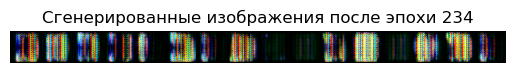

Эпоха [235/400] Шаг [100/322] D Loss: 1.6605, G Loss: 0.7194 D(x): 0.4947, D(G(z)): 0.6151 / 0.4879
Эпоха [235/400] Шаг [200/322] D Loss: 1.3878, G Loss: 0.8223 D(x): 0.4232, D(G(z)): 0.4087 / 0.4399
Эпоха [235/400] Шаг [300/322] D Loss: 0.2905, G Loss: 0.0634 D(x): 0.9386, D(G(z)): 0.2032 / 0.9386


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


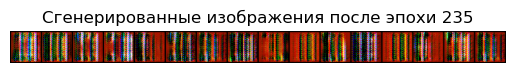

Эпоха [236/400] Шаг [100/322] D Loss: 1.4256, G Loss: 0.8003 D(x): 0.4462, D(G(z)): 0.4597 / 0.4494
Эпоха [236/400] Шаг [200/322] D Loss: 1.2696, G Loss: 0.6504 D(x): 0.5008, D(G(z)): 0.4377 / 0.5226
Эпоха [236/400] Шаг [300/322] D Loss: 0.7391, G Loss: 0.4039 D(x): 0.6580, D(G(z)): 0.2738 / 0.6683


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


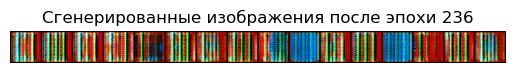

Эпоха [237/400] Шаг [100/322] D Loss: 1.2114, G Loss: 0.0704 D(x): 0.9374, D(G(z)): 0.6813 / 0.9321
Эпоха [237/400] Шаг [200/322] D Loss: 1.3936, G Loss: 0.2675 D(x): 0.7735, D(G(z)): 0.6785 / 0.7656
Эпоха [237/400] Шаг [300/322] D Loss: 0.7038, G Loss: 0.4538 D(x): 0.6235, D(G(z)): 0.2062 / 0.6355


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


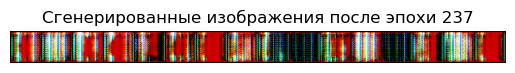

Эпоха [238/400] Шаг [100/322] D Loss: 1.1801, G Loss: 0.1943 D(x): 0.8324, D(G(z)): 0.6292 / 0.8237
Эпоха [238/400] Шаг [200/322] D Loss: 0.5670, G Loss: 0.3188 D(x): 0.7144, D(G(z)): 0.2051 / 0.7274
Эпоха [238/400] Шаг [300/322] D Loss: 0.8772, G Loss: 0.5491 D(x): 0.5570, D(G(z)): 0.2523 / 0.5781


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


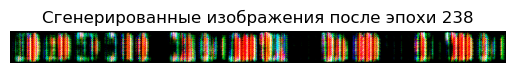

Эпоха [239/400] Шаг [100/322] D Loss: 0.4492, G Loss: 0.0250 D(x): 0.9766, D(G(z)): 0.3459 / 0.9753
Эпоха [239/400] Шаг [200/322] D Loss: 1.4058, G Loss: 0.3625 D(x): 0.7084, D(G(z)): 0.6533 / 0.6973
Эпоха [239/400] Шаг [300/322] D Loss: 0.2788, G Loss: 0.1143 D(x): 0.8927, D(G(z)): 0.1520 / 0.8921


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


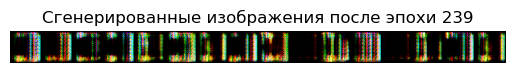

Эпоха [240/400] Шаг [100/322] D Loss: 1.2328, G Loss: 0.2508 D(x): 0.7873, D(G(z)): 0.6290 / 0.7783
Эпоха [240/400] Шаг [200/322] D Loss: 1.8695, G Loss: 1.0985 D(x): 0.3211, D(G(z)): 0.5187 / 0.3337
Эпоха [240/400] Шаг [300/322] D Loss: 0.7336, G Loss: 0.1544 D(x): 0.8603, D(G(z)): 0.4415 / 0.8572


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


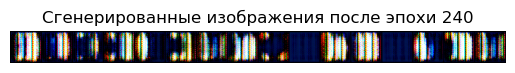

Эпоха [241/400] Шаг [100/322] D Loss: 0.6956, G Loss: 0.1205 D(x): 0.8873, D(G(z)): 0.4375 / 0.8865
Эпоха [241/400] Шаг [200/322] D Loss: 1.5472, G Loss: 0.6651 D(x): 0.5171, D(G(z)): 0.5880 / 0.5143
Эпоха [241/400] Шаг [300/322] D Loss: 0.7424, G Loss: 0.1605 D(x): 0.8536, D(G(z)): 0.4422 / 0.8518


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


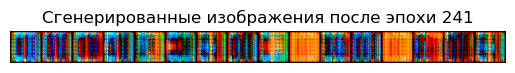

Эпоха [242/400] Шаг [100/322] D Loss: 1.3528, G Loss: 0.9128 D(x): 0.3879, D(G(z)): 0.3322 / 0.4017
Эпоха [242/400] Шаг [200/322] D Loss: 0.7843, G Loss: 0.3219 D(x): 0.7172, D(G(z)): 0.3634 / 0.7250
Эпоха [242/400] Шаг [300/322] D Loss: 0.3688, G Loss: 0.2107 D(x): 0.8036, D(G(z)): 0.1393 / 0.8101


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


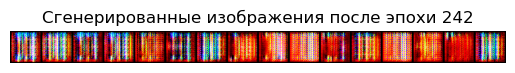

Эпоха [243/400] Шаг [100/322] D Loss: 1.2705, G Loss: 0.4062 D(x): 0.6685, D(G(z)): 0.5797 / 0.6664
Эпоха [243/400] Шаг [200/322] D Loss: 0.8228, G Loss: 0.6162 D(x): 0.5314, D(G(z)): 0.1725 / 0.5402
Эпоха [243/400] Шаг [300/322] D Loss: 1.5586, G Loss: 0.9284 D(x): 0.3945, D(G(z)): 0.4600 / 0.3959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


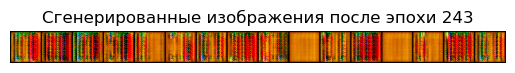

Эпоха [244/400] Шаг [100/322] D Loss: 0.9627, G Loss: 0.2506 D(x): 0.7813, D(G(z)): 0.5106 / 0.7785
Эпоха [244/400] Шаг [200/322] D Loss: 1.4253, G Loss: 0.7128 D(x): 0.4760, D(G(z)): 0.4942 / 0.4907
Эпоха [244/400] Шаг [300/322] D Loss: 3.0258, G Loss: 2.2569 D(x): 0.0964, D(G(z)): 0.4710 / 0.1065


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


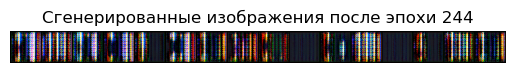

Эпоха [245/400] Шаг [100/322] D Loss: 0.9750, G Loss: 0.1991 D(x): 0.8283, D(G(z)): 0.5437 / 0.8204
Эпоха [245/400] Шаг [200/322] D Loss: 0.8287, G Loss: 0.3605 D(x): 0.6957, D(G(z)): 0.3720 / 0.6976
Эпоха [245/400] Шаг [300/322] D Loss: 1.1719, G Loss: 0.2715 D(x): 0.7615, D(G(z)): 0.5912 / 0.7625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


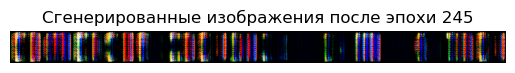

Эпоха [246/400] Шаг [100/322] D Loss: 1.5136, G Loss: 0.6464 D(x): 0.5206, D(G(z)): 0.5761 / 0.5243
Эпоха [246/400] Шаг [200/322] D Loss: 0.5280, G Loss: 0.1618 D(x): 0.8478, D(G(z)): 0.3036 / 0.8511
Эпоха [246/400] Шаг [300/322] D Loss: 0.7812, G Loss: 0.3430 D(x): 0.7062, D(G(z)): 0.3501 / 0.7099


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


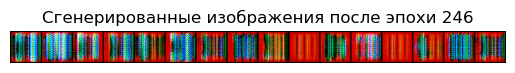

Эпоха [247/400] Шаг [100/322] D Loss: 1.1440, G Loss: 0.7097 D(x): 0.4740, D(G(z)): 0.3252 / 0.4925
Эпоха [247/400] Шаг [200/322] D Loss: 0.9566, G Loss: 0.3828 D(x): 0.6839, D(G(z)): 0.4371 / 0.6822
Эпоха [247/400] Шаг [300/322] D Loss: 1.6468, G Loss: 0.2902 D(x): 0.7549, D(G(z)): 0.7442 / 0.7483


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


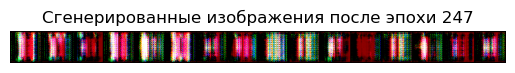

Эпоха [248/400] Шаг [100/322] D Loss: 0.9194, G Loss: 0.4843 D(x): 0.6098, D(G(z)): 0.3458 / 0.6164
Эпоха [248/400] Шаг [200/322] D Loss: 0.5932, G Loss: 0.2599 D(x): 0.7716, D(G(z)): 0.2834 / 0.7713
Эпоха [248/400] Шаг [300/322] D Loss: 1.6527, G Loss: 0.5217 D(x): 0.6064, D(G(z)): 0.6831 / 0.5939


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


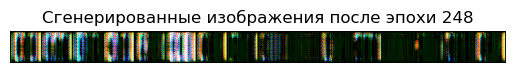

Эпоха [249/400] Шаг [100/322] D Loss: 0.3423, G Loss: 0.2017 D(x): 0.8139, D(G(z)): 0.1254 / 0.8182
Эпоха [249/400] Шаг [200/322] D Loss: 1.3721, G Loss: 0.8535 D(x): 0.4181, D(G(z)): 0.3921 / 0.4271
Эпоха [249/400] Шаг [300/322] D Loss: 1.0418, G Loss: 0.3064 D(x): 0.7463, D(G(z)): 0.5269 / 0.7363


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


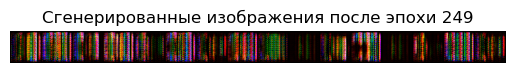

Эпоха [250/400] Шаг [100/322] D Loss: 1.1029, G Loss: 0.9461 D(x): 0.3715, D(G(z)): 0.1052 / 0.3887
Эпоха [250/400] Шаг [200/322] D Loss: 1.3257, G Loss: 0.3579 D(x): 0.7056, D(G(z)): 0.6221 / 0.6995
Эпоха [250/400] Шаг [300/322] D Loss: 0.8256, G Loss: 0.7046 D(x): 0.4812, D(G(z)): 0.0893 / 0.4946


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


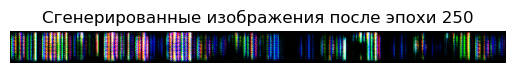

Эпоха [251/400] Шаг [100/322] D Loss: 0.1849, G Loss: 0.1670 D(x): 0.8450, D(G(z)): 0.0161 / 0.8463
Эпоха [251/400] Шаг [200/322] D Loss: 0.2690, G Loss: 0.0428 D(x): 0.9581, D(G(z)): 0.2022 / 0.9581
Эпоха [251/400] Шаг [300/322] D Loss: 0.7580, G Loss: 0.3737 D(x): 0.6797, D(G(z)): 0.3101 / 0.6883


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


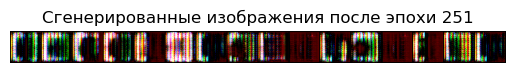

Эпоха [252/400] Шаг [100/322] D Loss: 2.1057, G Loss: 0.9896 D(x): 0.3700, D(G(z)): 0.6684 / 0.3720
Эпоха [252/400] Шаг [200/322] D Loss: 0.6392, G Loss: 0.5442 D(x): 0.5571, D(G(z)): 0.0516 / 0.5811
Эпоха [252/400] Шаг [300/322] D Loss: 0.6085, G Loss: 0.4038 D(x): 0.6590, D(G(z)): 0.1731 / 0.6682


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


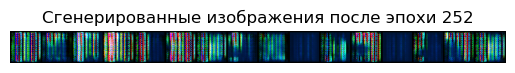

Эпоха [253/400] Шаг [100/322] D Loss: 1.4014, G Loss: 0.9815 D(x): 0.3574, D(G(z)): 0.3098 / 0.3752
Эпоха [253/400] Шаг [200/322] D Loss: 1.2439, G Loss: 0.7102 D(x): 0.4711, D(G(z)): 0.3857 / 0.4926
Эпоха [253/400] Шаг [300/322] D Loss: 3.2486, G Loss: 1.2827 D(x): 0.2782, D(G(z)): 0.8588 / 0.2792


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


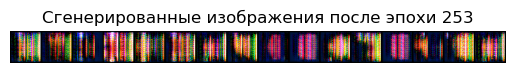

Эпоха [254/400] Шаг [100/322] D Loss: 0.7679, G Loss: 0.5372 D(x): 0.5743, D(G(z)): 0.1915 / 0.5848
Эпоха [254/400] Шаг [200/322] D Loss: 1.0630, G Loss: 0.3838 D(x): 0.6786, D(G(z)): 0.4894 / 0.6814
Эпоха [254/400] Шаг [300/322] D Loss: 0.6721, G Loss: 0.3326 D(x): 0.7125, D(G(z)): 0.2831 / 0.7172


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


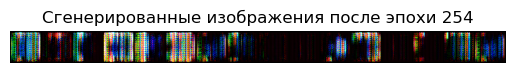

Эпоха [255/400] Шаг [100/322] D Loss: 0.3503, G Loss: 0.1536 D(x): 0.8556, D(G(z)): 0.1758 / 0.8581
Эпоха [255/400] Шаг [200/322] D Loss: 1.3880, G Loss: 0.9685 D(x): 0.3603, D(G(z)): 0.3061 / 0.3806
Эпоха [255/400] Шаг [300/322] D Loss: 0.8700, G Loss: 0.2933 D(x): 0.7587, D(G(z)): 0.4465 / 0.7461


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


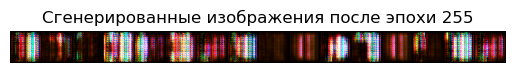

Эпоха [256/400] Шаг [100/322] D Loss: 1.2895, G Loss: 0.9870 D(x): 0.3544, D(G(z)): 0.2219 / 0.3741
Эпоха [256/400] Шаг [200/322] D Loss: 1.3658, G Loss: 0.6598 D(x): 0.5134, D(G(z)): 0.5015 / 0.5171
Эпоха [256/400] Шаг [300/322] D Loss: 1.7696, G Loss: 1.3336 D(x): 0.2466, D(G(z)): 0.3068 / 0.2648


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


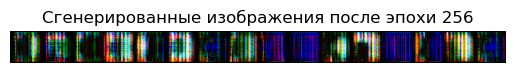

Эпоха [257/400] Шаг [100/322] D Loss: 1.7399, G Loss: 1.4028 D(x): 0.2266, D(G(z)): 0.2232 / 0.2483
Эпоха [257/400] Шаг [200/322] D Loss: 1.2305, G Loss: 0.7678 D(x): 0.4456, D(G(z)): 0.3403 / 0.4646
Эпоха [257/400] Шаг [300/322] D Loss: 1.1017, G Loss: 0.7466 D(x): 0.4593, D(G(z)): 0.2753 / 0.4754


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


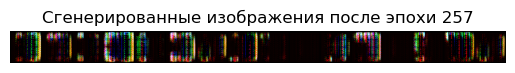

Эпоха [258/400] Шаг [100/322] D Loss: 0.3552, G Loss: 0.0598 D(x): 0.9419, D(G(z)): 0.2555 / 0.9420
Эпоха [258/400] Шаг [200/322] D Loss: 0.8415, G Loss: 0.4960 D(x): 0.6117, D(G(z)): 0.2944 / 0.6091
Эпоха [258/400] Шаг [300/322] D Loss: 0.7967, G Loss: 0.4637 D(x): 0.6120, D(G(z)): 0.2628 / 0.6294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


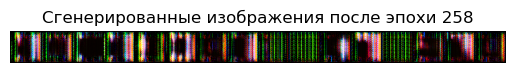

Эпоха [259/400] Шаг [100/322] D Loss: 0.9119, G Loss: 0.7798 D(x): 0.4257, D(G(z)): 0.0548 / 0.4600
Эпоха [259/400] Шаг [200/322] D Loss: 1.9420, G Loss: 1.6293 D(x): 0.1818, D(G(z)): 0.2067 / 0.1966
Эпоха [259/400] Шаг [300/322] D Loss: 1.3083, G Loss: 0.2852 D(x): 0.7601, D(G(z)): 0.6442 / 0.7520


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


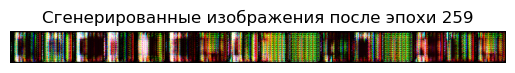

Эпоха [260/400] Шаг [100/322] D Loss: 0.7198, G Loss: 0.3236 D(x): 0.7251, D(G(z)): 0.3281 / 0.7237
Эпоха [260/400] Шаг [200/322] D Loss: 0.7794, G Loss: 0.1807 D(x): 0.8337, D(G(z)): 0.4495 / 0.8348
Эпоха [260/400] Шаг [300/322] D Loss: 2.0098, G Loss: 1.6105 D(x): 0.1792, D(G(z)): 0.2510 / 0.2008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


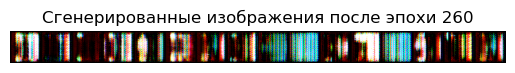

Эпоха [261/400] Шаг [100/322] D Loss: 1.9871, G Loss: 0.5466 D(x): 0.5829, D(G(z)): 0.7631 / 0.5791
Эпоха [261/400] Шаг [200/322] D Loss: 1.6613, G Loss: 0.1227 D(x): 0.8960, D(G(z)): 0.7869 / 0.8846
Эпоха [261/400] Шаг [300/322] D Loss: 0.5855, G Loss: 0.1626 D(x): 0.8552, D(G(z)): 0.3485 / 0.8502


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


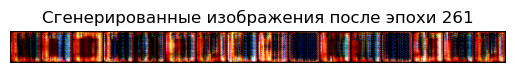

Эпоха [262/400] Шаг [100/322] D Loss: 1.4500, G Loss: 0.9847 D(x): 0.3679, D(G(z)): 0.3590 / 0.3744
Эпоха [262/400] Шаг [200/322] D Loss: 1.9243, G Loss: 0.3466 D(x): 0.7198, D(G(z)): 0.7967 / 0.7073
Эпоха [262/400] Шаг [300/322] D Loss: 0.7102, G Loss: 0.5560 D(x): 0.5699, D(G(z)): 0.1365 / 0.5740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


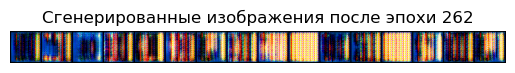

Эпоха [263/400] Шаг [100/322] D Loss: 1.6458, G Loss: 1.1523 D(x): 0.3015, D(G(z)): 0.3581 / 0.3167
Эпоха [263/400] Шаг [200/322] D Loss: 0.4430, G Loss: 0.1586 D(x): 0.8587, D(G(z)): 0.2514 / 0.8536
Эпоха [263/400] Шаг [300/322] D Loss: 1.9518, G Loss: 1.2201 D(x): 0.2835, D(G(z)): 0.4962 / 0.2965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


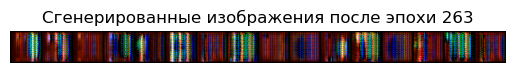

Эпоха [264/400] Шаг [100/322] D Loss: 1.6738, G Loss: 0.9434 D(x): 0.3819, D(G(z)): 0.5073 / 0.3898
Эпоха [264/400] Шаг [200/322] D Loss: 2.0999, G Loss: 0.8925 D(x): 0.4086, D(G(z)): 0.6998 / 0.4098
Эпоха [264/400] Шаг [300/322] D Loss: 0.8429, G Loss: 0.6983 D(x): 0.4790, D(G(z)): 0.0989 / 0.4978


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


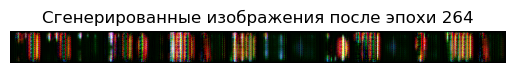

Эпоха [265/400] Шаг [100/322] D Loss: 0.4859, G Loss: 0.3947 D(x): 0.6625, D(G(z)): 0.0705 / 0.6745
Эпоха [265/400] Шаг [200/322] D Loss: 1.3419, G Loss: 1.0706 D(x): 0.3281, D(G(z)): 0.2017 / 0.3436
Эпоха [265/400] Шаг [300/322] D Loss: 0.3058, G Loss: 0.2242 D(x): 0.7990, D(G(z)): 0.0781 / 0.7992


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


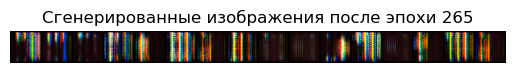

Эпоха [266/400] Шаг [100/322] D Loss: 1.3037, G Loss: 0.9779 D(x): 0.3601, D(G(z)): 0.2452 / 0.3766
Эпоха [266/400] Шаг [200/322] D Loss: 1.2868, G Loss: 0.6891 D(x): 0.4979, D(G(z)): 0.4445 / 0.5024
Эпоха [266/400] Шаг [300/322] D Loss: 1.0375, G Loss: 0.5776 D(x): 0.5436, D(G(z)): 0.3460 / 0.5623


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


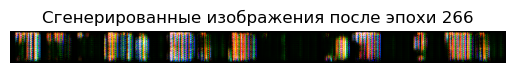

Эпоха [267/400] Шаг [100/322] D Loss: 0.8317, G Loss: 0.4148 D(x): 0.6618, D(G(z)): 0.3421 / 0.6606
Эпоха [267/400] Шаг [200/322] D Loss: 0.9762, G Loss: 0.5380 D(x): 0.5770, D(G(z)): 0.3446 / 0.5844
Эпоха [267/400] Шаг [300/322] D Loss: 0.5365, G Loss: 0.2246 D(x): 0.7983, D(G(z)): 0.2664 / 0.7989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


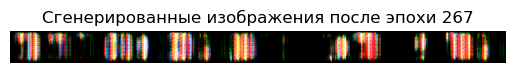

Эпоха [268/400] Шаг [100/322] D Loss: 1.2753, G Loss: 0.7388 D(x): 0.4708, D(G(z)): 0.4054 / 0.4787
Эпоха [268/400] Шаг [200/322] D Loss: 0.7927, G Loss: 0.1887 D(x): 0.8293, D(G(z)): 0.4538 / 0.8282
Эпоха [268/400] Шаг [300/322] D Loss: 1.4960, G Loss: 0.7355 D(x): 0.4719, D(G(z)): 0.5246 / 0.4799


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


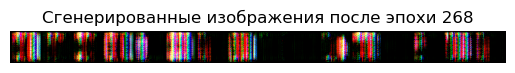

Эпоха [269/400] Шаг [100/322] D Loss: 1.0468, G Loss: 0.8852 D(x): 0.3936, D(G(z)): 0.1039 / 0.4135
Эпоха [269/400] Шаг [200/322] D Loss: 0.9251, G Loss: 0.7620 D(x): 0.4506, D(G(z)): 0.1193 / 0.4677
Эпоха [269/400] Шаг [300/322] D Loss: 2.4821, G Loss: 1.2162 D(x): 0.2923, D(G(z)): 0.7137 / 0.2965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


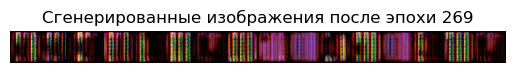

Эпоха [270/400] Шаг [100/322] D Loss: 0.4543, G Loss: 0.3226 D(x): 0.7155, D(G(z)): 0.1118 / 0.7243
Эпоха [270/400] Шаг [200/322] D Loss: 0.3954, G Loss: 0.1987 D(x): 0.8204, D(G(z)): 0.1789 / 0.8199
Эпоха [270/400] Шаг [300/322] D Loss: 1.3761, G Loss: 0.2782 D(x): 0.7671, D(G(z)): 0.6694 / 0.7575


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


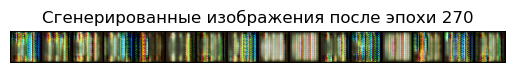

Эпоха [271/400] Шаг [100/322] D Loss: 1.2258, G Loss: 0.4948 D(x): 0.6148, D(G(z)): 0.5215 / 0.6099
Эпоха [271/400] Шаг [200/322] D Loss: 1.7486, G Loss: 1.1310 D(x): 0.3108, D(G(z)): 0.4378 / 0.3232
Эпоха [271/400] Шаг [300/322] D Loss: 2.8353, G Loss: 1.3209 D(x): 0.2610, D(G(z)): 0.7737 / 0.2673


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


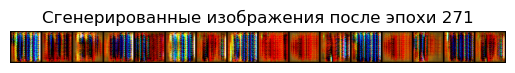

Эпоха [272/400] Шаг [100/322] D Loss: 2.0524, G Loss: 0.2856 D(x): 0.7653, D(G(z)): 0.8318 / 0.7524
Эпоха [272/400] Шаг [200/322] D Loss: 0.9744, G Loss: 0.1594 D(x): 0.8608, D(G(z)): 0.5611 / 0.8528
Эпоха [272/400] Шаг [300/322] D Loss: 1.7427, G Loss: 0.7147 D(x): 0.4900, D(G(z)): 0.6421 / 0.4897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


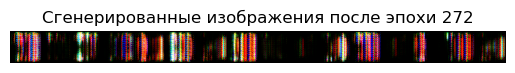

Эпоха [273/400] Шаг [100/322] D Loss: 0.6562, G Loss: 0.1794 D(x): 0.8378, D(G(z)): 0.3805 / 0.8358
Эпоха [273/400] Шаг [200/322] D Loss: 1.1856, G Loss: 0.9535 D(x): 0.3595, D(G(z)): 0.1464 / 0.3875
Эпоха [273/400] Шаг [300/322] D Loss: 0.4913, G Loss: 0.1277 D(x): 0.8786, D(G(z)): 0.3024 / 0.8802


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


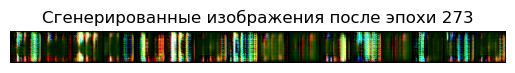

Эпоха [274/400] Шаг [100/322] D Loss: 1.0186, G Loss: 0.7020 D(x): 0.4678, D(G(z)): 0.2249 / 0.4960
Эпоха [274/400] Шаг [200/322] D Loss: 1.7693, G Loss: 0.6938 D(x): 0.4986, D(G(z)): 0.6548 / 0.4999
Эпоха [274/400] Шаг [300/322] D Loss: 0.8190, G Loss: 0.4763 D(x): 0.6192, D(G(z)): 0.2877 / 0.6212


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


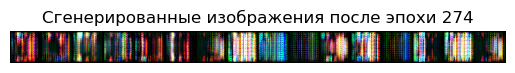

Эпоха [275/400] Шаг [100/322] D Loss: 0.2127, G Loss: 0.0986 D(x): 0.9057, D(G(z)): 0.1073 / 0.9062
Эпоха [275/400] Шаг [200/322] D Loss: 0.8752, G Loss: 0.3317 D(x): 0.7151, D(G(z)): 0.4163 / 0.7179
Эпоха [275/400] Шаг [300/322] D Loss: 2.0099, G Loss: 0.5091 D(x): 0.6127, D(G(z)): 0.7810 / 0.6017


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


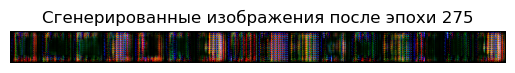

Эпоха [276/400] Шаг [100/322] D Loss: 0.3994, G Loss: 0.2558 D(x): 0.7644, D(G(z)): 0.1218 / 0.7746
Эпоха [276/400] Шаг [200/322] D Loss: 0.4825, G Loss: 0.2710 D(x): 0.7556, D(G(z)): 0.1827 / 0.7629
Эпоха [276/400] Шаг [300/322] D Loss: 0.7920, G Loss: 0.0547 D(x): 0.9479, D(G(z)): 0.5206 / 0.9468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


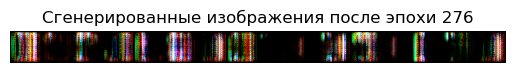

Эпоха [277/400] Шаг [100/322] D Loss: 1.0618, G Loss: 0.6227 D(x): 0.5132, D(G(z)): 0.3246 / 0.5373
Эпоха [277/400] Шаг [200/322] D Loss: 1.3616, G Loss: 1.1952 D(x): 0.2753, D(G(z)): 0.0665 / 0.3038
Эпоха [277/400] Шаг [300/322] D Loss: 1.5444, G Loss: 1.4093 D(x): 0.2251, D(G(z)): 0.0475 / 0.2446


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


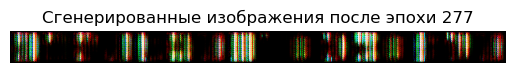

Эпоха [278/400] Шаг [100/322] D Loss: 1.4704, G Loss: 0.3246 D(x): 0.7340, D(G(z)): 0.6861 / 0.7242
Эпоха [278/400] Шаг [200/322] D Loss: 0.6404, G Loss: 0.2767 D(x): 0.7485, D(G(z)): 0.2954 / 0.7584
Эпоха [278/400] Шаг [300/322] D Loss: 2.0419, G Loss: 1.6172 D(x): 0.1873, D(G(z)): 0.3029 / 0.1988


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


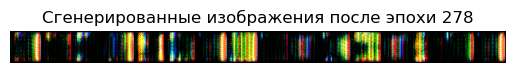

Эпоха [279/400] Шаг [100/322] D Loss: 2.2598, G Loss: 1.3834 D(x): 0.2419, D(G(z)): 0.5673 / 0.2511
Эпоха [279/400] Шаг [200/322] D Loss: 0.6274, G Loss: 0.1781 D(x): 0.8390, D(G(z)): 0.3625 / 0.8369
Эпоха [279/400] Шаг [300/322] D Loss: 1.6786, G Loss: 0.5189 D(x): 0.6052, D(G(z)): 0.6911 / 0.5956


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


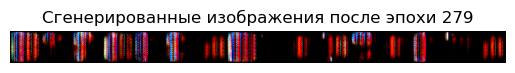

Эпоха [280/400] Шаг [100/322] D Loss: 1.3644, G Loss: 0.7193 D(x): 0.4838, D(G(z)): 0.4712 / 0.4881
Эпоха [280/400] Шаг [200/322] D Loss: 1.4482, G Loss: 0.7184 D(x): 0.4884, D(G(z)): 0.5182 / 0.4876
Эпоха [280/400] Шаг [300/322] D Loss: 0.8788, G Loss: 0.1201 D(x): 0.8923, D(G(z)): 0.5342 / 0.8870


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


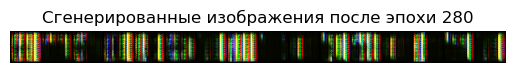

Эпоха [281/400] Шаг [100/322] D Loss: 1.1003, G Loss: 0.5766 D(x): 0.5503, D(G(z)): 0.3939 / 0.5623
Эпоха [281/400] Шаг [200/322] D Loss: 1.5090, G Loss: 1.0112 D(x): 0.3498, D(G(z)): 0.3635 / 0.3649
Эпоха [281/400] Шаг [300/322] D Loss: 1.9477, G Loss: 1.6560 D(x): 0.1723, D(G(z)): 0.1670 / 0.1925


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


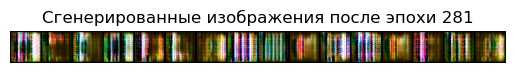

Эпоха [282/400] Шаг [100/322] D Loss: 1.8105, G Loss: 1.5630 D(x): 0.1888, D(G(z)): 0.1291 / 0.2133
Эпоха [282/400] Шаг [200/322] D Loss: 1.1650, G Loss: 0.6694 D(x): 0.5084, D(G(z)): 0.3863 / 0.5122
Эпоха [282/400] Шаг [300/322] D Loss: 0.5729, G Loss: 0.2946 D(x): 0.7388, D(G(z)): 0.2364 / 0.7450


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


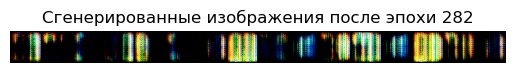

Эпоха [283/400] Шаг [100/322] D Loss: 1.2888, G Loss: 0.7526 D(x): 0.4646, D(G(z)): 0.4019 / 0.4729
Эпоха [283/400] Шаг [200/322] D Loss: 0.7343, G Loss: 0.3103 D(x): 0.7293, D(G(z)): 0.3413 / 0.7336
Эпоха [283/400] Шаг [300/322] D Loss: 1.6298, G Loss: 0.8189 D(x): 0.4361, D(G(z)): 0.5499 / 0.4412


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


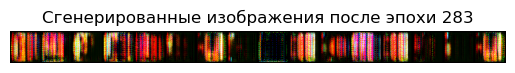

Эпоха [284/400] Шаг [100/322] D Loss: 0.4617, G Loss: 0.3165 D(x): 0.7209, D(G(z)): 0.1256 / 0.7288
Эпоха [284/400] Шаг [200/322] D Loss: 0.6177, G Loss: 0.4710 D(x): 0.6096, D(G(z)): 0.1145 / 0.6248
Эпоха [284/400] Шаг [300/322] D Loss: 0.8371, G Loss: 0.4531 D(x): 0.6246, D(G(z)): 0.3061 / 0.6368


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


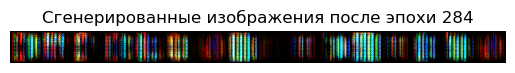

Эпоха [285/400] Шаг [100/322] D Loss: 1.4357, G Loss: 0.2061 D(x): 0.8228, D(G(z)): 0.7099 / 0.8142
Эпоха [285/400] Шаг [200/322] D Loss: 0.5853, G Loss: 0.1793 D(x): 0.8376, D(G(z)): 0.3347 / 0.8361
Эпоха [285/400] Шаг [300/322] D Loss: 1.2233, G Loss: 0.1040 D(x): 0.9102, D(G(z)): 0.6754 / 0.9017


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


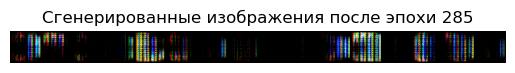

Эпоха [286/400] Шаг [100/322] D Loss: 1.7805, G Loss: 1.0453 D(x): 0.3418, D(G(z)): 0.5050 / 0.3519
Эпоха [286/400] Шаг [200/322] D Loss: 0.5759, G Loss: 0.1928 D(x): 0.8249, D(G(z)): 0.3183 / 0.8247
Эпоха [286/400] Шаг [300/322] D Loss: 0.4517, G Loss: 0.3671 D(x): 0.6832, D(G(z)): 0.0681 / 0.6932


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


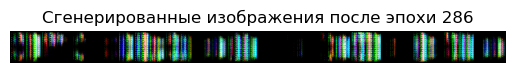

Эпоха [287/400] Шаг [100/322] D Loss: 1.3954, G Loss: 0.7922 D(x): 0.4445, D(G(z)): 0.4405 / 0.4534
Эпоха [287/400] Шаг [200/322] D Loss: 0.8922, G Loss: 0.3593 D(x): 0.6997, D(G(z)): 0.4125 / 0.6983
Эпоха [287/400] Шаг [300/322] D Loss: 1.2376, G Loss: 1.0062 D(x): 0.3399, D(G(z)): 0.1456 / 0.3667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


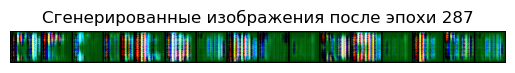

Эпоха [288/400] Шаг [100/322] D Loss: 2.1148, G Loss: 1.8512 D(x): 0.1450, D(G(z)): 0.1667 / 0.1576
Эпоха [288/400] Шаг [200/322] D Loss: 1.6627, G Loss: 1.0585 D(x): 0.3398, D(G(z)): 0.4385 / 0.3476
Эпоха [288/400] Шаг [300/322] D Loss: 0.9950, G Loss: 0.0707 D(x): 0.9368, D(G(z)): 0.6043 / 0.9318


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


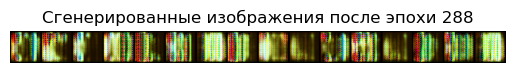

Эпоха [289/400] Шаг [100/322] D Loss: 1.7656, G Loss: 1.3993 D(x): 0.2277, D(G(z)): 0.2454 / 0.2483
Эпоха [289/400] Шаг [200/322] D Loss: 0.6536, G Loss: 0.3087 D(x): 0.7244, D(G(z)): 0.2810 / 0.7345
Эпоха [289/400] Шаг [300/322] D Loss: 0.6315, G Loss: 0.0942 D(x): 0.9130, D(G(z)): 0.4173 / 0.9101


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


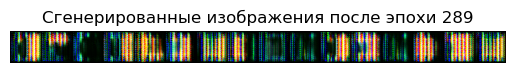

Эпоха [290/400] Шаг [100/322] D Loss: 0.6307, G Loss: 0.2389 D(x): 0.7848, D(G(z)): 0.3200 / 0.7877
Эпоха [290/400] Шаг [200/322] D Loss: 0.8325, G Loss: 0.6686 D(x): 0.5035, D(G(z)): 0.1342 / 0.5127
Эпоха [290/400] Шаг [300/322] D Loss: 0.4248, G Loss: 0.2001 D(x): 0.8150, D(G(z)): 0.1974 / 0.8189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


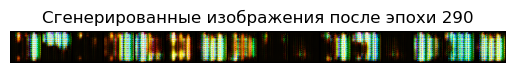

Эпоха [291/400] Шаг [100/322] D Loss: 0.1634, G Loss: 0.1329 D(x): 0.8751, D(G(z)): 0.0295 / 0.8756
Эпоха [291/400] Шаг [200/322] D Loss: 0.6759, G Loss: 0.0589 D(x): 0.9453, D(G(z)): 0.4598 / 0.9429
Эпоха [291/400] Шаг [300/322] D Loss: 1.2551, G Loss: 0.0468 D(x): 0.9576, D(G(z)): 0.7018 / 0.9543


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


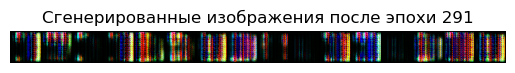

Эпоха [292/400] Шаг [100/322] D Loss: 1.5912, G Loss: 0.6610 D(x): 0.5177, D(G(z)): 0.6062 / 0.5166
Эпоха [292/400] Шаг [200/322] D Loss: 0.9532, G Loss: 0.7211 D(x): 0.4689, D(G(z)): 0.1755 / 0.4867
Эпоха [292/400] Шаг [300/322] D Loss: 2.6342, G Loss: 2.3455 D(x): 0.0861, D(G(z)): 0.1575 / 0.0962


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


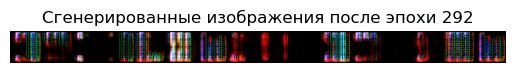

Эпоха [293/400] Шаг [100/322] D Loss: 2.3566, G Loss: 0.8853 D(x): 0.4115, D(G(z)): 0.7689 / 0.4129
Эпоха [293/400] Шаг [200/322] D Loss: 1.5546, G Loss: 0.6426 D(x): 0.5258, D(G(z)): 0.5964 / 0.5260
Эпоха [293/400] Шаг [300/322] D Loss: 1.2689, G Loss: 0.1631 D(x): 0.8582, D(G(z)): 0.6718 / 0.8500


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


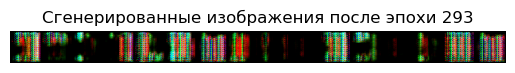

Эпоха [294/400] Шаг [100/322] D Loss: 1.0482, G Loss: 0.2483 D(x): 0.7818, D(G(z)): 0.5501 / 0.7804
Эпоха [294/400] Шаг [200/322] D Loss: 2.2714, G Loss: 1.2538 D(x): 0.2830, D(G(z)): 0.6323 / 0.2864
Эпоха [294/400] Шаг [300/322] D Loss: 0.6826, G Loss: 0.2284 D(x): 0.7952, D(G(z)): 0.3627 / 0.7959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


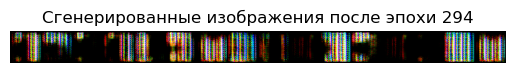

Эпоха [295/400] Шаг [100/322] D Loss: 1.6865, G Loss: 1.1764 D(x): 0.2922, D(G(z)): 0.3652 / 0.3091
Эпоха [295/400] Шаг [200/322] D Loss: 1.0452, G Loss: 0.2413 D(x): 0.7905, D(G(z)): 0.5540 / 0.7857
Эпоха [295/400] Шаг [300/322] D Loss: 1.2791, G Loss: 0.4134 D(x): 0.6643, D(G(z)): 0.5802 / 0.6617


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


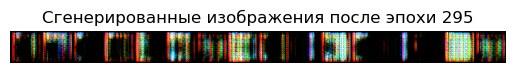

Эпоха [296/400] Шаг [100/322] D Loss: 0.9922, G Loss: 0.4858 D(x): 0.6080, D(G(z)): 0.3893 / 0.6156
Эпоха [296/400] Шаг [200/322] D Loss: 1.1071, G Loss: 0.3600 D(x): 0.7029, D(G(z)): 0.5295 / 0.6977
Эпоха [296/400] Шаг [300/322] D Loss: 0.8036, G Loss: 0.5549 D(x): 0.5724, D(G(z)): 0.2166 / 0.5748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


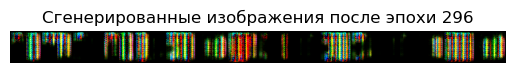

Эпоха [297/400] Шаг [100/322] D Loss: 1.8265, G Loss: 1.0295 D(x): 0.3629, D(G(z)): 0.5536 / 0.3576
Эпоха [297/400] Шаг [200/322] D Loss: 1.4486, G Loss: 1.2311 D(x): 0.2745, D(G(z)): 0.1415 / 0.2924
Эпоха [297/400] Шаг [300/322] D Loss: 1.0492, G Loss: 0.1905 D(x): 0.8357, D(G(z)): 0.5797 / 0.8267


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


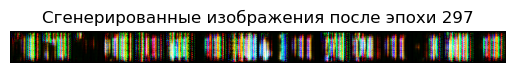

Эпоха [298/400] Шаг [100/322] D Loss: 0.9962, G Loss: 0.2844 D(x): 0.7592, D(G(z)): 0.5132 / 0.7526
Эпоха [298/400] Шаг [200/322] D Loss: 1.0966, G Loss: 0.4979 D(x): 0.5919, D(G(z)): 0.4331 / 0.6089
Эпоха [298/400] Шаг [300/322] D Loss: 0.5021, G Loss: 0.2746 D(x): 0.7534, D(G(z)): 0.1964 / 0.7600


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


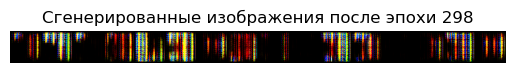

Эпоха [299/400] Шаг [100/322] D Loss: 0.9066, G Loss: 0.1687 D(x): 0.8525, D(G(z)): 0.5255 / 0.8449
Эпоха [299/400] Шаг [200/322] D Loss: 0.7386, G Loss: 0.3700 D(x): 0.6819, D(G(z)): 0.2974 / 0.6913
Эпоха [299/400] Шаг [300/322] D Loss: 0.4621, G Loss: 0.3111 D(x): 0.7322, D(G(z)): 0.1386 / 0.7329


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


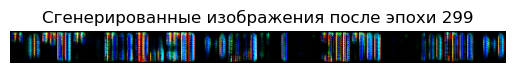

Эпоха [300/400] Шаг [100/322] D Loss: 0.7564, G Loss: 0.2603 D(x): 0.7804, D(G(z)): 0.3965 / 0.7711
Эпоха [300/400] Шаг [200/322] D Loss: 0.9059, G Loss: 0.4862 D(x): 0.6130, D(G(z)): 0.3399 / 0.6152
Эпоха [300/400] Шаг [300/322] D Loss: 1.0861, G Loss: 0.1191 D(x): 0.8963, D(G(z)): 0.6225 / 0.8879


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


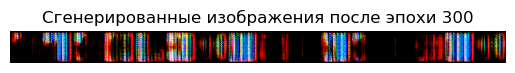

Эпоха [301/400] Шаг [100/322] D Loss: 0.4487, G Loss: 0.2851 D(x): 0.7516, D(G(z)): 0.1497 / 0.7523
Эпоха [301/400] Шаг [200/322] D Loss: 0.5572, G Loss: 0.4527 D(x): 0.6333, D(G(z)): 0.0931 / 0.6366
Эпоха [301/400] Шаг [300/322] D Loss: 0.4690, G Loss: 0.1893 D(x): 0.8300, D(G(z)): 0.2458 / 0.8279


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


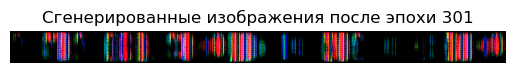

Эпоха [302/400] Шаг [100/322] D Loss: 1.7689, G Loss: 0.7149 D(x): 0.4947, D(G(z)): 0.6546 / 0.4897
Эпоха [302/400] Шаг [200/322] D Loss: 1.2629, G Loss: 0.1261 D(x): 0.8863, D(G(z)): 0.6787 / 0.8816
Эпоха [302/400] Шаг [300/322] D Loss: 0.8894, G Loss: 0.5505 D(x): 0.5663, D(G(z)): 0.2740 / 0.5771


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


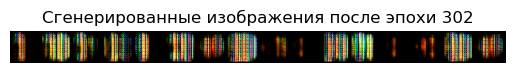

Эпоха [303/400] Шаг [100/322] D Loss: 1.0704, G Loss: 0.3971 D(x): 0.6741, D(G(z)): 0.4911 / 0.6724
Эпоха [303/400] Шаг [200/322] D Loss: 0.9064, G Loss: 0.7126 D(x): 0.4658, D(G(z)): 0.1280 / 0.4926
Эпоха [303/400] Шаг [300/322] D Loss: 1.8437, G Loss: 1.4734 D(x): 0.2188, D(G(z)): 0.2716 / 0.2296


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


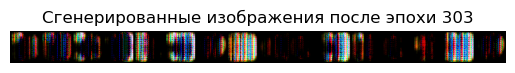

Эпоха [304/400] Шаг [100/322] D Loss: 0.6044, G Loss: 0.1819 D(x): 0.8344, D(G(z)): 0.3449 / 0.8341
Эпоха [304/400] Шаг [200/322] D Loss: 2.2733, G Loss: 1.0469 D(x): 0.3464, D(G(z)): 0.7020 / 0.3520
Эпоха [304/400] Шаг [300/322] D Loss: 0.9680, G Loss: 0.5767 D(x): 0.5534, D(G(z)): 0.3129 / 0.5621


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


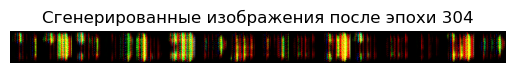

Эпоха [305/400] Шаг [100/322] D Loss: 1.7255, G Loss: 0.7461 D(x): 0.4690, D(G(z)): 0.6185 / 0.4750
Эпоха [305/400] Шаг [200/322] D Loss: 1.2393, G Loss: 0.9970 D(x): 0.3529, D(G(z)): 0.1776 / 0.3711
Эпоха [305/400] Шаг [300/322] D Loss: 0.4142, G Loss: 0.0864 D(x): 0.9196, D(G(z)): 0.2805 / 0.9179


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


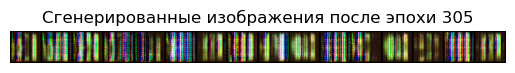

Эпоха [306/400] Шаг [100/322] D Loss: 1.0587, G Loss: 0.3360 D(x): 0.7261, D(G(z)): 0.5219 / 0.7151
Эпоха [306/400] Шаг [200/322] D Loss: 2.1485, G Loss: 0.3164 D(x): 0.7395, D(G(z)): 0.8414 / 0.7291
Эпоха [306/400] Шаг [300/322] D Loss: 0.7174, G Loss: 0.4317 D(x): 0.6493, D(G(z)): 0.2477 / 0.6496


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


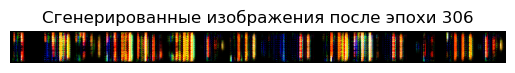

Эпоха [307/400] Шаг [100/322] D Loss: 0.4949, G Loss: 0.1908 D(x): 0.8275, D(G(z)): 0.2629 / 0.8264
Эпоха [307/400] Шаг [200/322] D Loss: 0.9807, G Loss: 0.4675 D(x): 0.6206, D(G(z)): 0.3951 / 0.6267
Эпоха [307/400] Шаг [300/322] D Loss: 1.9549, G Loss: 0.4360 D(x): 0.6594, D(G(z)): 0.7843 / 0.6469


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


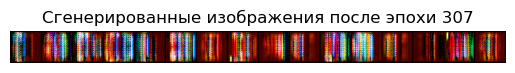

Эпоха [308/400] Шаг [100/322] D Loss: 1.1460, G Loss: 0.4066 D(x): 0.6656, D(G(z)): 0.5215 / 0.6660
Эпоха [308/400] Шаг [200/322] D Loss: 0.4984, G Loss: 0.1783 D(x): 0.8430, D(G(z)): 0.2789 / 0.8368
Эпоха [308/400] Шаг [300/322] D Loss: 0.3899, G Loss: 0.2195 D(x): 0.8030, D(G(z)): 0.1559 / 0.8032


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


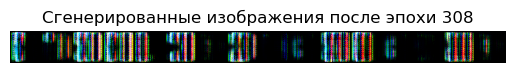

Эпоха [309/400] Шаг [100/322] D Loss: 1.8807, G Loss: 1.1738 D(x): 0.3050, D(G(z)): 0.4967 / 0.3102
Эпоха [309/400] Шаг [200/322] D Loss: 0.4661, G Loss: 0.3917 D(x): 0.6678, D(G(z)): 0.0590 / 0.6764
Эпоха [309/400] Шаг [300/322] D Loss: 0.9289, G Loss: 0.1319 D(x): 0.8850, D(G(z)): 0.5533 / 0.8765


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


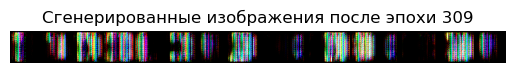

Эпоха [310/400] Шаг [100/322] D Loss: 1.1108, G Loss: 0.7654 D(x): 0.4492, D(G(z)): 0.2615 / 0.4656
Эпоха [310/400] Шаг [200/322] D Loss: 1.5589, G Loss: 1.1761 D(x): 0.2908, D(G(z)): 0.2755 / 0.3088
Эпоха [310/400] Шаг [300/322] D Loss: 0.4397, G Loss: 0.2485 D(x): 0.7741, D(G(z)): 0.1671 / 0.7802


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


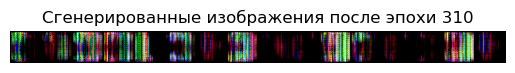

Эпоха [311/400] Шаг [100/322] D Loss: 0.8749, G Loss: 0.7321 D(x): 0.4665, D(G(z)): 0.1050 / 0.4815
Эпоха [311/400] Шаг [200/322] D Loss: 1.9107, G Loss: 1.3687 D(x): 0.2464, D(G(z)): 0.3975 / 0.2548
Эпоха [311/400] Шаг [300/322] D Loss: 2.1120, G Loss: 0.8227 D(x): 0.4361, D(G(z)): 0.7219 / 0.4397


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


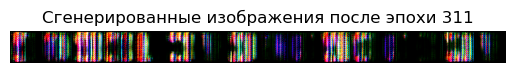

Эпоха [312/400] Шаг [100/322] D Loss: 1.5434, G Loss: 1.3432 D(x): 0.2468, D(G(z)): 0.1293 / 0.2626
Эпоха [312/400] Шаг [200/322] D Loss: 1.5584, G Loss: 0.4684 D(x): 0.6358, D(G(z)): 0.6684 / 0.6261
Эпоха [312/400] Шаг [300/322] D Loss: 1.2866, G Loss: 0.2151 D(x): 0.8134, D(G(z)): 0.6588 / 0.8076


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


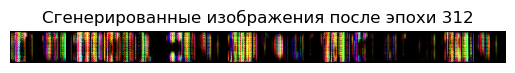

Эпоха [313/400] Шаг [100/322] D Loss: 1.1204, G Loss: 0.7783 D(x): 0.4530, D(G(z)): 0.2786 / 0.4595
Эпоха [313/400] Шаг [200/322] D Loss: 0.6907, G Loss: 0.2290 D(x): 0.7940, D(G(z)): 0.3672 / 0.7955
Эпоха [313/400] Шаг [300/322] D Loss: 0.5359, G Loss: 0.2421 D(x): 0.7778, D(G(z)): 0.2470 / 0.7851


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


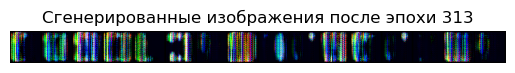

Эпоха [314/400] Шаг [100/322] D Loss: 0.4636, G Loss: 0.2070 D(x): 0.8157, D(G(z)): 0.2287 / 0.8131
Эпоха [314/400] Шаг [200/322] D Loss: 0.7121, G Loss: 0.3396 D(x): 0.7098, D(G(z)): 0.3082 / 0.7123
Эпоха [314/400] Шаг [300/322] D Loss: 1.0968, G Loss: 0.8264 D(x): 0.4240, D(G(z)): 0.2119 / 0.4380


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


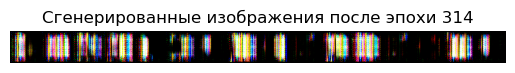

Эпоха [315/400] Шаг [100/322] D Loss: 0.8497, G Loss: 0.5018 D(x): 0.5924, D(G(z)): 0.2774 / 0.6057
Эпоха [315/400] Шаг [200/322] D Loss: 1.6442, G Loss: 1.3787 D(x): 0.2382, D(G(z)): 0.1878 / 0.2542
Эпоха [315/400] Шаг [300/322] D Loss: 0.5486, G Loss: 0.4513 D(x): 0.6237, D(G(z)): 0.0732 / 0.6371


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


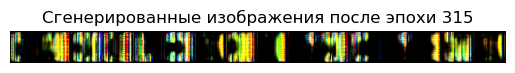

Эпоха [316/400] Шаг [100/322] D Loss: 2.2864, G Loss: 1.0205 D(x): 0.3562, D(G(z)): 0.7135 / 0.3610
Эпоха [316/400] Шаг [200/322] D Loss: 1.1957, G Loss: 0.4558 D(x): 0.6346, D(G(z)): 0.5220 / 0.6341
Эпоха [316/400] Шаг [300/322] D Loss: 1.0029, G Loss: 0.4708 D(x): 0.6184, D(G(z)): 0.4061 / 0.6248


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


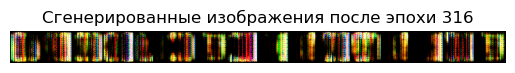

Эпоха [317/400] Шаг [100/322] D Loss: 1.5225, G Loss: 0.5989 D(x): 0.5510, D(G(z)): 0.6034 / 0.5496
Эпоха [317/400] Шаг [200/322] D Loss: 1.0410, G Loss: 0.4383 D(x): 0.6451, D(G(z)): 0.4522 / 0.6454
Эпоха [317/400] Шаг [300/322] D Loss: 0.8822, G Loss: 0.4685 D(x): 0.6271, D(G(z)): 0.3393 / 0.6263


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


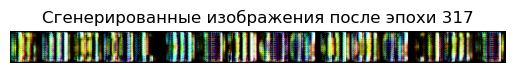

Эпоха [318/400] Шаг [100/322] D Loss: 1.0495, G Loss: 0.5583 D(x): 0.5674, D(G(z)): 0.3815 / 0.5723
Эпоха [318/400] Шаг [200/322] D Loss: 1.9123, G Loss: 0.4039 D(x): 0.6772, D(G(z)): 0.7811 / 0.6680
Эпоха [318/400] Шаг [300/322] D Loss: 0.8471, G Loss: 0.0952 D(x): 0.9119, D(G(z)): 0.5295 / 0.9093


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


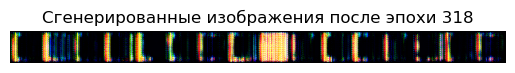

Эпоха [319/400] Шаг [100/322] D Loss: 0.9222, G Loss: 0.3749 D(x): 0.6809, D(G(z)): 0.4146 / 0.6877
Эпоха [319/400] Шаг [200/322] D Loss: 1.0362, G Loss: 0.3381 D(x): 0.7147, D(G(z)): 0.5032 / 0.7135
Эпоха [319/400] Шаг [300/322] D Loss: 0.9774, G Loss: 0.1517 D(x): 0.8602, D(G(z)): 0.5619 / 0.8594


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


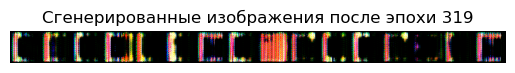

Эпоха [320/400] Шаг [100/322] D Loss: 1.2396, G Loss: 0.5772 D(x): 0.5536, D(G(z)): 0.4763 / 0.5626
Эпоха [320/400] Шаг [200/322] D Loss: 0.5974, G Loss: 0.5052 D(x): 0.5912, D(G(z)): 0.0689 / 0.6036
Эпоха [320/400] Шаг [300/322] D Loss: 1.7732, G Loss: 0.6178 D(x): 0.5435, D(G(z)): 0.6872 / 0.5397


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


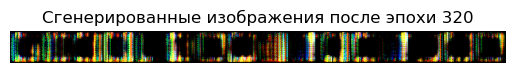

Эпоха [321/400] Шаг [100/322] D Loss: 1.3119, G Loss: 0.8093 D(x): 0.4385, D(G(z)): 0.3854 / 0.4454
Эпоха [321/400] Шаг [200/322] D Loss: 1.3754, G Loss: 0.3141 D(x): 0.7385, D(G(z)): 0.6567 / 0.7307
Эпоха [321/400] Шаг [300/322] D Loss: 2.0016, G Loss: 0.7920 D(x): 0.4565, D(G(z)): 0.7030 / 0.4537


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


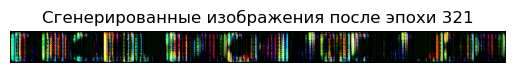

Эпоха [322/400] Шаг [100/322] D Loss: 2.5064, G Loss: 0.4894 D(x): 0.6234, D(G(z)): 0.8686 / 0.6134
Эпоха [322/400] Шаг [200/322] D Loss: 2.0616, G Loss: 0.8351 D(x): 0.3802, D(G(z)): 0.6627 / 0.4358
Эпоха [322/400] Шаг [300/322] D Loss: 0.7138, G Loss: 0.3737 D(x): 0.6864, D(G(z)): 0.2858 / 0.6884


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


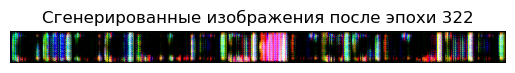

Эпоха [323/400] Шаг [100/322] D Loss: 1.0529, G Loss: 0.6749 D(x): 0.5023, D(G(z)): 0.3027 / 0.5101
Эпоха [323/400] Шаг [200/322] D Loss: 2.1897, G Loss: 0.9556 D(x): 0.3804, D(G(z)): 0.7049 / 0.3847
Эпоха [323/400] Шаг [300/322] D Loss: 0.4623, G Loss: 0.3093 D(x): 0.7298, D(G(z)): 0.1363 / 0.7342


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


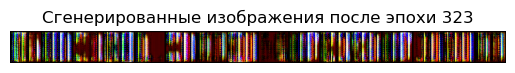

Эпоха [324/400] Шаг [100/322] D Loss: 1.6810, G Loss: 0.0593 D(x): 0.9443, D(G(z)): 0.8007 / 0.9425
Эпоха [324/400] Шаг [200/322] D Loss: 1.2520, G Loss: 0.3330 D(x): 0.7265, D(G(z)): 0.6056 / 0.7170
Эпоха [324/400] Шаг [300/322] D Loss: 0.7822, G Loss: 0.2901 D(x): 0.7536, D(G(z)): 0.3919 / 0.7484


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


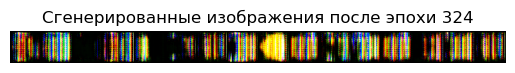

Эпоха [325/400] Шаг [100/322] D Loss: 0.7494, G Loss: 0.4939 D(x): 0.6079, D(G(z)): 0.2222 / 0.6105
Эпоха [325/400] Шаг [200/322] D Loss: 1.7419, G Loss: 0.2356 D(x): 0.8024, D(G(z)): 0.7815 / 0.7904
Эпоха [325/400] Шаг [300/322] D Loss: 0.7922, G Loss: 0.2505 D(x): 0.7787, D(G(z)): 0.4178 / 0.7785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


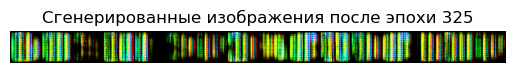

Эпоха [326/400] Шаг [100/322] D Loss: 1.6943, G Loss: 0.7069 D(x): 0.4946, D(G(z)): 0.6247 / 0.4937
Эпоха [326/400] Шаг [200/322] D Loss: 1.7915, G Loss: 1.1439 D(x): 0.3139, D(G(z)): 0.4642 / 0.3189
Эпоха [326/400] Шаг [300/322] D Loss: 0.1775, G Loss: 0.0541 D(x): 0.9470, D(G(z)): 0.1157 / 0.9474


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


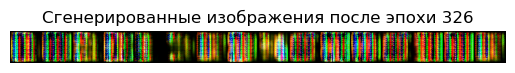

Эпоха [327/400] Шаг [100/322] D Loss: 1.1109, G Loss: 0.5780 D(x): 0.5569, D(G(z)): 0.4079 / 0.5614
Эпоха [327/400] Шаг [200/322] D Loss: 0.6314, G Loss: 0.4790 D(x): 0.6099, D(G(z)): 0.1272 / 0.6196
Эпоха [327/400] Шаг [300/322] D Loss: 1.3634, G Loss: 0.2657 D(x): 0.7808, D(G(z)): 0.6718 / 0.7670


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


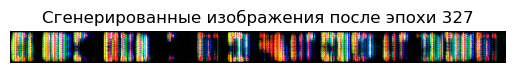

Эпоха [328/400] Шаг [100/322] D Loss: 0.7009, G Loss: 0.1598 D(x): 0.8539, D(G(z)): 0.4186 / 0.8526
Эпоха [328/400] Шаг [200/322] D Loss: 0.7851, G Loss: 0.1921 D(x): 0.8281, D(G(z)): 0.4490 / 0.8253
Эпоха [328/400] Шаг [300/322] D Loss: 1.0035, G Loss: 0.8800 D(x): 0.3904, D(G(z)): 0.0585 / 0.4158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


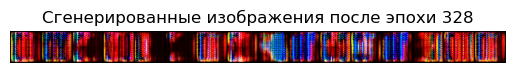

Эпоха [329/400] Шаг [100/322] D Loss: 2.4350, G Loss: 2.0932 D(x): 0.1090, D(G(z)): 0.1933 / 0.1240
Эпоха [329/400] Шаг [200/322] D Loss: 0.7883, G Loss: 0.2830 D(x): 0.7571, D(G(z)): 0.3994 / 0.7537
Эпоха [329/400] Шаг [300/322] D Loss: 1.9206, G Loss: 1.0586 D(x): 0.3437, D(G(z)): 0.5710 / 0.3477


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


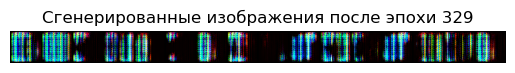

Эпоха [330/400] Шаг [100/322] D Loss: 0.5109, G Loss: 0.1846 D(x): 0.8358, D(G(z)): 0.2819 / 0.8316
Эпоха [330/400] Шаг [200/322] D Loss: 0.2788, G Loss: 0.1746 D(x): 0.8356, D(G(z)): 0.0943 / 0.8399
Эпоха [330/400] Шаг [300/322] D Loss: 0.7459, G Loss: 0.1820 D(x): 0.8357, D(G(z)): 0.4320 / 0.8337


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


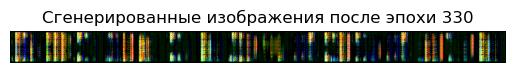

Эпоха [331/400] Шаг [100/322] D Loss: 1.3908, G Loss: 0.0587 D(x): 0.9481, D(G(z)): 0.7370 / 0.9430
Эпоха [331/400] Шаг [200/322] D Loss: 1.0074, G Loss: 0.5965 D(x): 0.5463, D(G(z)): 0.3309 / 0.5510
Эпоха [331/400] Шаг [300/322] D Loss: 1.0456, G Loss: 0.6321 D(x): 0.5063, D(G(z)): 0.3052 / 0.5319


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


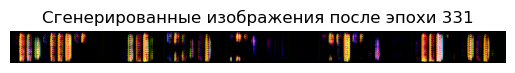

Эпоха [332/400] Шаг [100/322] D Loss: 0.5756, G Loss: 0.3801 D(x): 0.6727, D(G(z)): 0.1631 / 0.6847
Эпоха [332/400] Шаг [200/322] D Loss: 0.4876, G Loss: 0.1677 D(x): 0.8450, D(G(z)): 0.2727 / 0.8457
Эпоха [332/400] Шаг [300/322] D Loss: 0.7888, G Loss: 0.6239 D(x): 0.5175, D(G(z)): 0.1206 / 0.5370


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


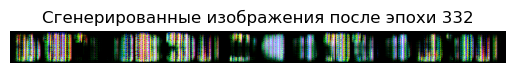

Эпоха [333/400] Шаг [100/322] D Loss: 0.8458, G Loss: 0.2411 D(x): 0.7893, D(G(z)): 0.4555 / 0.7858
Эпоха [333/400] Шаг [200/322] D Loss: 0.8008, G Loss: 0.5435 D(x): 0.5693, D(G(z)): 0.2103 / 0.5810
Эпоха [333/400] Шаг [300/322] D Loss: 1.3900, G Loss: 0.6894 D(x): 0.5053, D(G(z)): 0.5066 / 0.5020


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


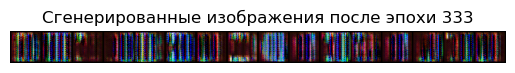

Эпоха [334/400] Шаг [100/322] D Loss: 0.2738, G Loss: 0.1684 D(x): 0.8454, D(G(z)): 0.1002 / 0.8452
Эпоха [334/400] Шаг [200/322] D Loss: 0.6657, G Loss: 0.3467 D(x): 0.7087, D(G(z)): 0.2735 / 0.7081
Эпоха [334/400] Шаг [300/322] D Loss: 0.8796, G Loss: 0.4576 D(x): 0.6333, D(G(z)): 0.3442 / 0.6329


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


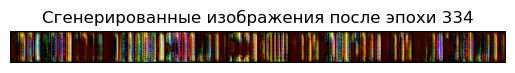

Эпоха [335/400] Шаг [100/322] D Loss: 1.5858, G Loss: 1.3311 D(x): 0.2419, D(G(z)): 0.1522 / 0.2658
Эпоха [335/400] Шаг [200/322] D Loss: 1.2458, G Loss: 0.2653 D(x): 0.7735, D(G(z)): 0.6272 / 0.7673
Эпоха [335/400] Шаг [300/322] D Loss: 0.4611, G Loss: 0.3226 D(x): 0.7136, D(G(z)): 0.1160 / 0.7245


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


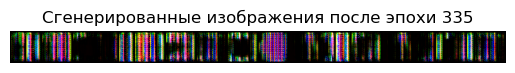

Эпоха [336/400] Шаг [100/322] D Loss: 0.7985, G Loss: 0.5193 D(x): 0.5877, D(G(z)): 0.2328 / 0.5954
Эпоха [336/400] Шаг [200/322] D Loss: 1.0188, G Loss: 0.0348 D(x): 0.9686, D(G(z)): 0.6267 / 0.9658
Эпоха [336/400] Шаг [300/322] D Loss: 0.9460, G Loss: 0.3689 D(x): 0.7002, D(G(z)): 0.4443 / 0.6920


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


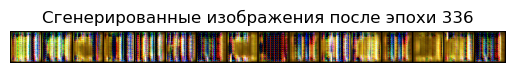

Эпоха [337/400] Шаг [100/322] D Loss: 0.6352, G Loss: 0.4070 D(x): 0.6586, D(G(z)): 0.1953 / 0.6659
Эпоха [337/400] Шаг [200/322] D Loss: 0.6019, G Loss: 0.2658 D(x): 0.7694, D(G(z)): 0.2878 / 0.7668
Эпоха [337/400] Шаг [300/322] D Loss: 0.6444, G Loss: 0.2378 D(x): 0.7839, D(G(z)): 0.3290 / 0.7885


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


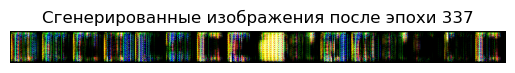

Эпоха [338/400] Шаг [100/322] D Loss: 0.8202, G Loss: 0.3288 D(x): 0.7236, D(G(z)): 0.3912 / 0.7201
Эпоха [338/400] Шаг [200/322] D Loss: 1.9190, G Loss: 0.7847 D(x): 0.4521, D(G(z)): 0.6713 / 0.4577
Эпоха [338/400] Шаг [300/322] D Loss: 0.8960, G Loss: 0.4557 D(x): 0.6353, D(G(z)): 0.3570 / 0.6342


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


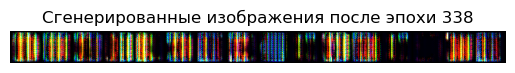

Эпоха [339/400] Шаг [100/322] D Loss: 1.0954, G Loss: 0.1764 D(x): 0.8429, D(G(z)): 0.6027 / 0.8383
Эпоха [339/400] Шаг [200/322] D Loss: 1.6498, G Loss: 1.4338 D(x): 0.2193, D(G(z)): 0.1214 / 0.2408
Эпоха [339/400] Шаг [300/322] D Loss: 0.5333, G Loss: 0.2055 D(x): 0.8144, D(G(z)): 0.2794 / 0.8143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


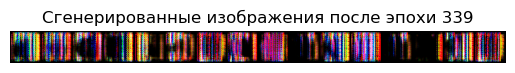

Эпоха [340/400] Шаг [100/322] D Loss: 0.7405, G Loss: 0.3698 D(x): 0.6843, D(G(z)): 0.3027 / 0.6911
Эпоха [340/400] Шаг [200/322] D Loss: 1.2378, G Loss: 0.7254 D(x): 0.4834, D(G(z)): 0.3984 / 0.4845
Эпоха [340/400] Шаг [300/322] D Loss: 0.6508, G Loss: 0.2889 D(x): 0.7472, D(G(z)): 0.3017 / 0.7493


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


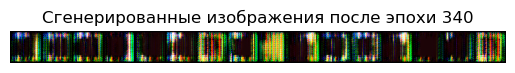

Эпоха [341/400] Шаг [100/322] D Loss: 0.4982, G Loss: 0.1897 D(x): 0.8286, D(G(z)): 0.2659 / 0.8275
Эпоха [341/400] Шаг [200/322] D Loss: 1.7110, G Loss: 1.4099 D(x): 0.2293, D(G(z)): 0.2076 / 0.2460
Эпоха [341/400] Шаг [300/322] D Loss: 1.2644, G Loss: 0.3784 D(x): 0.6910, D(G(z)): 0.5907 / 0.6856


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


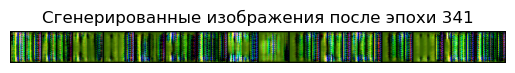

Эпоха [342/400] Шаг [100/322] D Loss: 0.9185, G Loss: 0.5145 D(x): 0.5921, D(G(z)): 0.3251 / 0.5980
Эпоха [342/400] Шаг [200/322] D Loss: 0.8801, G Loss: 0.4002 D(x): 0.6707, D(G(z)): 0.3809 / 0.6704
Эпоха [342/400] Шаг [300/322] D Loss: 3.0248, G Loss: 1.0965 D(x): 0.3401, D(G(z)): 0.8562 / 0.3348


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


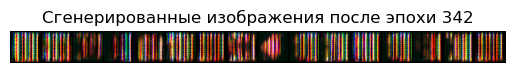

Эпоха [343/400] Шаг [100/322] D Loss: 1.3266, G Loss: 0.9112 D(x): 0.3888, D(G(z)): 0.3166 / 0.4028
Эпоха [343/400] Шаг [200/322] D Loss: 2.2233, G Loss: 1.3081 D(x): 0.2535, D(G(z)): 0.5712 / 0.2724
Эпоха [343/400] Шаг [300/322] D Loss: 0.8108, G Loss: 0.3475 D(x): 0.7038, D(G(z)): 0.3681 / 0.7066


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


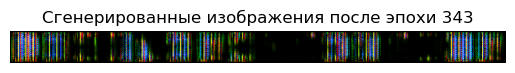

Эпоха [344/400] Шаг [100/322] D Loss: 1.1223, G Loss: 0.9363 D(x): 0.3771, D(G(z)): 0.1350 / 0.3924
Эпоха [344/400] Шаг [200/322] D Loss: 0.6385, G Loss: 0.2675 D(x): 0.7744, D(G(z)): 0.3172 / 0.7658
Эпоха [344/400] Шаг [300/322] D Loss: 0.6684, G Loss: 0.4679 D(x): 0.6238, D(G(z)): 0.1775 / 0.6272


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


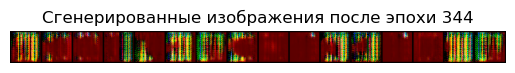

Эпоха [345/400] Шаг [100/322] D Loss: 0.7605, G Loss: 0.3463 D(x): 0.7088, D(G(z)): 0.3400 / 0.7075
Эпоха [345/400] Шаг [200/322] D Loss: 0.6163, G Loss: 0.4403 D(x): 0.6343, D(G(z)): 0.1484 / 0.6443
Эпоха [345/400] Шаг [300/322] D Loss: 0.6924, G Loss: 0.2682 D(x): 0.7689, D(G(z)): 0.3488 / 0.7649


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


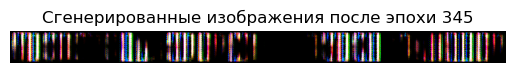

Эпоха [346/400] Шаг [100/322] D Loss: 2.2229, G Loss: 0.1816 D(x): 0.8550, D(G(z)): 0.8716 / 0.8344
Эпоха [346/400] Шаг [200/322] D Loss: 0.6705, G Loss: 0.3656 D(x): 0.6964, D(G(z)): 0.2644 / 0.6941
Эпоха [346/400] Шаг [300/322] D Loss: 1.2785, G Loss: 0.2914 D(x): 0.7533, D(G(z)): 0.6302 / 0.7473


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


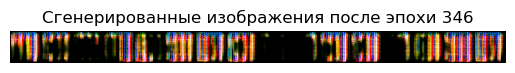

Эпоха [347/400] Шаг [100/322] D Loss: 1.1731, G Loss: 0.5041 D(x): 0.6050, D(G(z)): 0.4884 / 0.6043
Эпоха [347/400] Шаг [200/322] D Loss: 0.8154, G Loss: 0.4882 D(x): 0.6119, D(G(z)): 0.2764 / 0.6141
Эпоха [347/400] Шаг [300/322] D Loss: 2.1432, G Loss: 1.6385 D(x): 0.1835, D(G(z)): 0.3574 / 0.1951


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


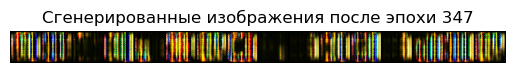

Эпоха [348/400] Шаг [100/322] D Loss: 2.0572, G Loss: 0.3258 D(x): 0.7353, D(G(z)): 0.8258 / 0.7222
Эпоха [348/400] Шаг [200/322] D Loss: 1.3692, G Loss: 0.6891 D(x): 0.4956, D(G(z)): 0.4819 / 0.5023
Эпоха [348/400] Шаг [300/322] D Loss: 0.7330, G Loss: 0.2273 D(x): 0.7987, D(G(z)): 0.3976 / 0.7972


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


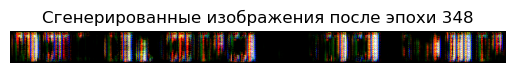

Эпоха [349/400] Шаг [100/322] D Loss: 0.6769, G Loss: 0.0804 D(x): 0.9291, D(G(z)): 0.4520 / 0.9229
Эпоха [349/400] Шаг [200/322] D Loss: 1.2176, G Loss: 0.8409 D(x): 0.4143, D(G(z)): 0.2844 / 0.4321
Эпоха [349/400] Шаг [300/322] D Loss: 1.8876, G Loss: 0.2594 D(x): 0.7911, D(G(z)): 0.8083 / 0.7720


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


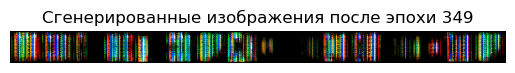

Эпоха [350/400] Шаг [100/322] D Loss: 1.0911, G Loss: 0.2528 D(x): 0.7884, D(G(z)): 0.5736 / 0.7772
Эпоха [350/400] Шаг [200/322] D Loss: 0.4735, G Loss: 0.3263 D(x): 0.7160, D(G(z)): 0.1300 / 0.7217
Эпоха [350/400] Шаг [300/322] D Loss: 1.1220, G Loss: 0.5515 D(x): 0.5721, D(G(z)): 0.4300 / 0.5764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


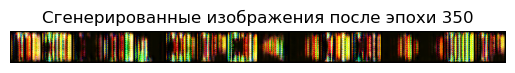

Эпоха [351/400] Шаг [100/322] D Loss: 0.8447, G Loss: 0.2123 D(x): 0.8098, D(G(z)): 0.4692 / 0.8088
Эпоха [351/400] Шаг [200/322] D Loss: 1.4347, G Loss: 1.1360 D(x): 0.3094, D(G(z)): 0.2274 / 0.3216
Эпоха [351/400] Шаг [300/322] D Loss: 1.0885, G Loss: 0.6959 D(x): 0.4960, D(G(z)): 0.3205 / 0.4989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


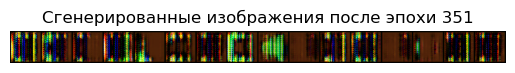

Эпоха [352/400] Шаг [100/322] D Loss: 2.6343, G Loss: 0.9714 D(x): 0.3786, D(G(z)): 0.8098 / 0.3791
Эпоха [352/400] Шаг [200/322] D Loss: 0.4748, G Loss: 0.1624 D(x): 0.8452, D(G(z)): 0.2631 / 0.8502
Эпоха [352/400] Шаг [300/322] D Loss: 0.8060, G Loss: 0.6559 D(x): 0.5094, D(G(z)): 0.1205 / 0.5211


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


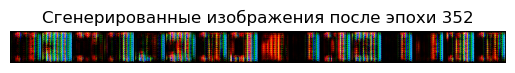

Эпоха [353/400] Шаг [100/322] D Loss: 1.4544, G Loss: 0.4511 D(x): 0.6402, D(G(z)): 0.6348 / 0.6370
Эпоха [353/400] Шаг [200/322] D Loss: 0.4561, G Loss: 0.2540 D(x): 0.7699, D(G(z)): 0.1764 / 0.7759
Эпоха [353/400] Шаг [300/322] D Loss: 2.1182, G Loss: 1.1478 D(x): 0.3144, D(G(z)): 0.6156 / 0.3181


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


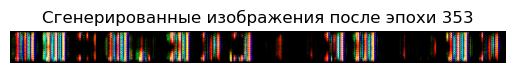

Эпоха [354/400] Шаг [100/322] D Loss: 1.6424, G Loss: 0.6819 D(x): 0.5068, D(G(z)): 0.6155 / 0.5060
Эпоха [354/400] Шаг [200/322] D Loss: 0.8600, G Loss: 0.5990 D(x): 0.5338, D(G(z)): 0.2065 / 0.5500
Эпоха [354/400] Шаг [300/322] D Loss: 1.2913, G Loss: 0.8601 D(x): 0.4184, D(G(z)): 0.3419 / 0.4234


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


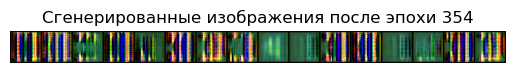

Эпоха [355/400] Шаг [100/322] D Loss: 0.7194, G Loss: 0.3123 D(x): 0.7337, D(G(z)): 0.3358 / 0.7319
Эпоха [355/400] Шаг [200/322] D Loss: 0.4241, G Loss: 0.2509 D(x): 0.7702, D(G(z)): 0.1502 / 0.7782
Эпоха [355/400] Шаг [300/322] D Loss: 0.4774, G Loss: 0.3573 D(x): 0.6937, D(G(z)): 0.1052 / 0.6997


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


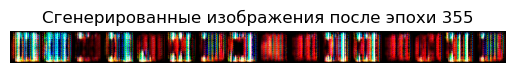

Эпоха [356/400] Шаг [100/322] D Loss: 0.9599, G Loss: 0.3491 D(x): 0.7037, D(G(z)): 0.4513 / 0.7056
Эпоха [356/400] Шаг [200/322] D Loss: 0.3791, G Loss: 0.2712 D(x): 0.7545, D(G(z)): 0.0926 / 0.7626
Эпоха [356/400] Шаг [300/322] D Loss: 0.2887, G Loss: 0.1496 D(x): 0.8607, D(G(z)): 0.1295 / 0.8611


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


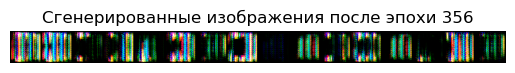

Эпоха [357/400] Шаг [100/322] D Loss: 2.6899, G Loss: 1.4858 D(x): 0.2236, D(G(z)): 0.6952 / 0.2266
Эпоха [357/400] Шаг [200/322] D Loss: 1.0530, G Loss: 0.6436 D(x): 0.5200, D(G(z)): 0.3283 / 0.5258
Эпоха [357/400] Шаг [300/322] D Loss: 3.4681, G Loss: 1.0893 D(x): 0.3330, D(G(z)): 0.9058 / 0.3372


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


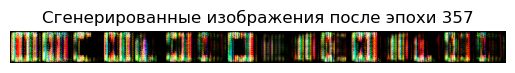

Эпоха [358/400] Шаг [100/322] D Loss: 0.5968, G Loss: 0.3891 D(x): 0.6664, D(G(z)): 0.1737 / 0.6778
Эпоха [358/400] Шаг [200/322] D Loss: 0.9839, G Loss: 0.2246 D(x): 0.8017, D(G(z)): 0.5327 / 0.7989
Эпоха [358/400] Шаг [300/322] D Loss: 1.7421, G Loss: 0.2676 D(x): 0.7803, D(G(z)): 0.7745 / 0.7654


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


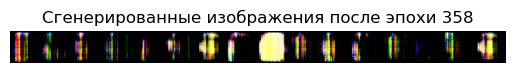

Эпоха [359/400] Шаг [100/322] D Loss: 1.7181, G Loss: 0.4728 D(x): 0.6293, D(G(z)): 0.7136 / 0.6236
Эпоха [359/400] Шаг [200/322] D Loss: 2.6491, G Loss: 0.8505 D(x): 0.4279, D(G(z)): 0.8342 / 0.4277
Эпоха [359/400] Шаг [300/322] D Loss: 1.5550, G Loss: 0.8804 D(x): 0.4057, D(G(z)): 0.4789 / 0.4149


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


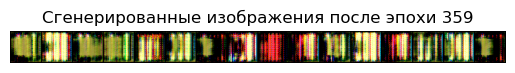

Эпоха [360/400] Шаг [100/322] D Loss: 0.7549, G Loss: 0.6538 D(x): 0.5067, D(G(z)): 0.0719 / 0.5206
Эпоха [360/400] Шаг [200/322] D Loss: 0.2583, G Loss: 0.0755 D(x): 0.9264, D(G(z)): 0.1660 / 0.9275
Эпоха [360/400] Шаг [300/322] D Loss: 0.9110, G Loss: 0.4923 D(x): 0.6081, D(G(z)): 0.3381 / 0.6115


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..1.0].


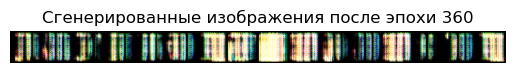

Эпоха [361/400] Шаг [100/322] D Loss: 0.7561, G Loss: 0.2416 D(x): 0.7866, D(G(z)): 0.4013 / 0.7854
Эпоха [361/400] Шаг [200/322] D Loss: 0.6966, G Loss: 0.3202 D(x): 0.7208, D(G(z)): 0.3083 / 0.7261
Эпоха [361/400] Шаг [300/322] D Loss: 2.0471, G Loss: 0.6140 D(x): 0.5512, D(G(z)): 0.7652 / 0.5417


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


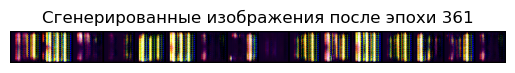

Эпоха [362/400] Шаг [100/322] D Loss: 2.1518, G Loss: 0.4389 D(x): 0.6537, D(G(z)): 0.8215 / 0.6450
Эпоха [362/400] Шаг [200/322] D Loss: 1.3599, G Loss: 0.9515 D(x): 0.3706, D(G(z)): 0.3059 / 0.3871
Эпоха [362/400] Шаг [300/322] D Loss: 0.4155, G Loss: 0.3474 D(x): 0.6990, D(G(z)): 0.0556 / 0.7068


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


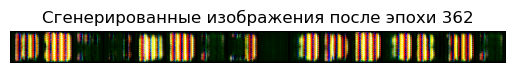

Эпоха [363/400] Шаг [100/322] D Loss: 2.7492, G Loss: 2.3390 D(x): 0.0867, D(G(z)): 0.2597 / 0.0971
Эпоха [363/400] Шаг [200/322] D Loss: 0.6035, G Loss: 0.4763 D(x): 0.6061, D(G(z)): 0.0971 / 0.6215
Эпоха [363/400] Шаг [300/322] D Loss: 1.5216, G Loss: 0.8497 D(x): 0.4178, D(G(z)): 0.4767 / 0.4279


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


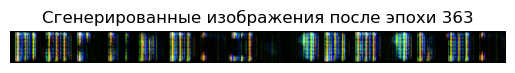

Эпоха [364/400] Шаг [100/322] D Loss: 1.3827, G Loss: 0.1384 D(x): 0.8786, D(G(z)): 0.7141 / 0.8709
Эпоха [364/400] Шаг [200/322] D Loss: 1.2125, G Loss: 0.5958 D(x): 0.5507, D(G(z)): 0.4596 / 0.5513
Эпоха [364/400] Шаг [300/322] D Loss: 1.2816, G Loss: 0.6834 D(x): 0.4944, D(G(z)): 0.4377 / 0.5054


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


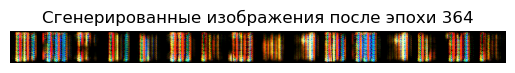

Эпоха [365/400] Шаг [100/322] D Loss: 0.9539, G Loss: 0.3461 D(x): 0.7077, D(G(z)): 0.4545 / 0.7078
Эпоха [365/400] Шаг [200/322] D Loss: 2.1689, G Loss: 1.0724 D(x): 0.3426, D(G(z)): 0.6646 / 0.3429
Эпоха [365/400] Шаг [300/322] D Loss: 1.1769, G Loss: 0.6864 D(x): 0.4810, D(G(z)): 0.3561 / 0.5042


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


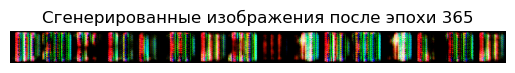

Эпоха [366/400] Шаг [100/322] D Loss: 0.9414, G Loss: 0.5836 D(x): 0.5449, D(G(z)): 0.2836 / 0.5584
Эпоха [366/400] Шаг [200/322] D Loss: 1.0132, G Loss: 0.5893 D(x): 0.5472, D(G(z)): 0.3363 / 0.5548
Эпоха [366/400] Шаг [300/322] D Loss: 1.1224, G Loss: 0.1149 D(x): 0.8960, D(G(z)): 0.6363 / 0.8915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


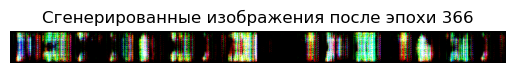

Эпоха [367/400] Шаг [100/322] D Loss: 1.3515, G Loss: 0.5540 D(x): 0.5719, D(G(z)): 0.5468 / 0.5748
Эпоха [367/400] Шаг [200/322] D Loss: 0.4181, G Loss: 0.1475 D(x): 0.8655, D(G(z)): 0.2388 / 0.8630
Эпоха [367/400] Шаг [300/322] D Loss: 1.3151, G Loss: 0.9860 D(x): 0.3571, D(G(z)): 0.2476 / 0.3740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


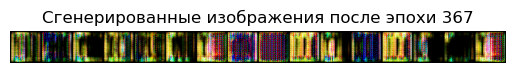

Эпоха [368/400] Шаг [100/322] D Loss: 0.5833, G Loss: 0.3425 D(x): 0.7112, D(G(z)): 0.2148 / 0.7101
Эпоха [368/400] Шаг [200/322] D Loss: 1.5514, G Loss: 1.1164 D(x): 0.3133, D(G(z)): 0.3223 / 0.3281
Эпоха [368/400] Шаг [300/322] D Loss: 0.4327, G Loss: 0.0732 D(x): 0.9307, D(G(z)): 0.3028 / 0.9295


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


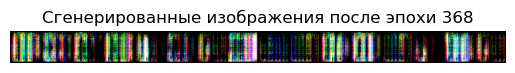

Эпоха [369/400] Шаг [100/322] D Loss: 0.5284, G Loss: 0.3756 D(x): 0.6809, D(G(z)): 0.1330 / 0.6873
Эпоха [369/400] Шаг [200/322] D Loss: 1.6962, G Loss: 0.9436 D(x): 0.3844, D(G(z)): 0.5223 / 0.3897
Эпоха [369/400] Шаг [300/322] D Loss: 1.3023, G Loss: 0.8120 D(x): 0.4434, D(G(z)): 0.3835 / 0.4442


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


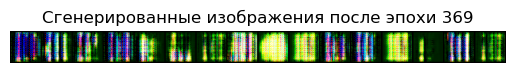

Эпоха [370/400] Шаг [100/322] D Loss: 1.5432, G Loss: 0.6594 D(x): 0.5207, D(G(z)): 0.5876 / 0.5175
Эпоха [370/400] Шаг [200/322] D Loss: 0.8140, G Loss: 0.3641 D(x): 0.6884, D(G(z)): 0.3559 / 0.6950
Эпоха [370/400] Шаг [300/322] D Loss: 0.4282, G Loss: 0.0815 D(x): 0.9234, D(G(z)): 0.2940 / 0.9218


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


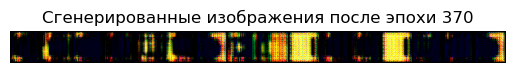

Эпоха [371/400] Шаг [100/322] D Loss: 1.6091, G Loss: 0.9893 D(x): 0.3549, D(G(z)): 0.4353 / 0.3724
Эпоха [371/400] Шаг [200/322] D Loss: 0.6086, G Loss: 0.5564 D(x): 0.5605, D(G(z)): 0.0288 / 0.5737
Эпоха [371/400] Шаг [300/322] D Loss: 0.4928, G Loss: 0.1665 D(x): 0.8412, D(G(z)): 0.2730 / 0.8468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


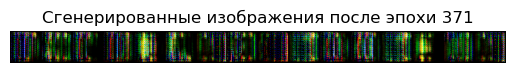

Эпоха [372/400] Шаг [100/322] D Loss: 0.7970, G Loss: 0.2078 D(x): 0.8166, D(G(z)): 0.4477 / 0.8128
Эпоха [372/400] Шаг [200/322] D Loss: 2.2118, G Loss: 0.6055 D(x): 0.5489, D(G(z)): 0.7997 / 0.5461
Эпоха [372/400] Шаг [300/322] D Loss: 1.9001, G Loss: 0.9833 D(x): 0.3743, D(G(z)): 0.6001 / 0.3744


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


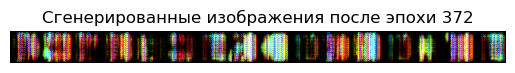

Эпоха [373/400] Шаг [100/322] D Loss: 0.7791, G Loss: 0.3212 D(x): 0.7305, D(G(z)): 0.3713 / 0.7254
Эпоха [373/400] Шаг [200/322] D Loss: 0.8025, G Loss: 0.3492 D(x): 0.7042, D(G(z)): 0.3626 / 0.7055
Эпоха [373/400] Шаг [300/322] D Loss: 0.4961, G Loss: 0.3597 D(x): 0.6900, D(G(z)): 0.1172 / 0.6981


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


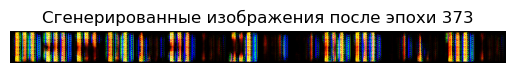

Эпоха [374/400] Шаг [100/322] D Loss: 1.0415, G Loss: 0.6185 D(x): 0.5295, D(G(z)): 0.3326 / 0.5392
Эпоха [374/400] Шаг [200/322] D Loss: 1.0594, G Loss: 0.5566 D(x): 0.5682, D(G(z)): 0.3880 / 0.5736
Эпоха [374/400] Шаг [300/322] D Loss: 1.0521, G Loss: 0.5507 D(x): 0.5738, D(G(z)): 0.3908 / 0.5769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


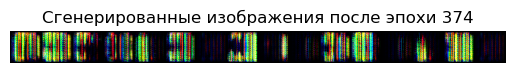

Эпоха [375/400] Шаг [100/322] D Loss: 0.6927, G Loss: 0.4388 D(x): 0.6471, D(G(z)): 0.2263 / 0.6452
Эпоха [375/400] Шаг [200/322] D Loss: 1.1478, G Loss: 0.4082 D(x): 0.6686, D(G(z)): 0.5249 / 0.6650
Эпоха [375/400] Шаг [300/322] D Loss: 2.4512, G Loss: 1.5163 D(x): 0.2126, D(G(z)): 0.5937 / 0.2207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


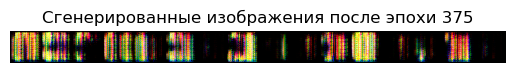

Эпоха [376/400] Шаг [100/322] D Loss: 0.9648, G Loss: 0.3857 D(x): 0.6793, D(G(z)): 0.4388 / 0.6800
Эпоха [376/400] Шаг [200/322] D Loss: 1.2563, G Loss: 0.7691 D(x): 0.4555, D(G(z)): 0.3741 / 0.4638
Эпоха [376/400] Шаг [300/322] D Loss: 0.9198, G Loss: 0.2347 D(x): 0.7942, D(G(z)): 0.4979 / 0.7910


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


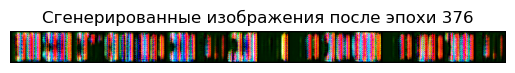

Эпоха [377/400] Шаг [100/322] D Loss: 0.5782, G Loss: 0.1562 D(x): 0.8572, D(G(z)): 0.3453 / 0.8555
Эпоха [377/400] Шаг [200/322] D Loss: 1.2283, G Loss: 0.5153 D(x): 0.6004, D(G(z)): 0.5118 / 0.5976
Эпоха [377/400] Шаг [300/322] D Loss: 1.5566, G Loss: 1.1610 D(x): 0.3005, D(G(z)): 0.2975 / 0.3134


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


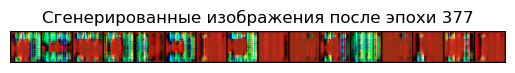

Эпоха [378/400] Шаг [100/322] D Loss: 0.2404, G Loss: 0.1027 D(x): 0.8991, D(G(z)): 0.1253 / 0.9024
Эпоха [378/400] Шаг [200/322] D Loss: 0.3738, G Loss: 0.2222 D(x): 0.7956, D(G(z)): 0.1346 / 0.8010
Эпоха [378/400] Шаг [300/322] D Loss: 4.1472, G Loss: 2.7677 D(x): 0.0589, D(G(z)): 0.7171 / 0.0643


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


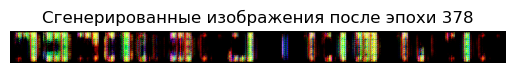

Эпоха [379/400] Шаг [100/322] D Loss: 2.5094, G Loss: 0.6798 D(x): 0.5120, D(G(z)): 0.8405 / 0.5070
Эпоха [379/400] Шаг [200/322] D Loss: 1.0410, G Loss: 0.2824 D(x): 0.7612, D(G(z)): 0.5348 / 0.7545
Эпоха [379/400] Шаг [300/322] D Loss: 0.9523, G Loss: 0.5779 D(x): 0.5607, D(G(z)): 0.3109 / 0.5614


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


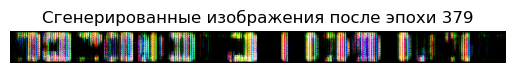

Эпоха [380/400] Шаг [100/322] D Loss: 0.8221, G Loss: 0.0690 D(x): 0.9360, D(G(z)): 0.5300 / 0.9335
Эпоха [380/400] Шаг [200/322] D Loss: 1.1457, G Loss: 0.7833 D(x): 0.4407, D(G(z)): 0.2765 / 0.4581
Эпоха [380/400] Шаг [300/322] D Loss: 1.9619, G Loss: 1.4489 D(x): 0.2223, D(G(z)): 0.3636 / 0.2366


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


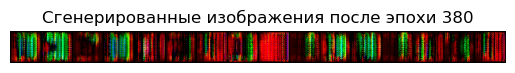

Эпоха [381/400] Шаг [100/322] D Loss: 0.3346, G Loss: 0.1360 D(x): 0.8753, D(G(z)): 0.1818 / 0.8732
Эпоха [381/400] Шаг [200/322] D Loss: 0.4521, G Loss: 0.3089 D(x): 0.7282, D(G(z)): 0.1259 / 0.7344
Эпоха [381/400] Шаг [300/322] D Loss: 1.6710, G Loss: 0.3590 D(x): 0.7006, D(G(z)): 0.7304 / 0.6990


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


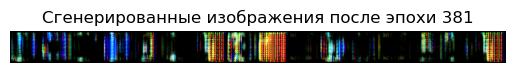

Эпоха [382/400] Шаг [100/322] D Loss: 1.3873, G Loss: 0.8683 D(x): 0.4028, D(G(z)): 0.3794 / 0.4200
Эпоха [382/400] Шаг [200/322] D Loss: 1.2709, G Loss: 0.7219 D(x): 0.4761, D(G(z)): 0.4088 / 0.4861
Эпоха [382/400] Шаг [300/322] D Loss: 0.8306, G Loss: 0.4521 D(x): 0.6267, D(G(z)): 0.3041 / 0.6366


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


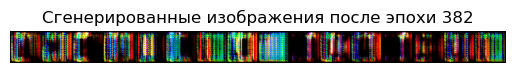

Эпоха [383/400] Шаг [100/322] D Loss: 1.3423, G Loss: 0.5653 D(x): 0.5683, D(G(z)): 0.5396 / 0.5683
Эпоха [383/400] Шаг [200/322] D Loss: 0.8900, G Loss: 0.1296 D(x): 0.8828, D(G(z)): 0.5339 / 0.8785
Эпоха [383/400] Шаг [300/322] D Loss: 1.5387, G Loss: 1.3467 D(x): 0.2453, D(G(z)): 0.1202 / 0.2607


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


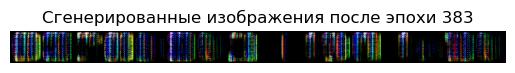

Эпоха [384/400] Шаг [100/322] D Loss: 2.0462, G Loss: 0.2795 D(x): 0.7716, D(G(z)): 0.8321 / 0.7565
Эпоха [384/400] Шаг [200/322] D Loss: 0.5583, G Loss: 0.1980 D(x): 0.8222, D(G(z)): 0.3033 / 0.8210
Эпоха [384/400] Шаг [300/322] D Loss: 0.2605, G Loss: 0.0279 D(x): 0.9721, D(G(z)): 0.2071 / 0.9725


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


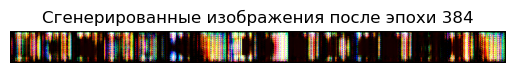

Эпоха [385/400] Шаг [100/322] D Loss: 1.3089, G Loss: 0.3978 D(x): 0.6755, D(G(z)): 0.5976 / 0.6721
Эпоха [385/400] Шаг [200/322] D Loss: 0.5814, G Loss: 0.3402 D(x): 0.7086, D(G(z)): 0.2106 / 0.7117
Эпоха [385/400] Шаг [300/322] D Loss: 1.3607, G Loss: 0.5753 D(x): 0.5635, D(G(z)): 0.5440 / 0.5628


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


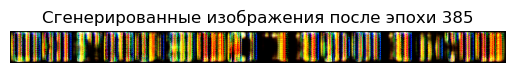

Эпоха [386/400] Шаг [100/322] D Loss: 1.8304, G Loss: 1.4102 D(x): 0.2297, D(G(z)): 0.2983 / 0.2450
Эпоха [386/400] Шаг [200/322] D Loss: 1.2591, G Loss: 0.5771 D(x): 0.5590, D(G(z)): 0.4900 / 0.5622
Эпоха [386/400] Шаг [300/322] D Loss: 0.6898, G Loss: 0.3339 D(x): 0.7143, D(G(z)): 0.2970 / 0.7163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


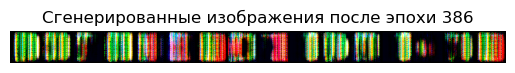

Эпоха [387/400] Шаг [100/322] D Loss: 1.2435, G Loss: 0.6893 D(x): 0.5000, D(G(z)): 0.4224 / 0.5024
Эпоха [387/400] Шаг [200/322] D Loss: 0.7336, G Loss: 0.2200 D(x): 0.7973, D(G(z)): 0.3968 / 0.8027
Эпоха [387/400] Шаг [300/322] D Loss: 1.4240, G Loss: 0.5283 D(x): 0.6002, D(G(z)): 0.5982 / 0.5897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


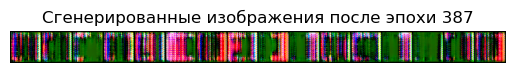

Эпоха [388/400] Шаг [100/322] D Loss: 0.5640, G Loss: 0.4421 D(x): 0.6310, D(G(z)): 0.0979 / 0.6432
Эпоха [388/400] Шаг [200/322] D Loss: 0.4769, G Loss: 0.2215 D(x): 0.8040, D(G(z)): 0.2275 / 0.8017
Эпоха [388/400] Шаг [300/322] D Loss: 2.2288, G Loss: 1.7503 D(x): 0.1631, D(G(z)): 0.3354 / 0.1740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


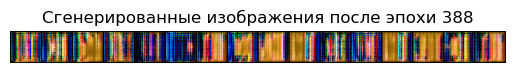

Эпоха [389/400] Шаг [100/322] D Loss: 0.8520, G Loss: 0.4018 D(x): 0.6730, D(G(z)): 0.3653 / 0.6694
Эпоха [389/400] Шаг [200/322] D Loss: 1.6719, G Loss: 0.5544 D(x): 0.5770, D(G(z)): 0.6739 / 0.5746
Эпоха [389/400] Шаг [300/322] D Loss: 0.7373, G Loss: 0.3044 D(x): 0.7348, D(G(z)): 0.3483 / 0.7377


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


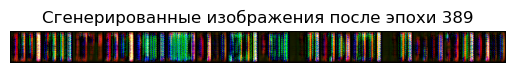

Эпоха [390/400] Шаг [100/322] D Loss: 0.7378, G Loss: 0.3113 D(x): 0.7302, D(G(z)): 0.3450 / 0.7326
Эпоха [390/400] Шаг [200/322] D Loss: 0.9216, G Loss: 0.2921 D(x): 0.7504, D(G(z)): 0.4694 / 0.7468
Эпоха [390/400] Шаг [300/322] D Loss: 0.5588, G Loss: 0.2061 D(x): 0.8152, D(G(z)): 0.2981 / 0.8139


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


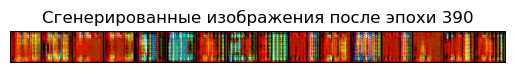

Эпоха [391/400] Шаг [100/322] D Loss: 1.2931, G Loss: 0.3212 D(x): 0.7293, D(G(z)): 0.6235 / 0.7255
Эпоха [391/400] Шаг [200/322] D Loss: 1.4705, G Loss: 0.7203 D(x): 0.4867, D(G(z)): 0.5273 / 0.4867
Эпоха [391/400] Шаг [300/322] D Loss: 1.3337, G Loss: 0.4057 D(x): 0.6654, D(G(z)): 0.6033 / 0.6667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


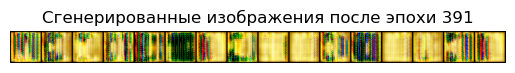

Эпоха [392/400] Шаг [100/322] D Loss: 2.6399, G Loss: 1.7830 D(x): 0.1587, D(G(z)): 0.5491 / 0.1683
Эпоха [392/400] Шаг [200/322] D Loss: 0.5102, G Loss: 0.2985 D(x): 0.7406, D(G(z)): 0.1890 / 0.7421
Эпоха [392/400] Шаг [300/322] D Loss: 0.6972, G Loss: 0.2909 D(x): 0.7461, D(G(z)): 0.3321 / 0.7477


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


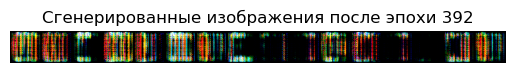

Эпоха [393/400] Шаг [100/322] D Loss: 1.0764, G Loss: 0.3697 D(x): 0.6942, D(G(z)): 0.5084 / 0.6911
Эпоха [393/400] Шаг [200/322] D Loss: 0.6583, G Loss: 0.3244 D(x): 0.7229, D(G(z)): 0.2837 / 0.7232
Эпоха [393/400] Шаг [300/322] D Loss: 1.5550, G Loss: 0.4324 D(x): 0.6582, D(G(z)): 0.6782 / 0.6493


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


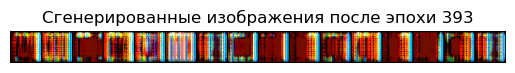

Эпоха [394/400] Шаг [100/322] D Loss: 0.4761, G Loss: 0.3550 D(x): 0.6938, D(G(z)): 0.1040 / 0.7015
Эпоха [394/400] Шаг [200/322] D Loss: 1.1274, G Loss: 0.1453 D(x): 0.8736, D(G(z)): 0.6285 / 0.8650
Эпоха [394/400] Шаг [300/322] D Loss: 1.4531, G Loss: 1.0046 D(x): 0.3546, D(G(z)): 0.3398 / 0.3668


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


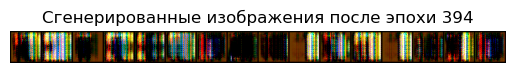

Эпоха [395/400] Шаг [100/322] D Loss: 1.5185, G Loss: 1.1383 D(x): 0.3147, D(G(z)): 0.3015 / 0.3206
Эпоха [395/400] Шаг [200/322] D Loss: 1.5088, G Loss: 0.8704 D(x): 0.4152, D(G(z)): 0.4664 / 0.4189
Эпоха [395/400] Шаг [300/322] D Loss: 1.2862, G Loss: 0.7827 D(x): 0.4517, D(G(z)): 0.3877 / 0.4574


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


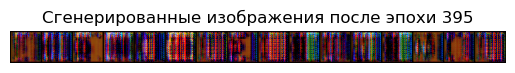

Эпоха [396/400] Шаг [100/322] D Loss: 0.4253, G Loss: 0.1974 D(x): 0.8205, D(G(z)): 0.2032 / 0.8209
Эпоха [396/400] Шаг [200/322] D Loss: 0.5182, G Loss: 0.0764 D(x): 0.9276, D(G(z)): 0.3576 / 0.9264
Эпоха [396/400] Шаг [300/322] D Loss: 1.5171, G Loss: 0.9726 D(x): 0.3653, D(G(z)): 0.3982 / 0.3786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


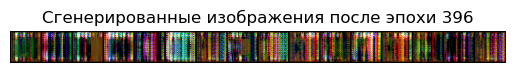

Эпоха [397/400] Шаг [100/322] D Loss: 1.2435, G Loss: 1.0081 D(x): 0.3442, D(G(z)): 0.1615 / 0.3655
Эпоха [397/400] Шаг [200/322] D Loss: 1.4929, G Loss: 0.7129 D(x): 0.4909, D(G(z)): 0.5416 / 0.4905
Эпоха [397/400] Шаг [300/322] D Loss: 0.2868, G Loss: 0.2283 D(x): 0.7897, D(G(z)): 0.0491 / 0.7962


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


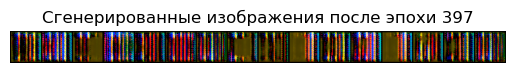

Эпоха [398/400] Шаг [100/322] D Loss: 0.2701, G Loss: 0.1682 D(x): 0.8402, D(G(z)): 0.0913 / 0.8453
Эпоха [398/400] Шаг [200/322] D Loss: 1.3848, G Loss: 0.3095 D(x): 0.7386, D(G(z)): 0.6601 / 0.7340
Эпоха [398/400] Шаг [300/322] D Loss: 1.0898, G Loss: 0.8204 D(x): 0.4209, D(G(z)): 0.1997 / 0.4409


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


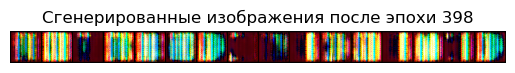

Эпоха [399/400] Шаг [100/322] D Loss: 3.2899, G Loss: 2.2719 D(x): 0.0948, D(G(z)): 0.6030 / 0.1036
Эпоха [399/400] Шаг [200/322] D Loss: 0.2902, G Loss: 0.1943 D(x): 0.8256, D(G(z)): 0.0936 / 0.8235
Эпоха [399/400] Шаг [300/322] D Loss: 0.5351, G Loss: 0.0904 D(x): 0.9137, D(G(z)): 0.3585 / 0.9136


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


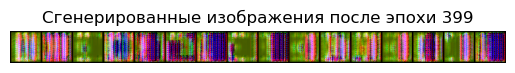

Эпоха [400/400] Шаг [100/322] D Loss: 2.1275, G Loss: 0.3322 D(x): 0.7320, D(G(z)): 0.8362 / 0.7181
Эпоха [400/400] Шаг [200/322] D Loss: 0.5039, G Loss: 0.2840 D(x): 0.7412, D(G(z)): 0.1823 / 0.7538
Эпоха [400/400] Шаг [300/322] D Loss: 0.9782, G Loss: 0.1964 D(x): 0.8219, D(G(z)): 0.5415 / 0.8218


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


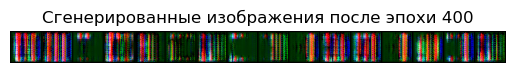

Обучение завершено!
Готово!


In [52]:
train_cgan(generator, discriminator, dataloader, num_epochs, latent_dim, device, fixed_noise, fixed_labels,
           generator_optimizer=generator_optimizer, discriminator_optimizer=discriminator_optimizer,
           log_interval=log_interval)

print("Готово!")

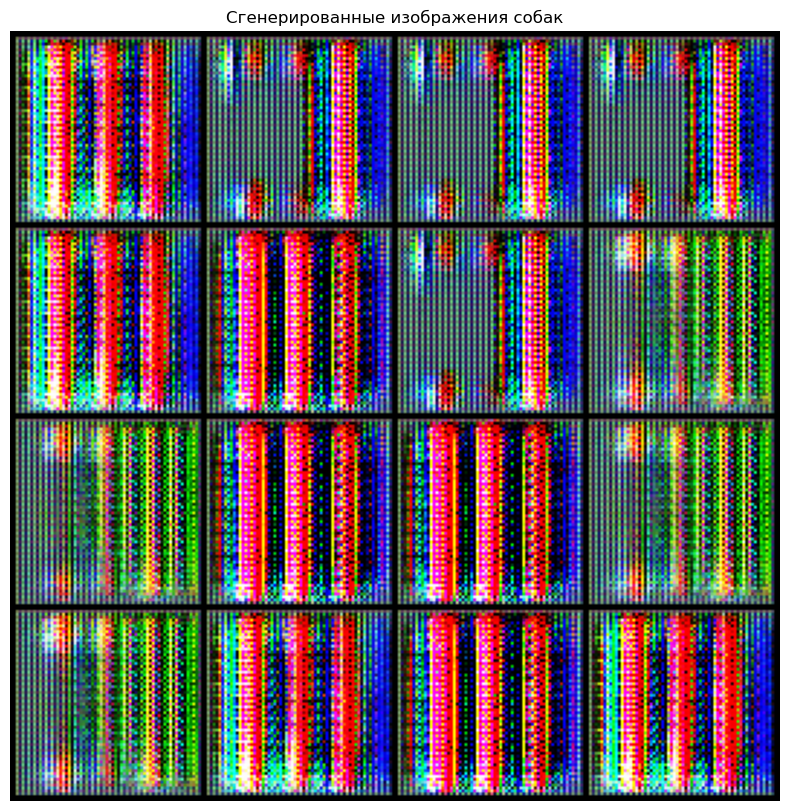

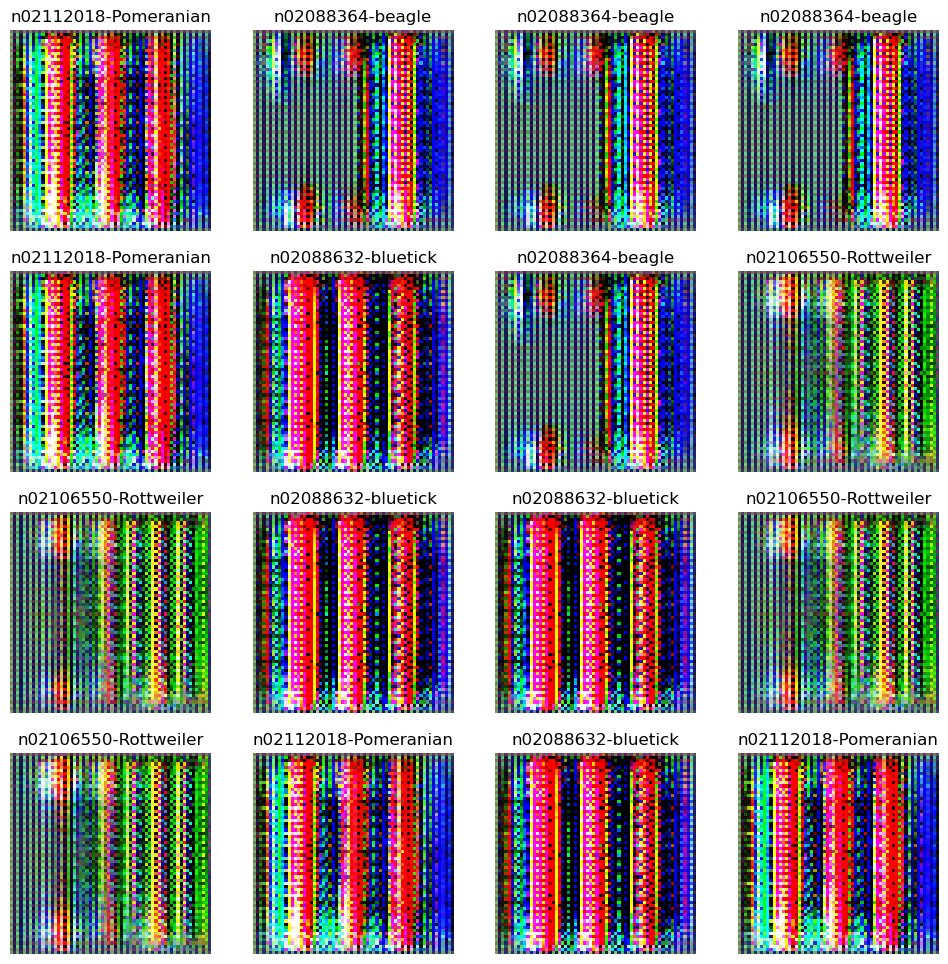

In [54]:
generator.eval() # Переведите генератор в режим оценки
generator.to(device)

# Количество изображений для генерации
num_samples = 16

# Генерация случайного шума
fixed_noise = torch.randn(num_samples, latent_dim, 1, 1, device=device)

# Метки пород для генерации (выберите несколько разных пород)
# Вам нужно будет сопоставить числовые индексы с названиями пород
label_to_breed = dataset.label_to_breed # Предполагается, что у вас есть это отображение
selected_breeds = ['n02088364-beagle', 'n02088632-bluetick', 'n02106550-Rottweiler', 'n02112018-Pomeranian'] # Пример пород
selected_labels = torch.tensor([dataset.breed_to_label[breed] for breed in selected_breeds] * (num_samples // len(selected_breeds)), dtype=torch.long, device=device)
if len(selected_labels) < num_samples:
    # Дополните случайными метками, если количество выбранных пород меньше num_samples
    remaining = num_samples - len(selected_labels)
    random_labels = torch.randint(0, num_classes, (remaining,), device=device)
    selected_labels = torch.cat((selected_labels, random_labels), dim=0)
selected_labels = selected_labels[torch.randperm(selected_labels.size(0))] # Перемешать метки

# Сгенерируйте изображения
with torch.no_grad():
    fake_images = generator(fixed_noise, selected_labels).detach().cpu()

# Визуализация сгенерированных изображений
grid = make_grid(fake_images, nrow=4, normalize=True)
plt.figure(figsize=(10, 10))
plt.imshow(grid.permute(1, 2, 0))
plt.title("Сгенерированные изображения собак")
plt.axis('off')
plt.show()

# Вывод меток под изображениями (опционально)
fig = plt.figure(figsize=(12, 12))
for i in range(num_samples):
    ax = fig.add_subplot(4, 4, i + 1)
    plt.imshow(fake_images[i].permute(1, 2, 0).numpy() * 0.5 + 0.5) # Денормализация
    ax.set_title(label_to_breed[selected_labels[i].item()])
    plt.axis('off')
plt.show()